In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# imports
import pystac_client
import xarray as xr
import matplotlib.pyplot as plt
import pathlib
import os
import numpy as np
import geopandas as gpd
import matplotlib as mpl
from matplotlib import colors
import rasterio

import cartopy.crs as ccrs
import cartopy
import plotly.graph_objects as go
import plotly.express as px
from rasterio.plot import show

import matplotlib.colors as mcolors
from shapely.geometry import Point
import pandas as pd

from tqdm import tqdm

import webbrowser
from pathlib import Path
import os
import time

In [7]:
groundtruth=pd.read_csv(r"P:\11209197-018-global-coastal-atlas\MSc_students\ClenmarRowe\Data\Processed_data_CVI_components\Caribbean Thesis_Results\Validation\Expert_Feedback_collated.csv",sep=";")
jenkspy_pd=pd.read_csv(r"P:\11209197-018-global-coastal-atlas\MSc_students\ClenmarRowe\Data\Processed_data_CVI_components\Caribbean Thesis_Results\Validation\merged_jenkspy_risk_class.csv")
kmeans_pd=pd.read_csv(r"P:\11209197-018-global-coastal-atlas\MSc_students\ClenmarRowe\Data\Processed_data_CVI_components\Caribbean Thesis_Results\Validation\merged_kmeans_risk_class.csv")
percentile_pd=pd.read_csv(r"P:\11209197-018-global-coastal-atlas\MSc_students\ClenmarRowe\Data\Processed_data_CVI_components\Caribbean Thesis_Results\Validation\merged_percentile_risk_class.csv")

In [8]:
percentile_pd.head(2)

,geometry,transect_id,country_id,continent,country_name,Percentage of Built Up Area_percentile - Exposure level_percentile,LECZ Area÷LECZ mean elevation_percentile - Exposure level_percentile,Neashore Slope (tanβ or m^-1)_percentile - Exposure level_percentile,Population Within 1km of the coastline_percentile - Exposure level_percentile,Sediment Type_percentile - Exposure level_percentile,ESL_100yrRP_percentile - Hazard level_percentile,EWH_100yrRP_percentile - Hazard level_percentile,Land_Subsidence_2010_percentile - Hazard level,Shoreline_Change_Rate_PC_percentile - Hazard level_percentile,Cat3_Hurricane_Return_Period_PC_percentile - Hazard level_percentile,Infant Mortality Rate (3_yr_Average)_Percentile - Vulnerability level_percentile,GDP per Capita (3_yr_Average)_Percentile - Vulnerability level_percentile,Mean Years of Schooling_Percentile - Vulnerability level_percentile,Deaths from Recent Shocks (2004-2023)_Percentile - Vulnerability level_percentile,World Protected Areas (Status and Governance)_Percentile - Vulnerability level_percentile
0,POINT (-78.1410816378 24.9979008896),BOX_138_369_157,BHS,North America,The Bahamas,2,5,1.0,2,5.0,3,2,2.0,5.0,2,4.0,2,2.0,3,1
1,POINT (-77.5501341228 24.1018946033),BOX_138_355_254,BHS,North America,The Bahamas,5,1,1.0,5,4.0,1,2,2.0,1.0,2,4.0,1,1.0,4,1


In [9]:
groundtruth

,Country,Beach Name,lon,lat,built-up percentage (1- 5),Topography (1- 5),Bathymetry Slope (1- 5),Population (1- 5),Sediment Type (1- 5),Extreme Sea levels (1- 5),...,HealthCare (1- 5),Economics (1- 5),Literacy (1- 5),Recent Disaster shocks (1- 5),Nearby Sensitive Areas (1- 5),Extreme Sea level Risk (1- 5),Risk from Extreme offshore Wave heights caused by large-scale atmospheric conditions (1- 5),Shoreline Erosion Risk (1- 5),Land Subsidence Risk (1- 5),Hurricane Risk (Frequency & Strength) (1- 5)
0,Bahamas,Lowe Sound,"-78,08","25,15",4,5,4,3,4,5,...,3,3,3,3,2,5,4,3,3,4
1,Bahamas,Regatta,"-77,55","24,1",3,3,4,3,4,3,...,3,3,3,3,2,5,4,4,3,4
2,Turks and Caicos Islands,North Grace Bay,"-72,17","21,81",4,4,4,4,4,4,...,3,2,3,4,3,4,4,4,3,4
3,Barbados,Paynes Bay,"-59,64","13,17",5,5,4,5,4,5,...,3,4,3,2,1,4,4,4,2,3
4,Barbados,Hangmans Bay,"-59,65","13,28",4,5,4,4,4,5,...,3,3,3,1,1,4,4,4,2,3
5,Barbados,Kitridge Bay,"-59,42","13,15",2,3,4,2,4,5,...,3,2,3,2,1,4,4,3,2,4
6,Barbados,Foul Bay,"-59,45","13,09",4,5,4,3,4,5,...,3,2,3,2,1,4,4,3,2,4
7,Barbados,Carlisle Bay,"-59,61","13,09",5,5,4,5,4,4,...,3,4,3,2,1,4,4,3,2,4
8,Turks and Caicos,Grace Bay,"-72,26","21,79",3,2,2,2,3,2,...,2,2,2,3,2,2,2,2,3,3
9,Turks and Caicos,Long Bay,"-72,16","21,78",3,2,1,2,3,3,...,2,2,2,3,2,3,3,3,3,3


In [10]:


class TaylorDiagram:
    def __init__(self, refstd, fig=None, rect=111, label='_', srange=(0, 4)):
        self.refstd = refstd

        if fig is None:
            fig = plt.figure()

        self.ax = fig.add_subplot(rect, polar=True)

            # Set the theta limit to create a semicircle
        self.ax.set_thetamin(0)
        self.ax.set_thetamax(180)


        # Customize ticks
        self.ax.set_ylim(0, srange[1])
        self.ax.set_yticks(np.linspace(0, srange[1], num=5))  # Updated to match number of labels
        self.ax.set_yticklabels(np.linspace(0, srange[1], num=5))  # Adjusted to match number of ticks
        for label in self.ax.get_yticklabels():
            label.set_color('brown')


        self.ax.set_xticks(np.arccos([1, 0.75, 0.25, -0.25, -0.75, -1]))
        self.ax.set_xticklabels([1, 0.75, 0.25, -0.25, -0.75, -1])
        for label in self.ax.get_xticklabels():
            label.set_color('magenta')



        self.samplePoints = []

    def add_sample(self, stddev, corrcoef, *args, **kwargs):
        t = np.arccos(corrcoef)
        r = stddev / self.refstd
        l, = self.ax.plot(t, r, *args, **kwargs)
        self.samplePoints.append(l)
        return l

    def add_contours(self, levels=5, **kwargs):
        rs, ts = np.meshgrid(np.linspace(0, 4), np.linspace(0, np.pi))
        rms = np.sqrt(self.refstd**2 + rs**2 - 2 * self.refstd * rs * np.cos(ts))
        contours = self.ax.contour(ts, rs, rms, levels, **kwargs)
        return contours


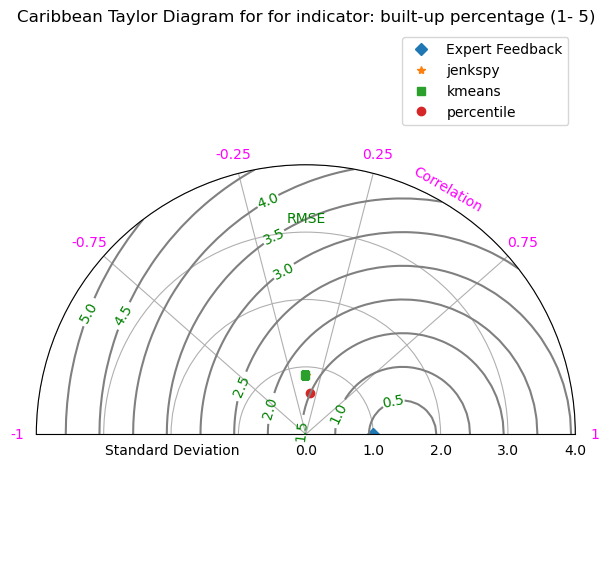

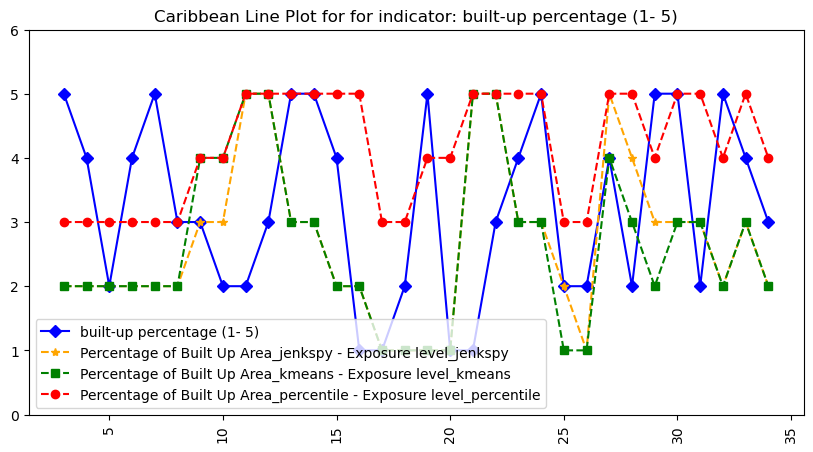

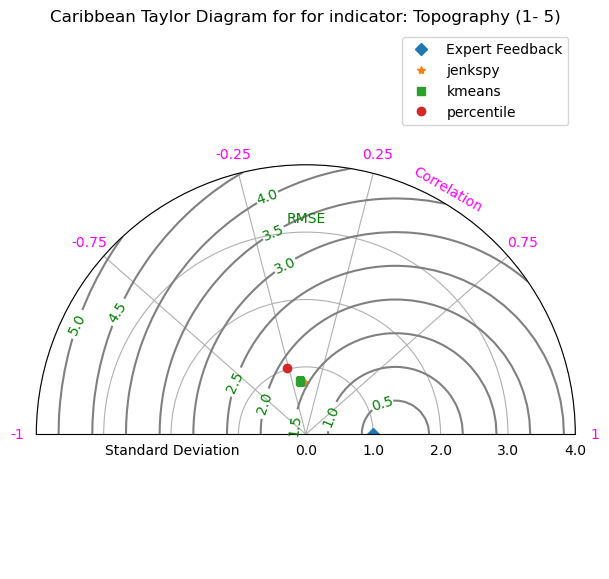

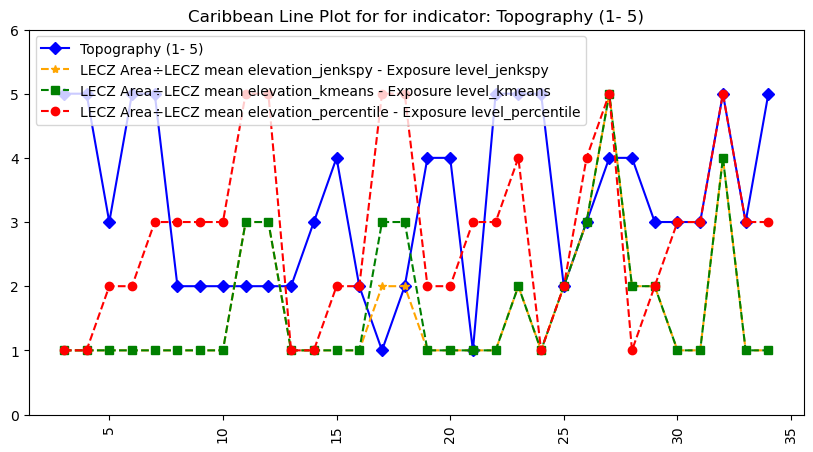

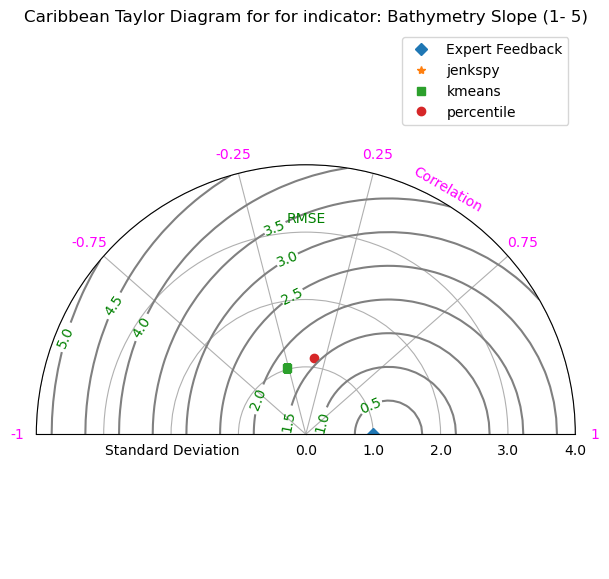

...

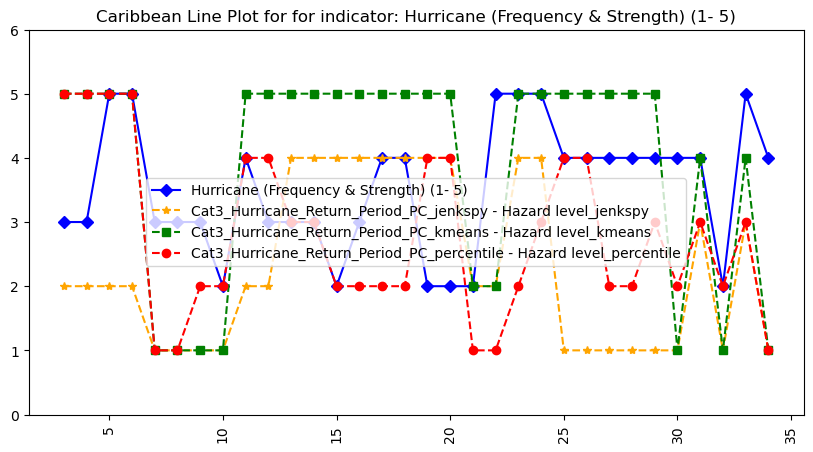

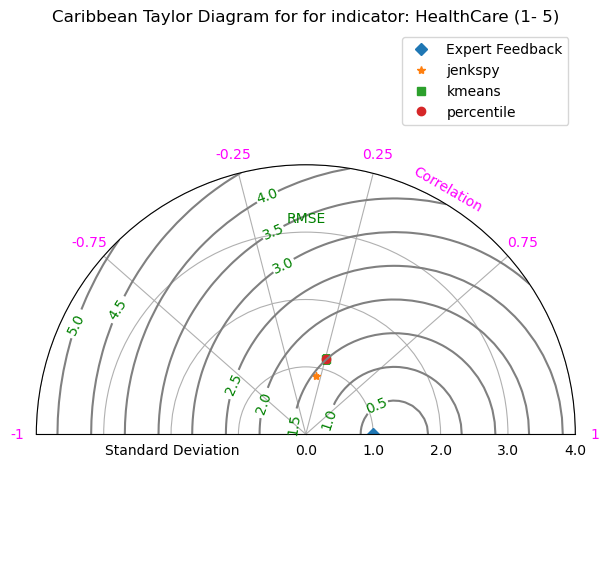

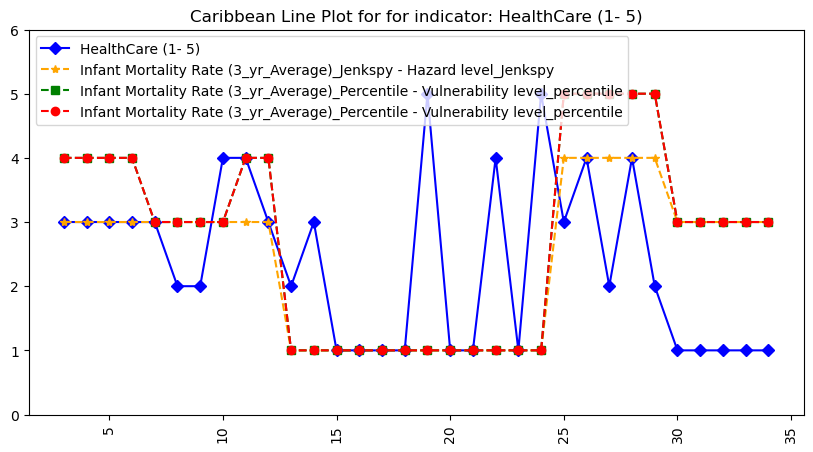

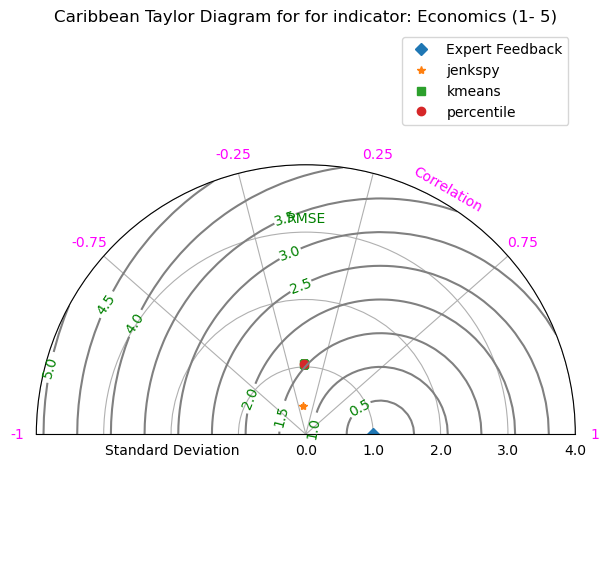

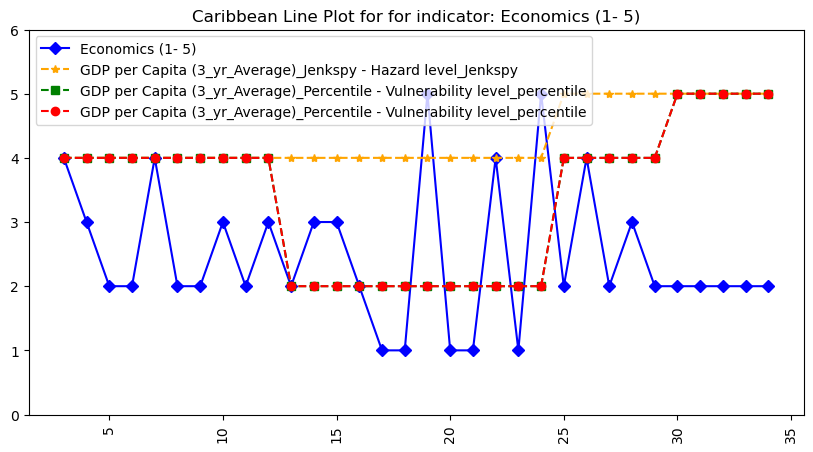

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


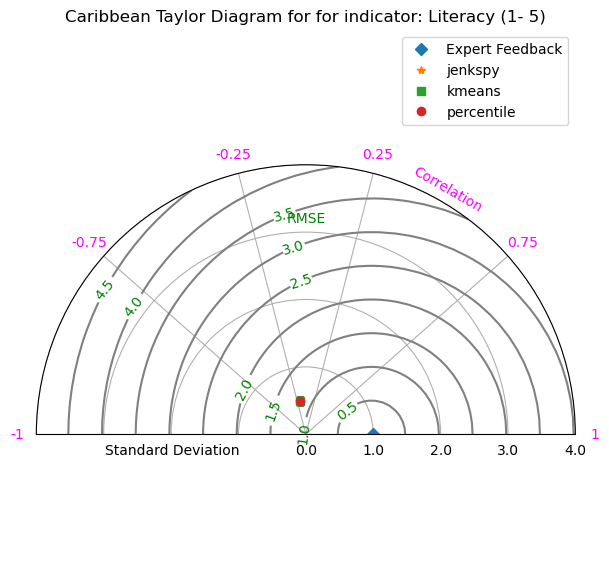

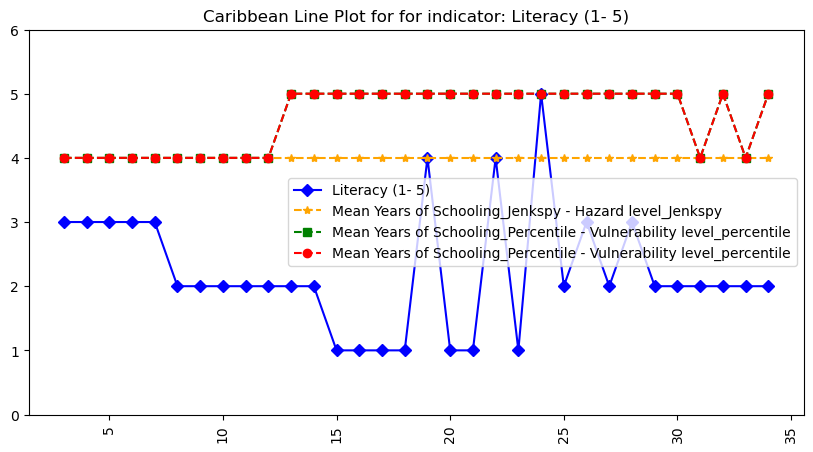

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


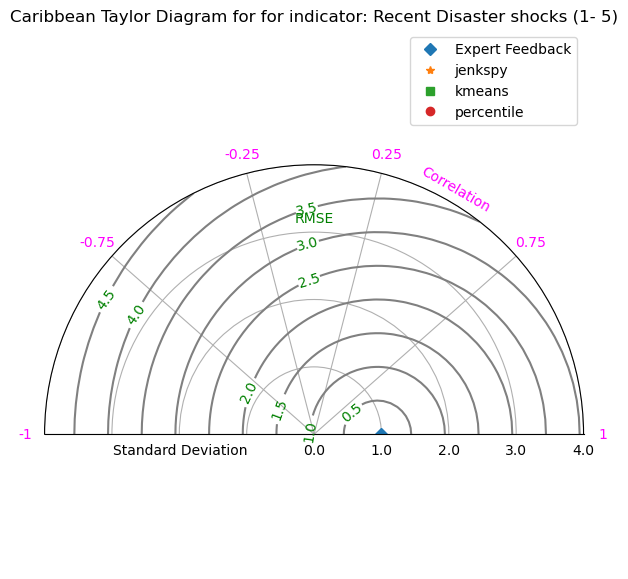

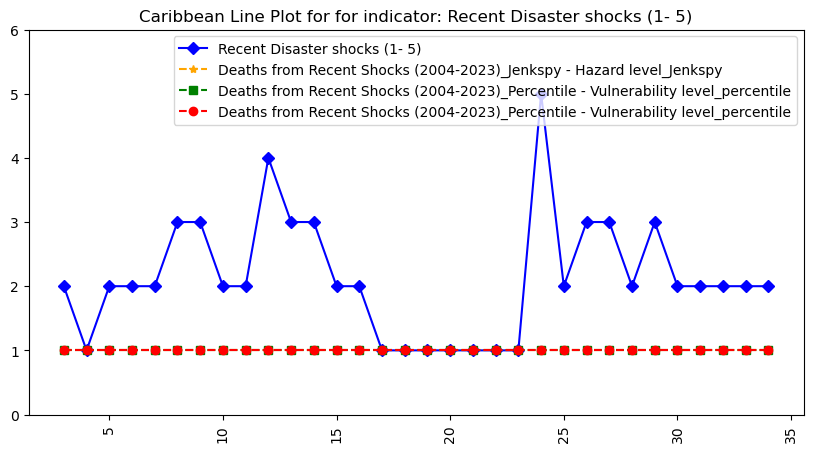

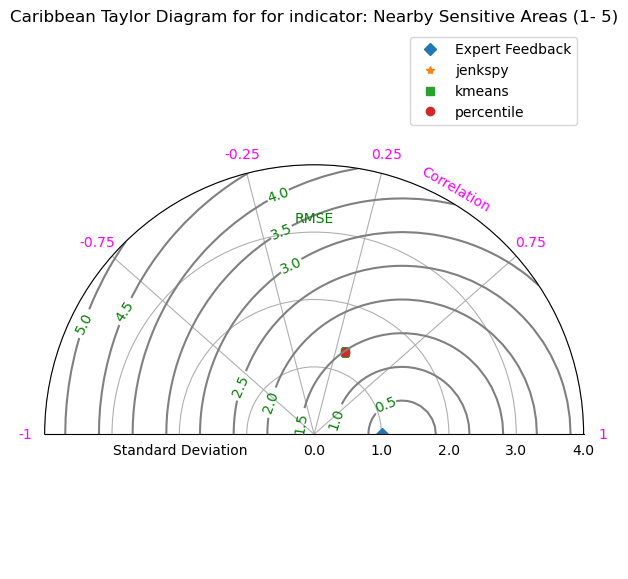

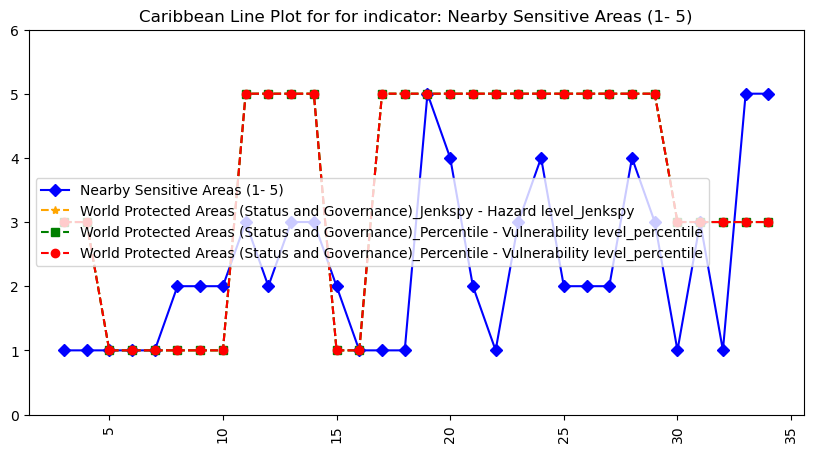

In [11]:
beg=3
end=35


for col in range(0,15):

    # Data
    observed = groundtruth.iloc[:,col+4].values[beg:end]
    jenkspy = jenkspy_pd.iloc[:,col+5].values[beg:end]
    kmeans = kmeans_pd.iloc[:,col+5].values[beg:end]
    percentile = percentile_pd.iloc[:,col+5].values[beg:end]


    models = [observed,jenkspy, kmeans, percentile]
    model_names = ["Expert Feedback",'jenkspy', 'kmeans', 'percentile']

    # Standard deviation of the observed data
    std_observed = np.std(observed, ddof=1)

    # Calculate standard deviations and correlations for each model
    stddevs = [np.std(model, ddof=1) for model in models]
    correlations = [np.corrcoef(observed, model)[0, 1] for model in models]

    # Taylor Diagram
    fig = plt.figure(figsize=(10, 7))
    dia = TaylorDiagram(std_observed, fig=fig, rect=111, label='Observed')

    # Add models to Taylor diagram
    for i, (stddev, corr, name) in enumerate(zip(stddevs, correlations, model_names)):
        if i==0:
            dia.add_sample(stddev, corr, marker='D', ls='', label=name)
        elif i==1:
            dia.add_sample(stddev, corr, marker='*', ls='', label=name)
        elif i==2:
            dia.add_sample(stddev, corr, marker='s', ls='', label=name)
        elif i==3:
            dia.add_sample(stddev, corr, marker='o', ls='', label=name)

    # Add labels
    dia.ax.text(np.pi/2, 3.2, 'RMSE', ha='center', va='center',color="green")
    # dia.ax.text(np.pi/2, 1.7, 'Standard Deviation', ha='center', va='center')
    dia.ax.text(np.pi+np.pi/25, 2, 'Standard Deviation', ha='center', va='center')
    dia.ax.text(np.pi/3, 4.2, 'Correlation', ha='center', va='center',color="magenta",rotation=-30)

    # Add a legend
    contours = dia.add_contours(levels=10, colors='0.5')
    plt.clabel(contours, inline=2, fontsize=10,colors="green")

    plt.legend(loc='upper right')
    title_=f'Caribbean Taylor Diagram for for indicator: {groundtruth.columns[col+4]}'
    plt.title(title_)
    

    fig_name=title_+".png"
    directory=r"P:\11209197-018-global-coastal-atlas\MSc_students\ClenmarRowe\Data\Processed_data_CVI_components\Caribbean Thesis_Results\Validation\Taylor plots"
    plt.savefig(os.path.join(directory,fig_name.replace(":","")),dpi=300, bbox_inches='tight')

    plt.show()




    # plotline plots
    plt.figure(figsize=(10, 5))
    # plt.plot((groundtruth.iloc[:,0].values[beg:end]+"_"+groundtruth.iloc[:,1].values[beg:end]),observed,"D-",color="blue")
    # plt.plot(list(groundtruth.iloc[:,0].values[beg:end]+"_"+groundtruth.iloc[:,1].values[beg:end]),jenkspy,"*--",color="orange")
    # plt.plot(list(groundtruth.iloc[:,0].values[beg:end]+"_"+groundtruth.iloc[:,1].values[beg:end]),kmeans,"s--",color="green")
    # plt.plot(list(groundtruth.iloc[:,0].values[beg:end]+"_"+groundtruth.iloc[:,1].values[beg:end]),percentile, "o--",color="red")

    plt.plot(groundtruth.index[beg:end],observed,"D-",color="blue")
    plt.plot(groundtruth.index[beg:end],jenkspy,"*--",color="orange")
    plt.plot(groundtruth.index[beg:end],kmeans,"s--",color="green")
    plt.plot(groundtruth.index[beg:end],percentile, "o--",color="red")


    # plt.plot(groundtruth.iloc[:,1].values[beg:end],percentile, "o--",color="red")

    plt.legend([groundtruth.columns[col+4],jenkspy_pd.columns[col+5],kmeans_pd.columns[col+5],percentile_pd.columns[col+5]])
    plt.xticks(rotation=90)
    plt.ylim(0,6)
    plt.title(title_.replace("Taylor Diagram","Line Plot"))
    plt.savefig(os.path.join(directory,fig_name.replace(":","").replace("Taylor Diagram","Line Plot")),dpi=300, bbox_inches='tight')

    plt.show()


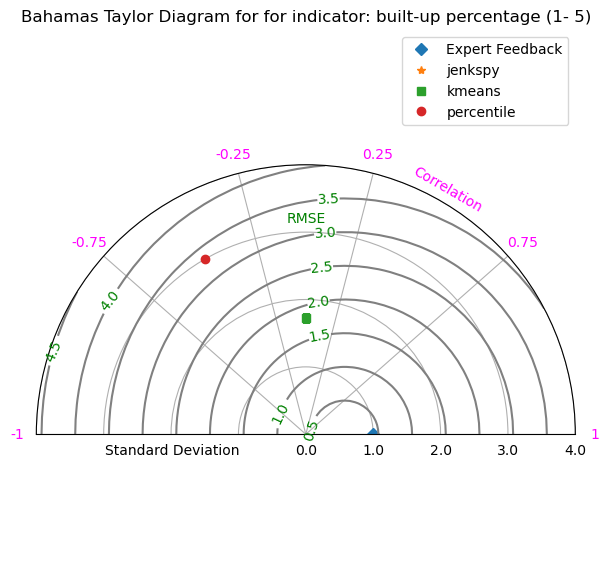

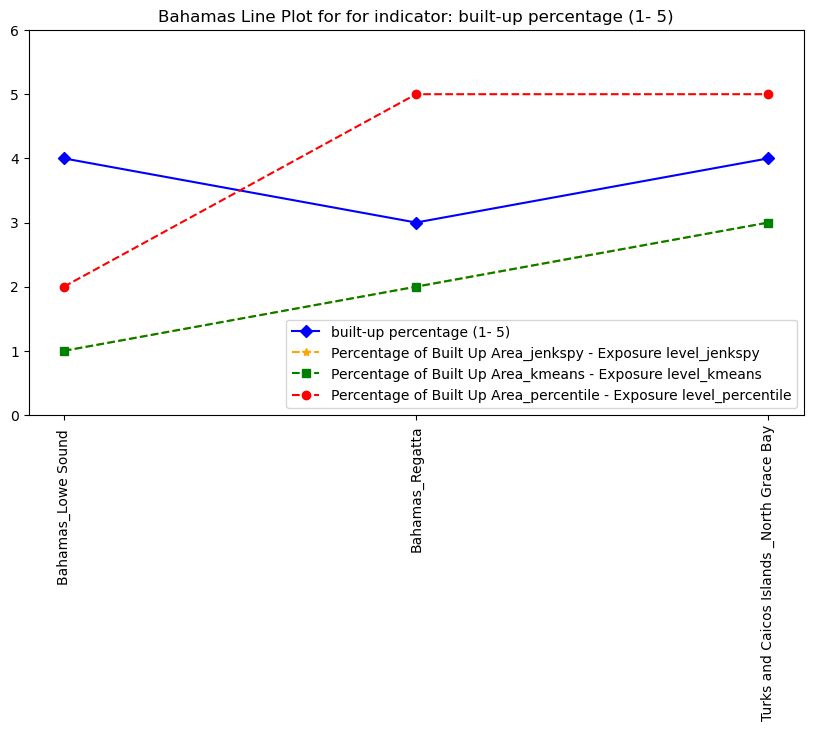

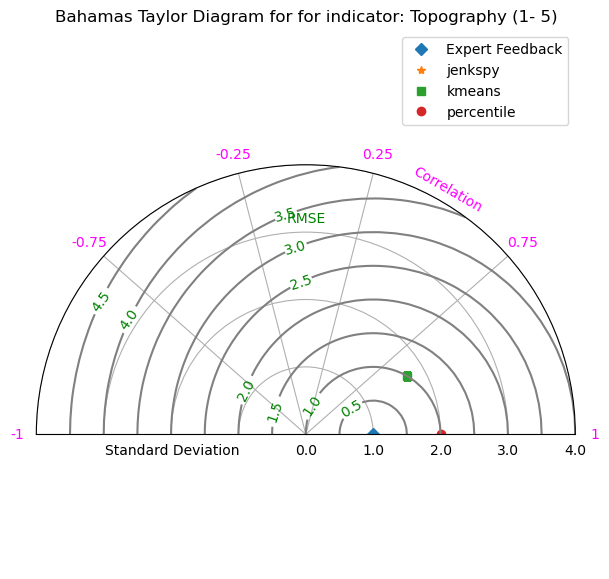

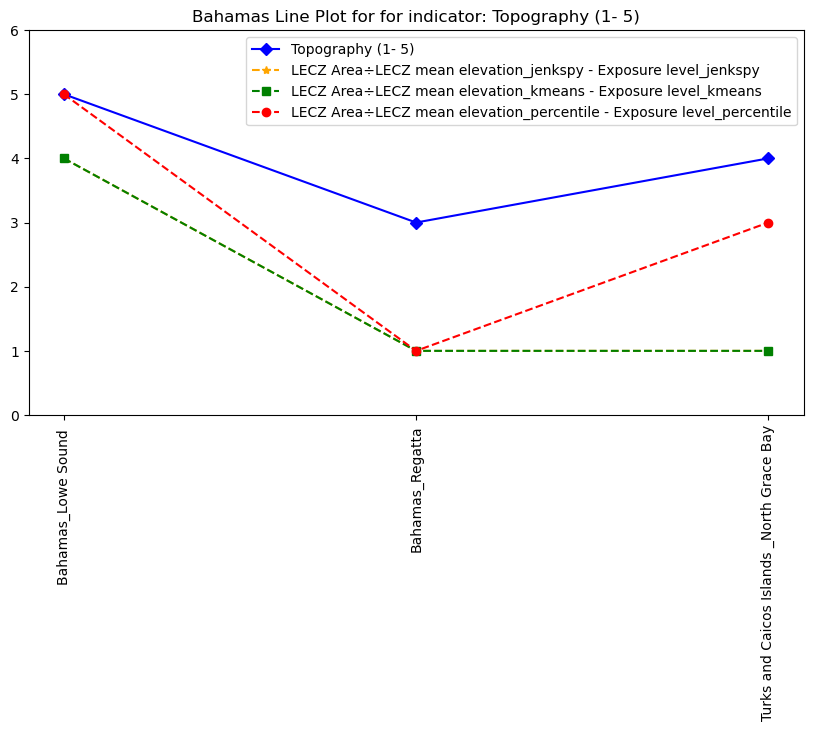

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd


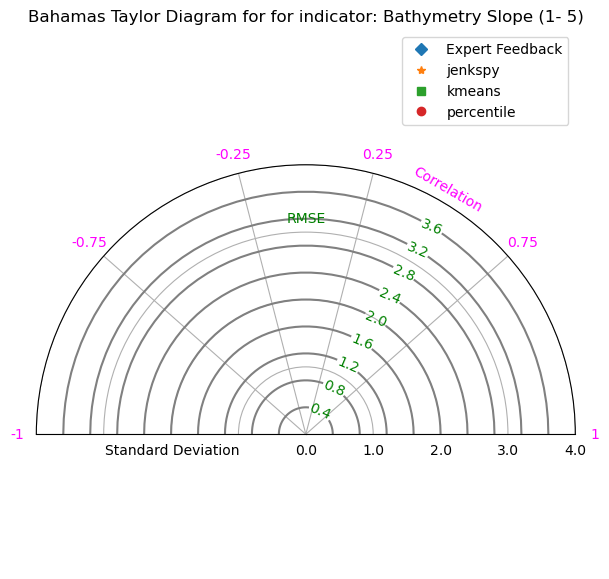

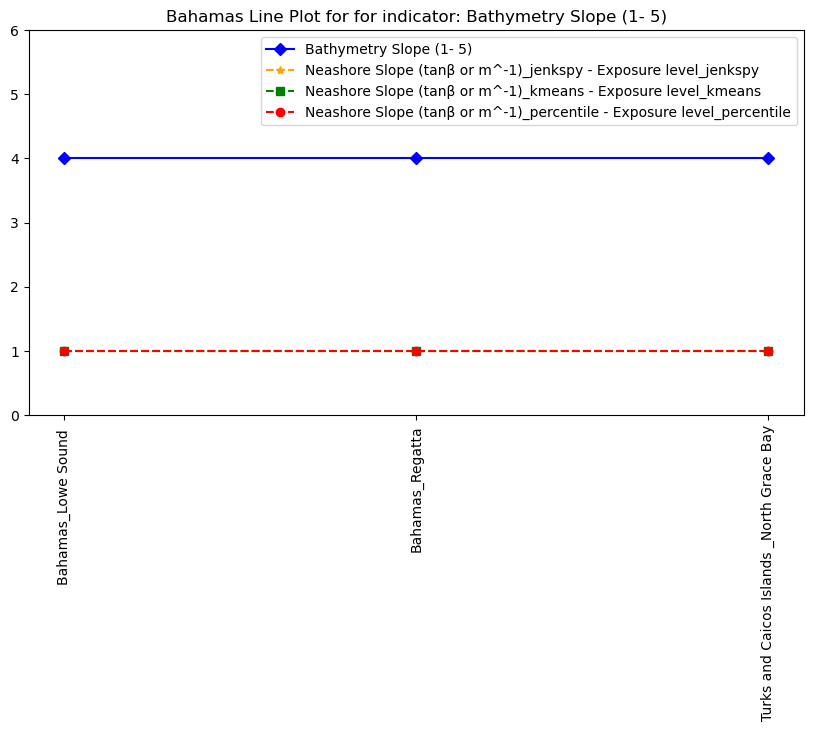

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


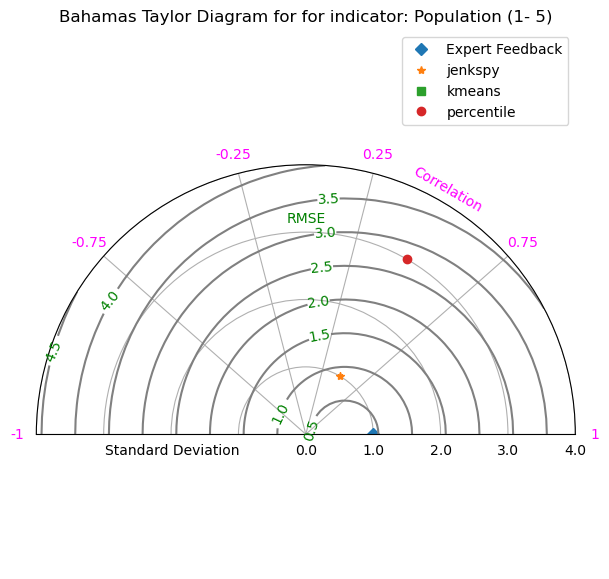

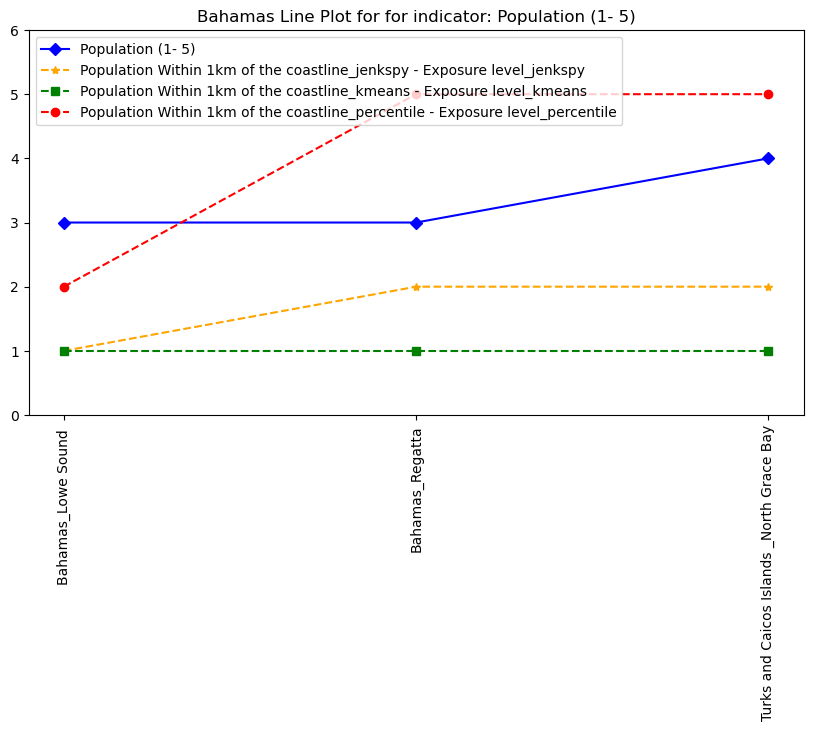

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: divide by zero encountered in scalar divide
  r = stddev / self.refstd


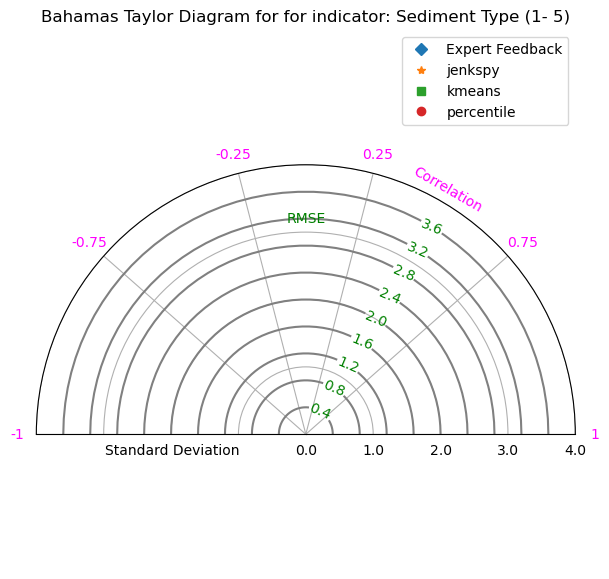

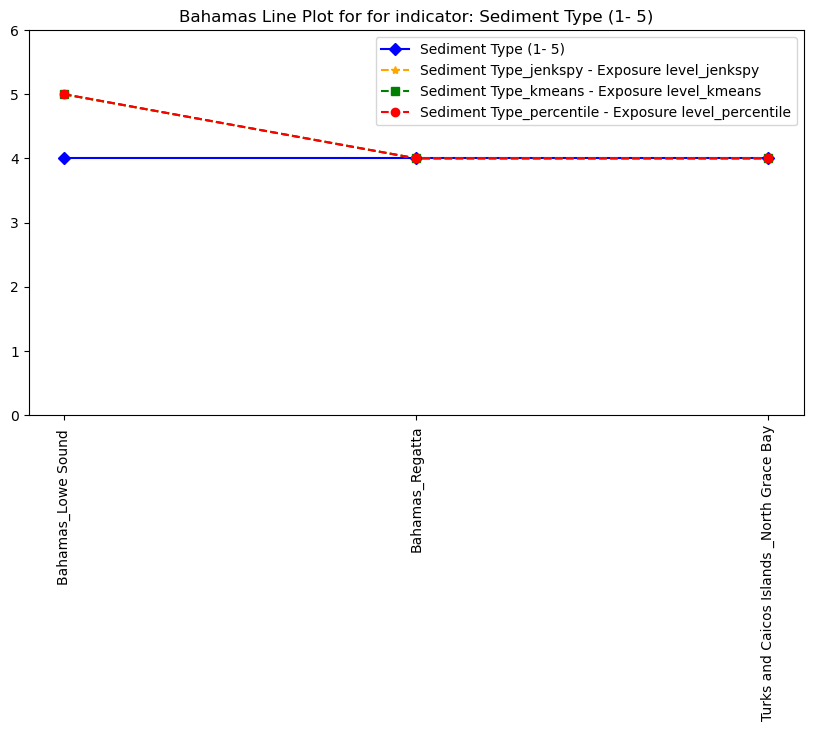

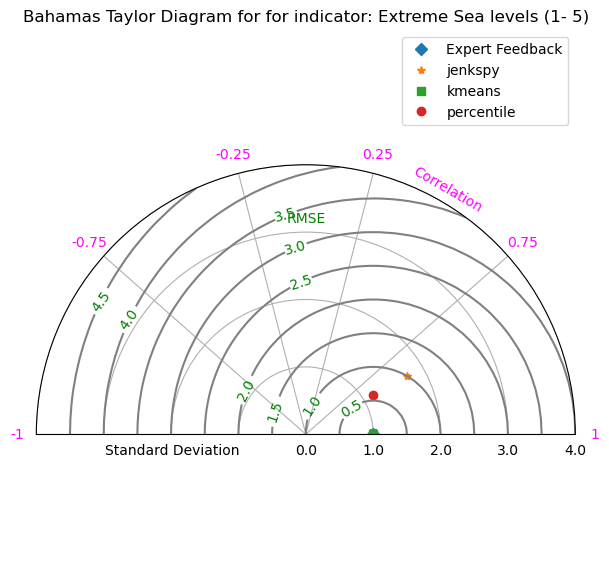

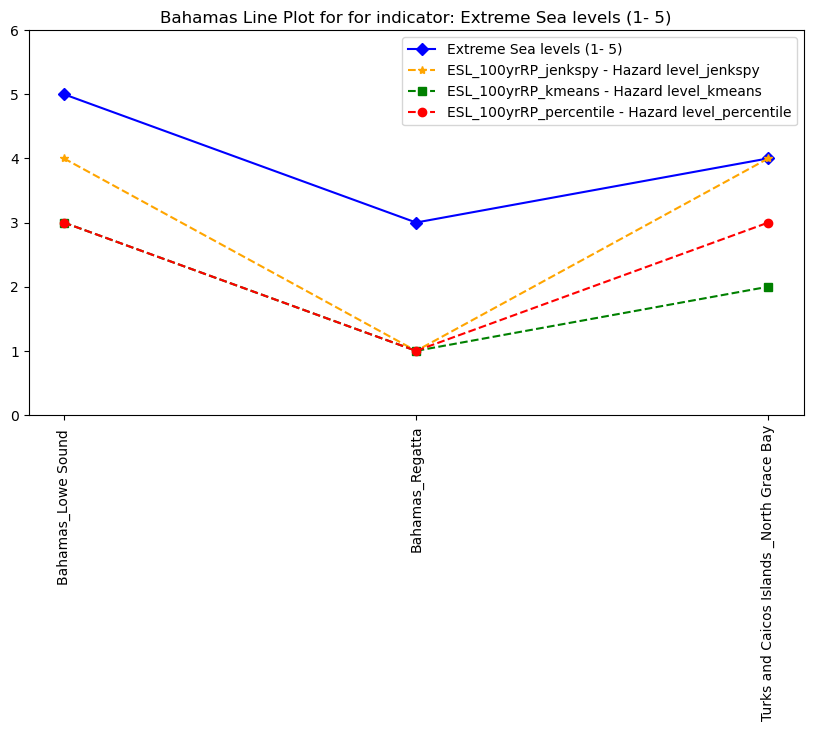

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


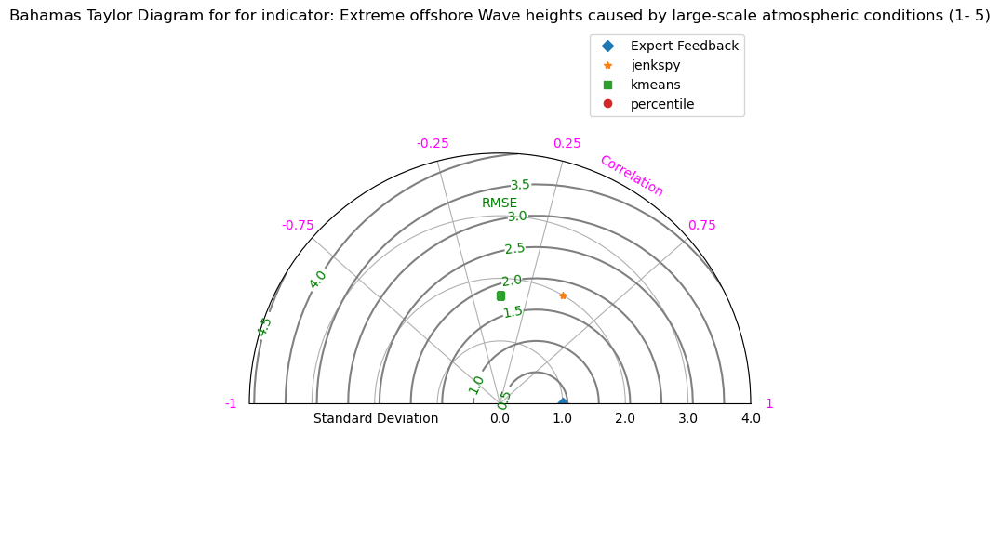

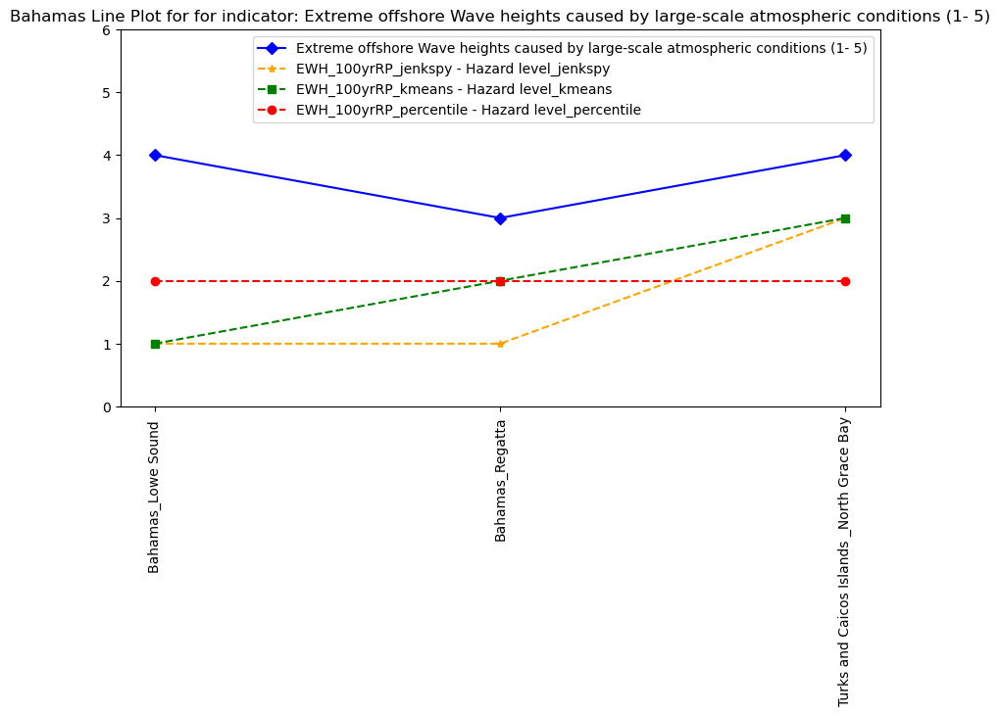

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: divide by zero encountered in scalar divide
  r = stddev / self.refstd


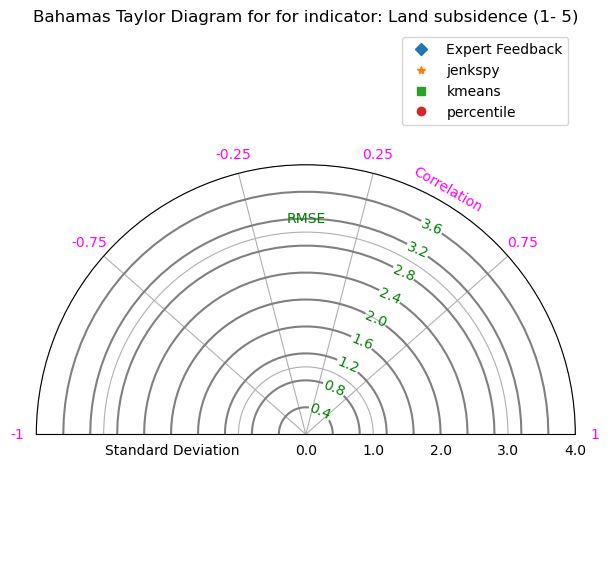

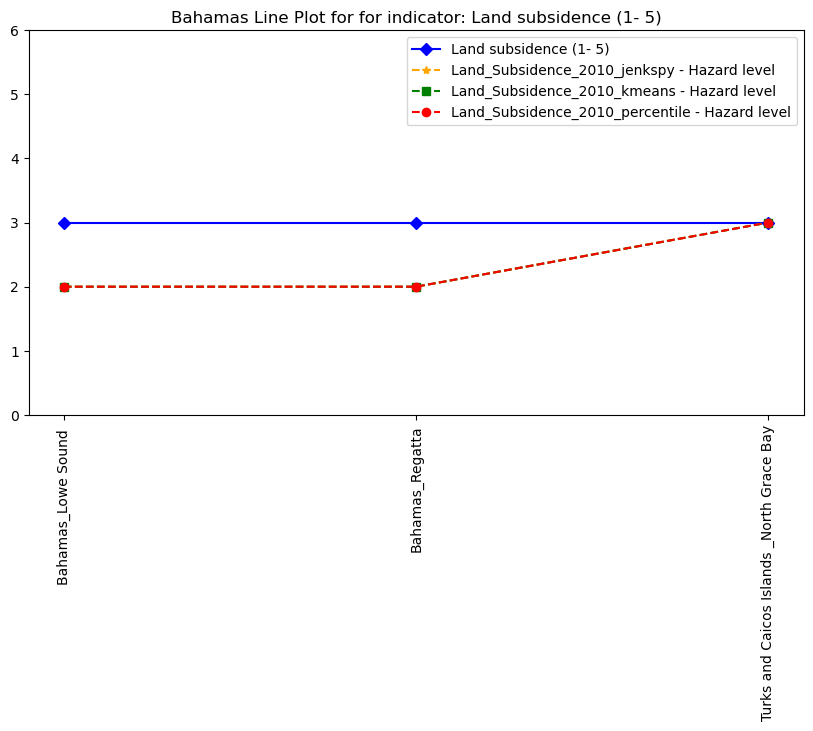

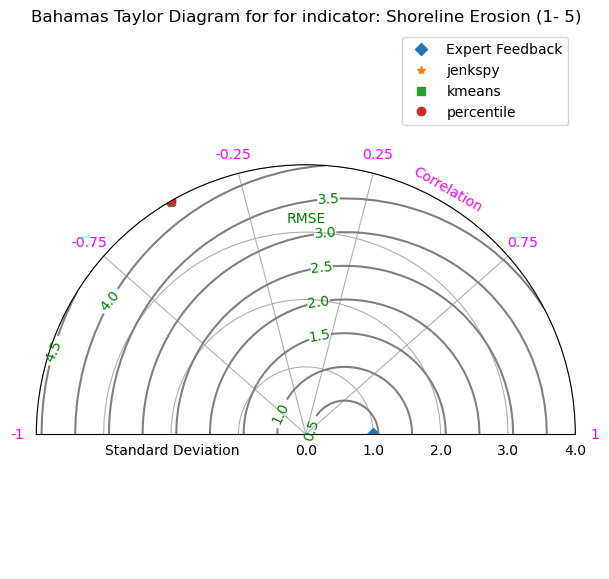

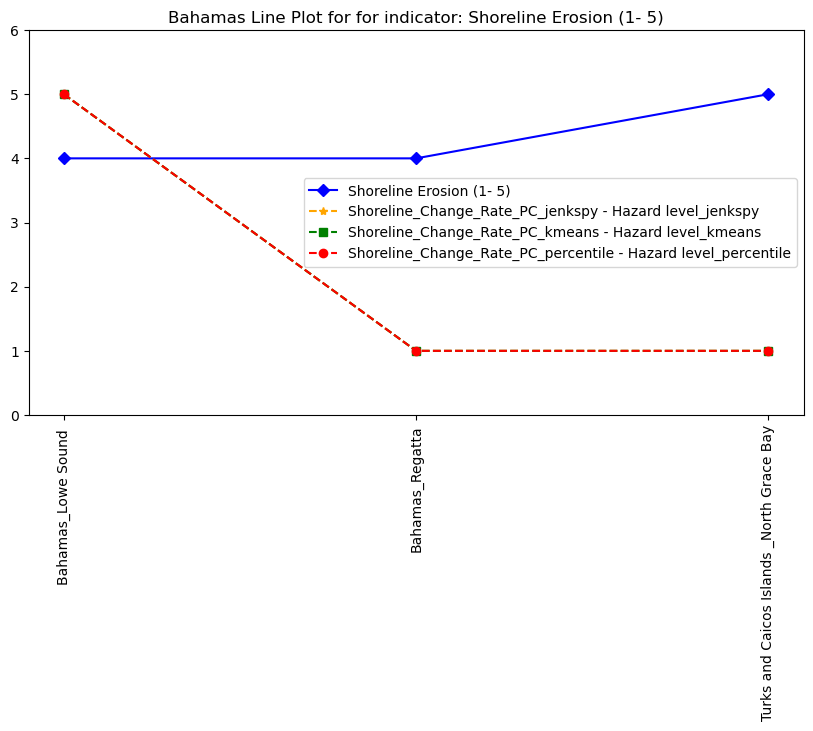

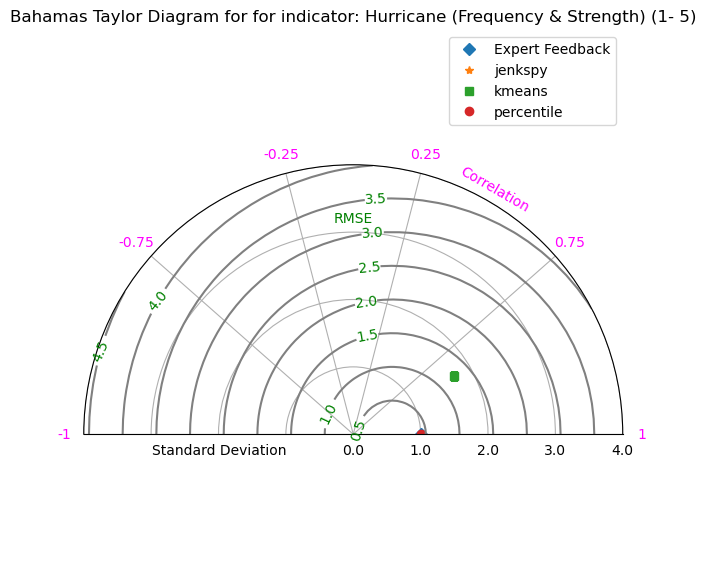

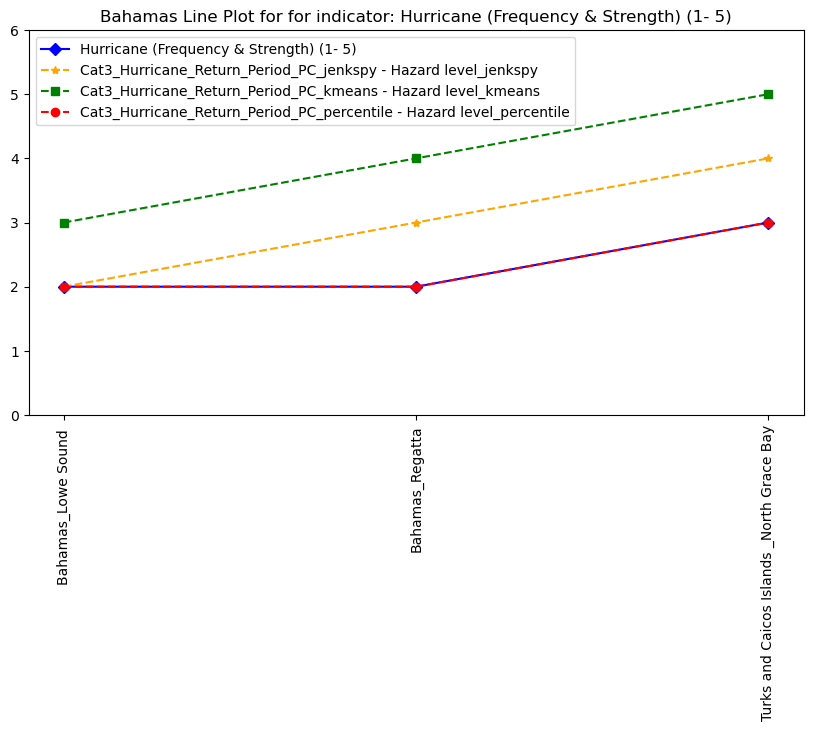

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: divide by zero encountered in scalar divide
  r = stddev / self.refstd


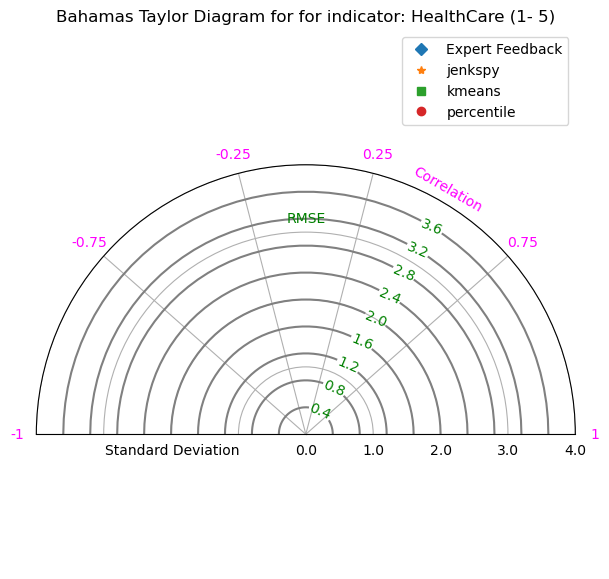

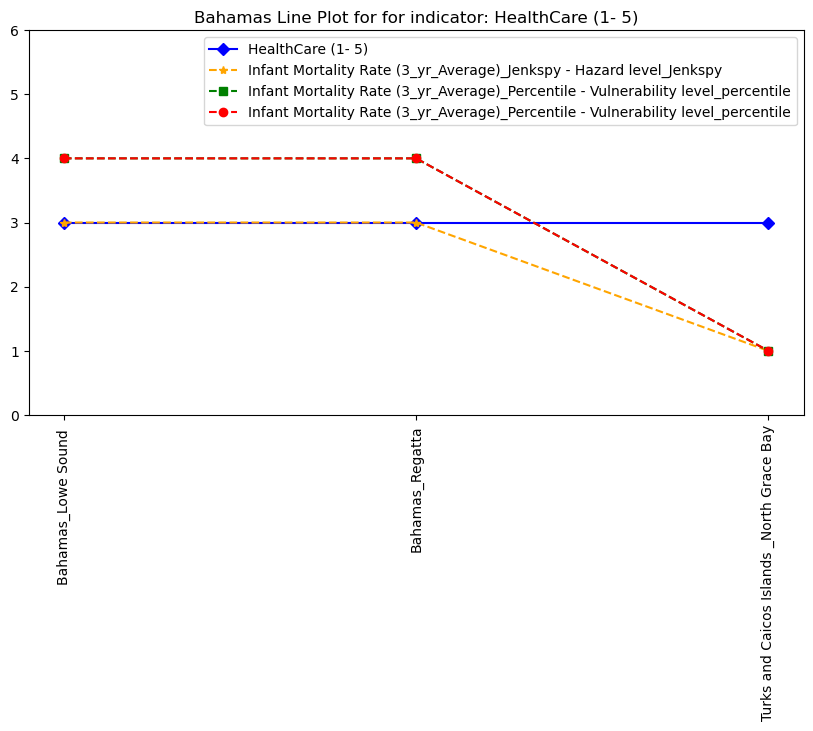

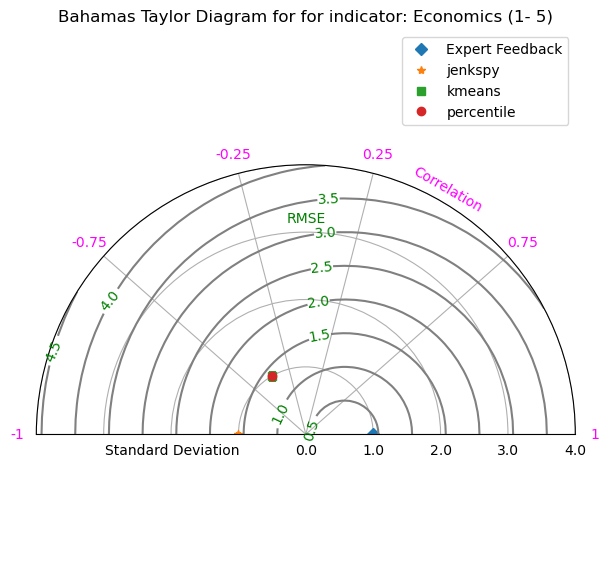

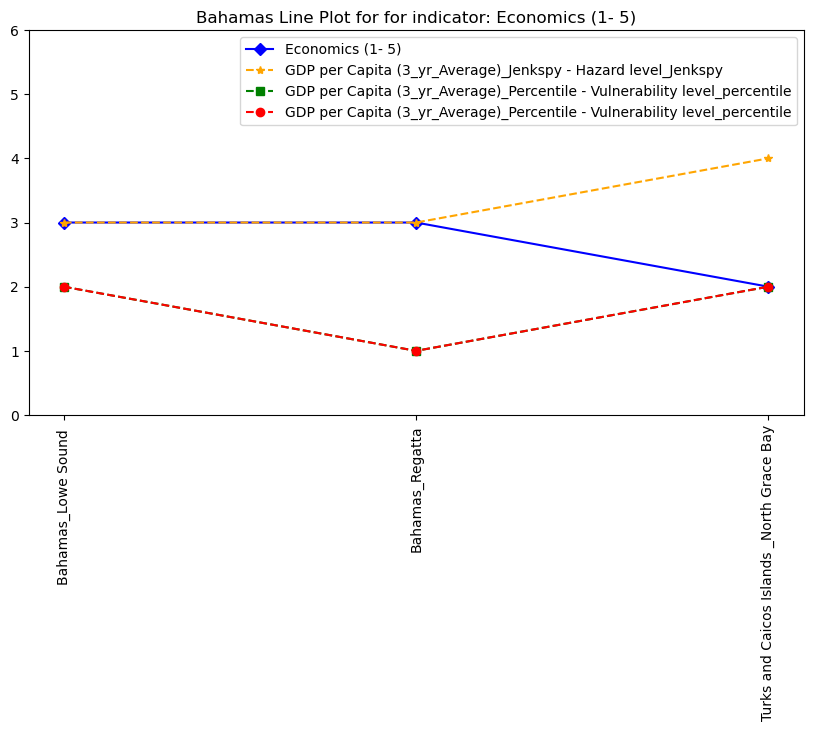

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: divide by zero encountered in scalar divide
  r = stddev / self.refstd


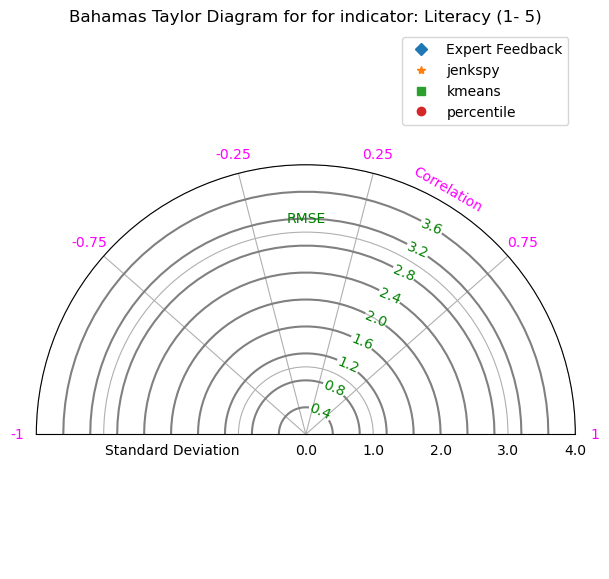

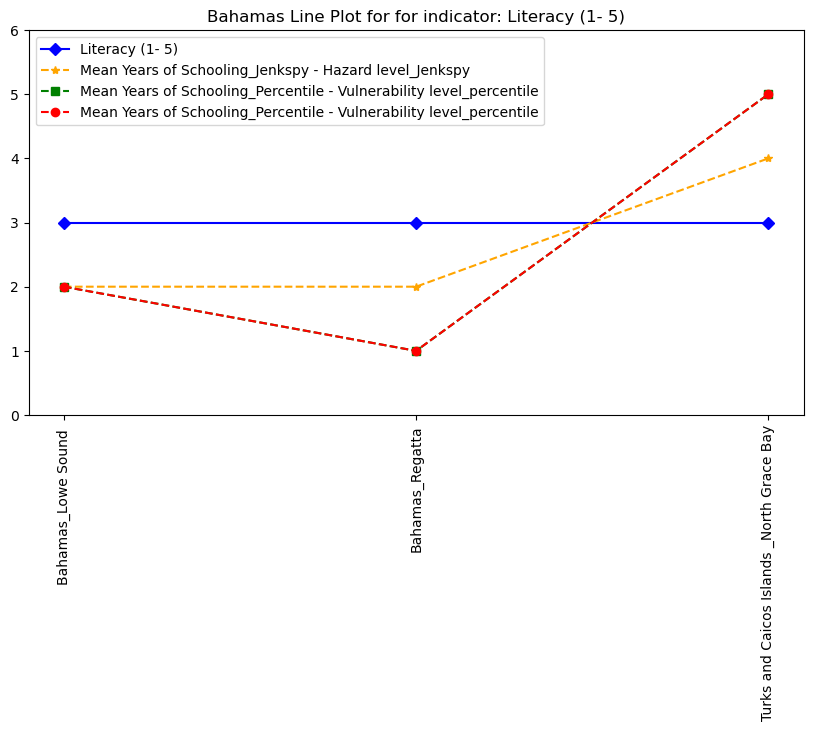

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


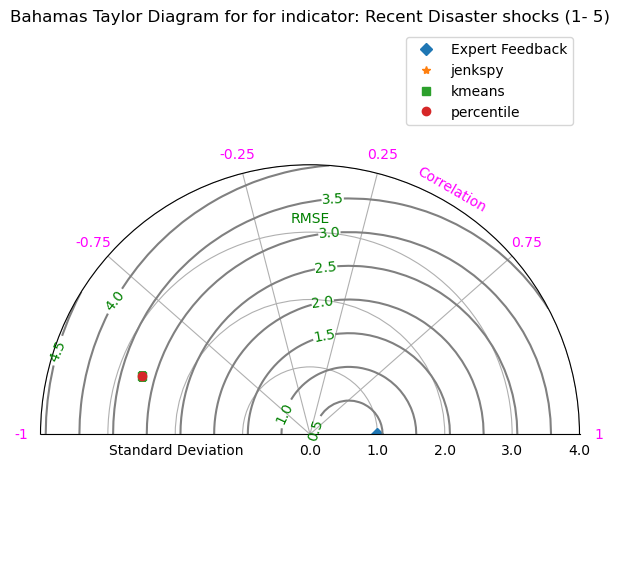

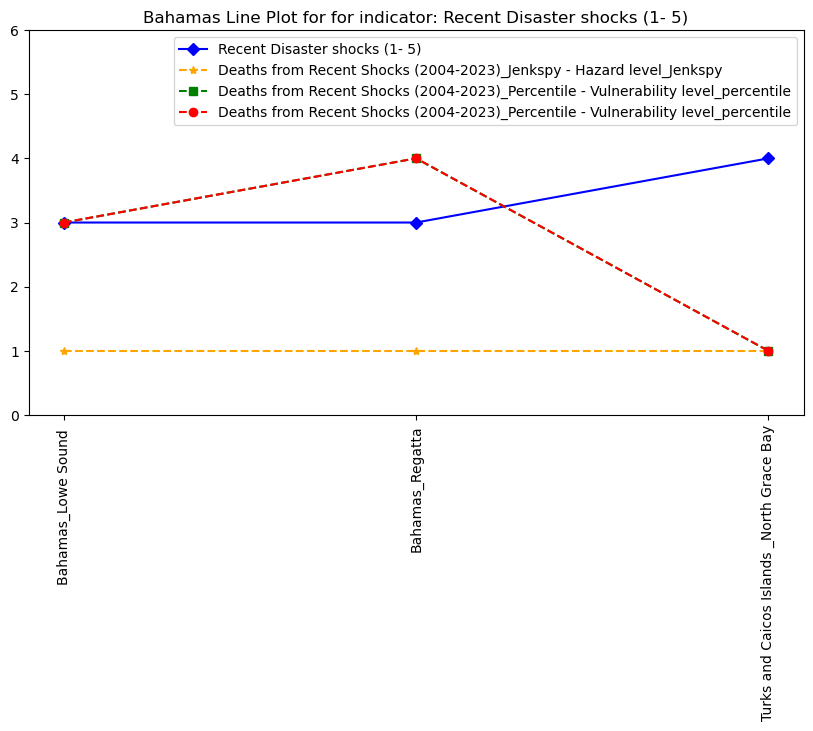

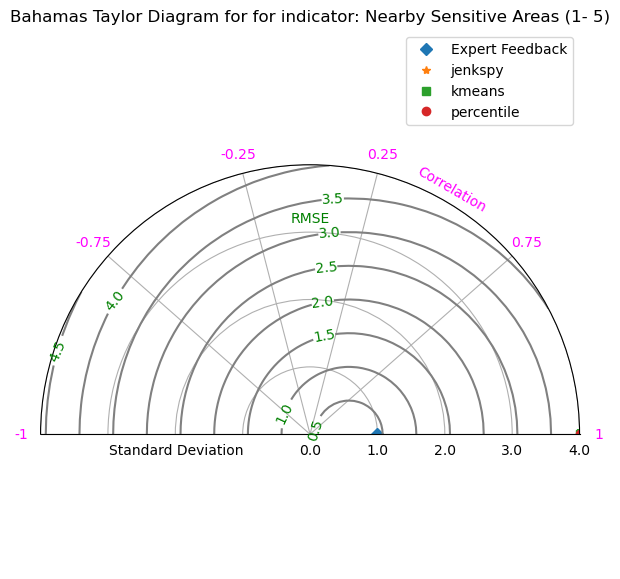

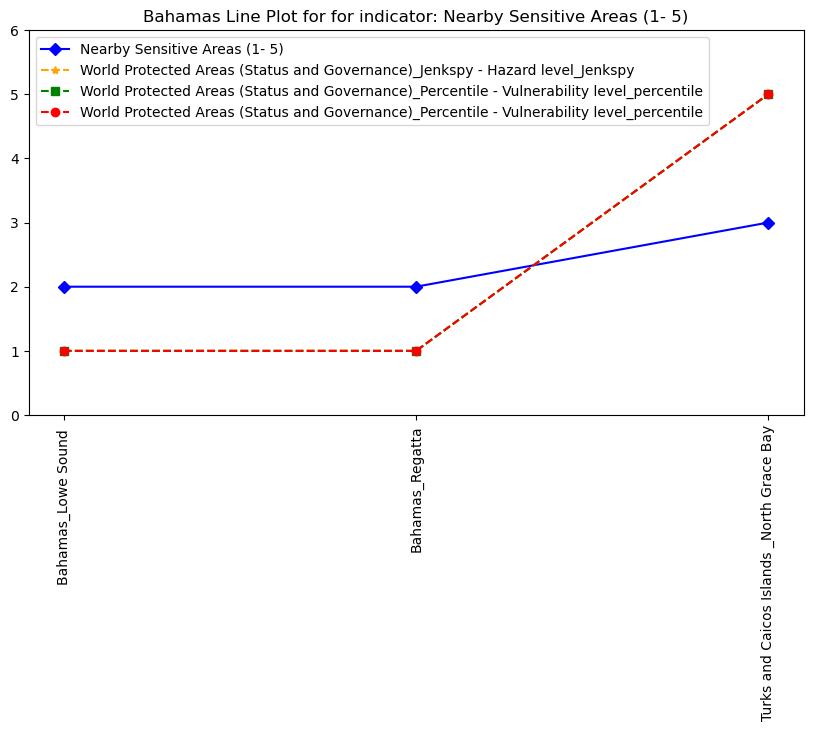

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


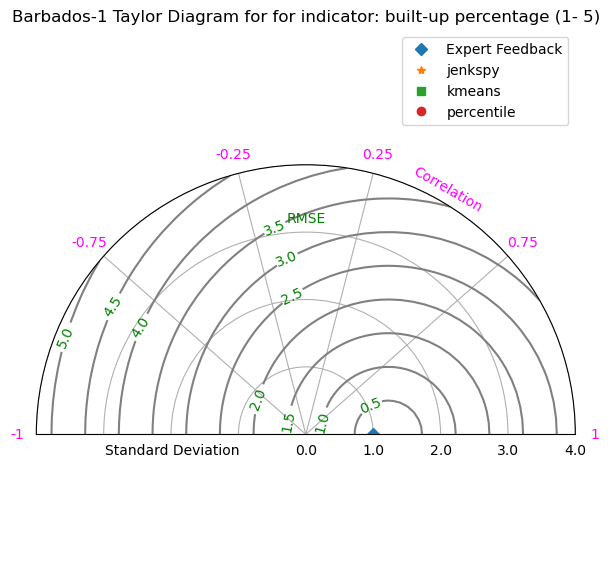

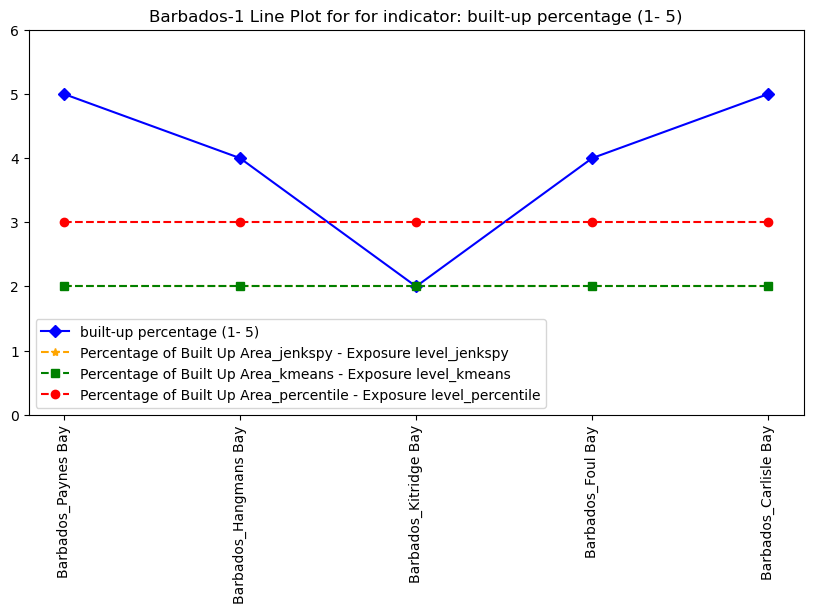

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


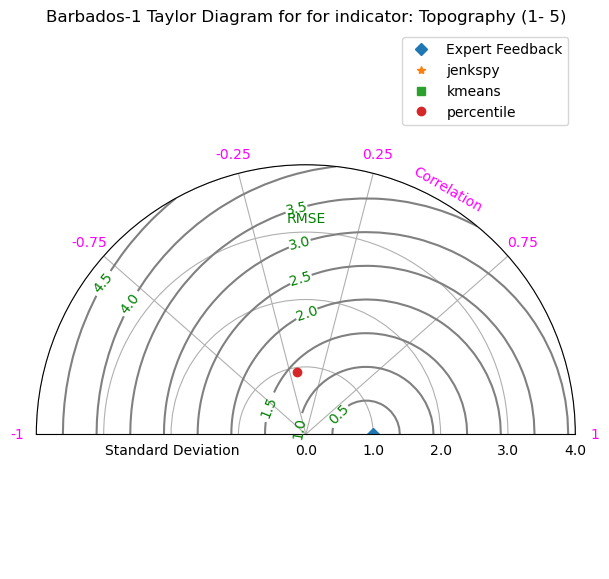

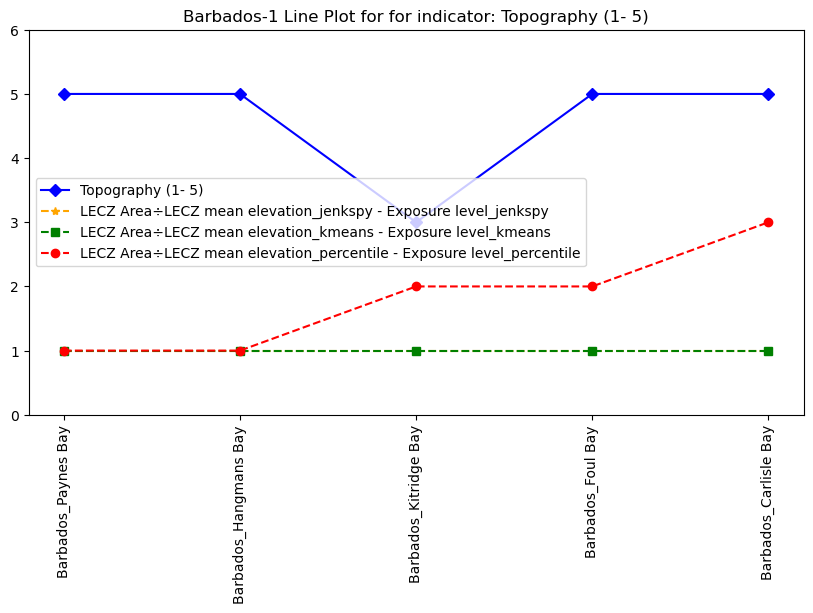

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: divide by zero encountered in scalar divide
  r = stddev / self.refstd


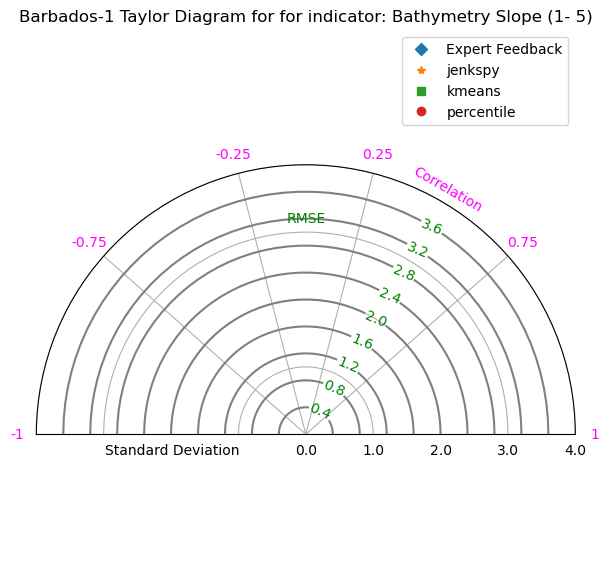

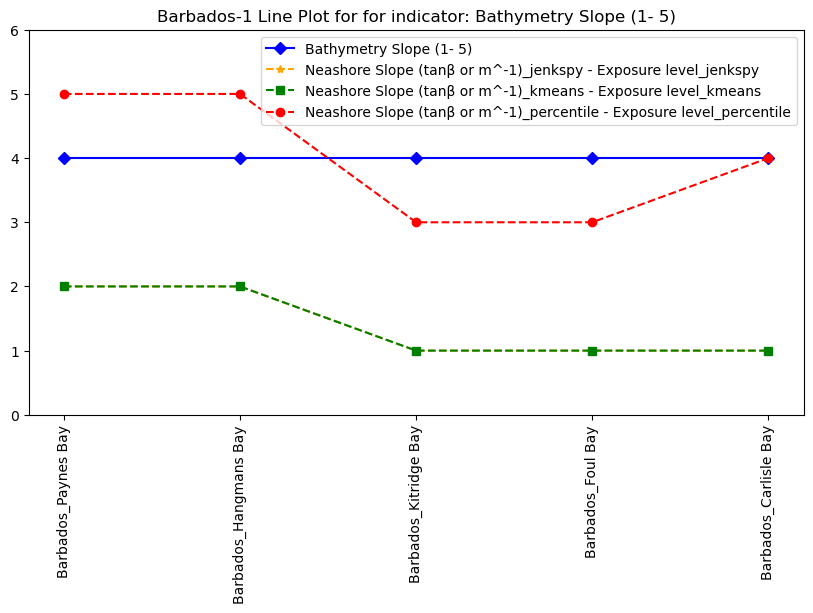

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


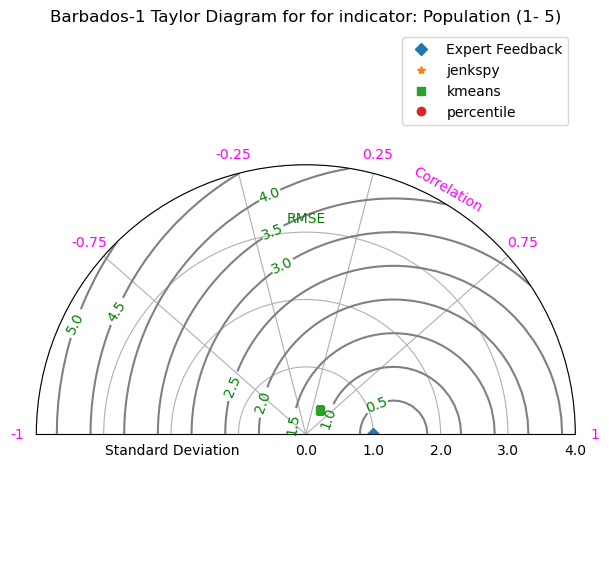

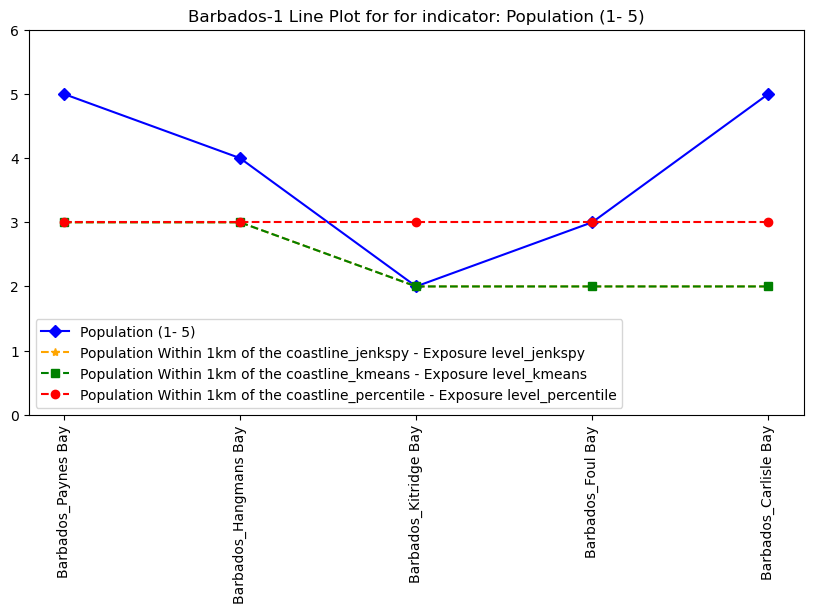

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: divide by zero encountered in scalar divide
  r = stddev / self.refstd


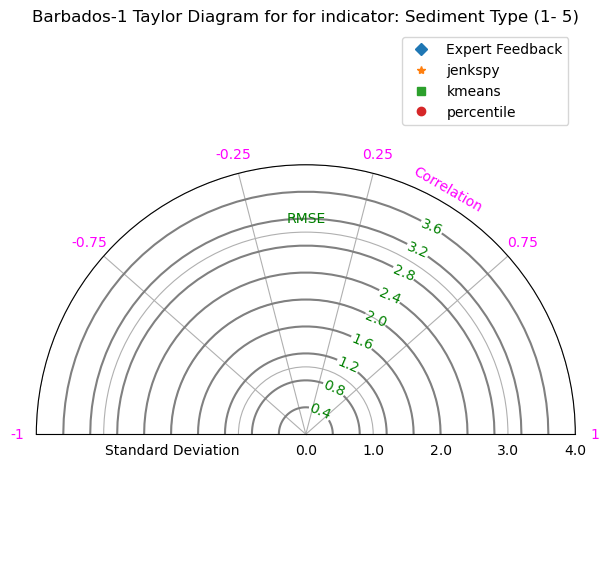

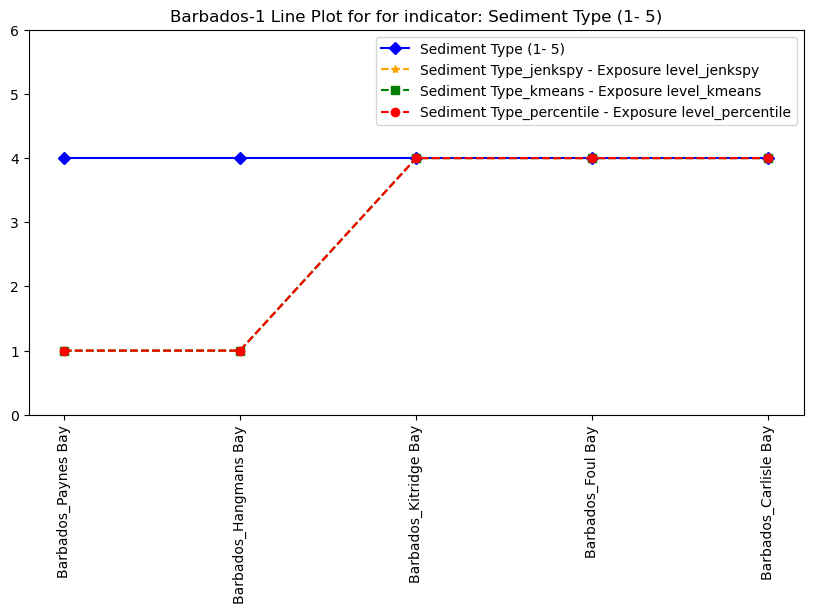

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


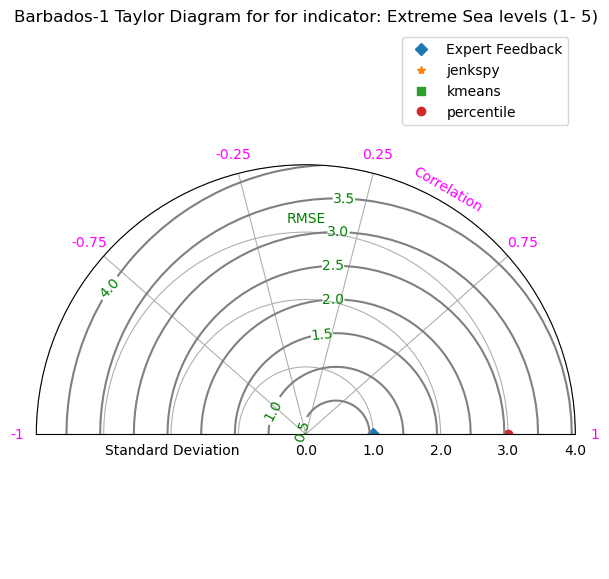

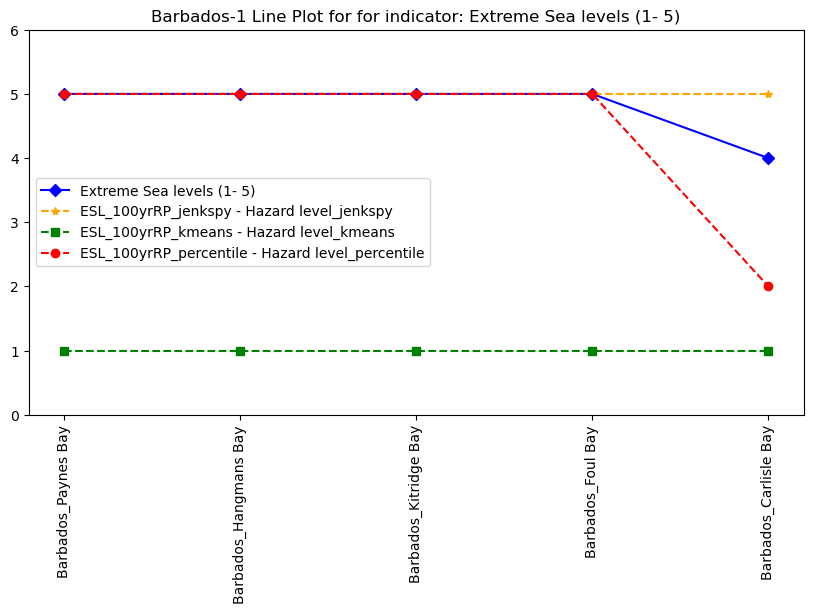

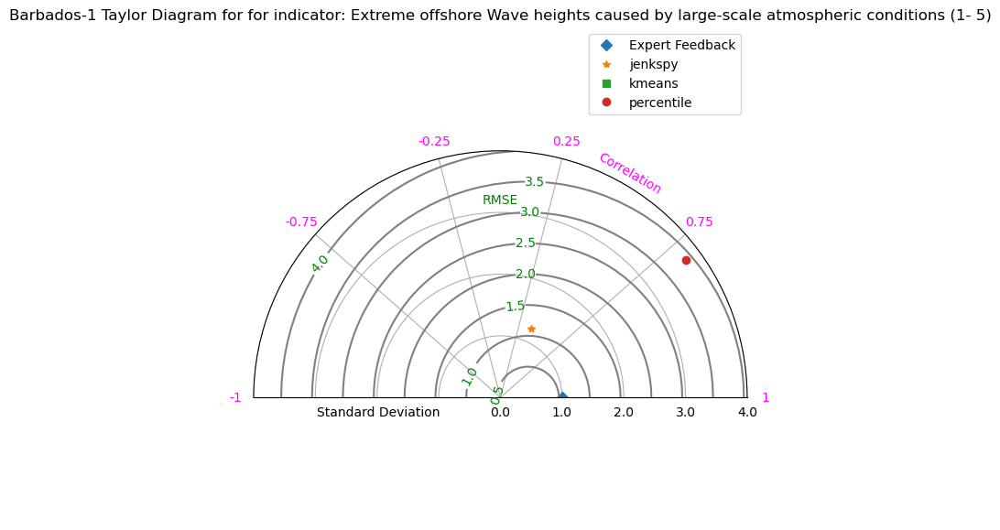

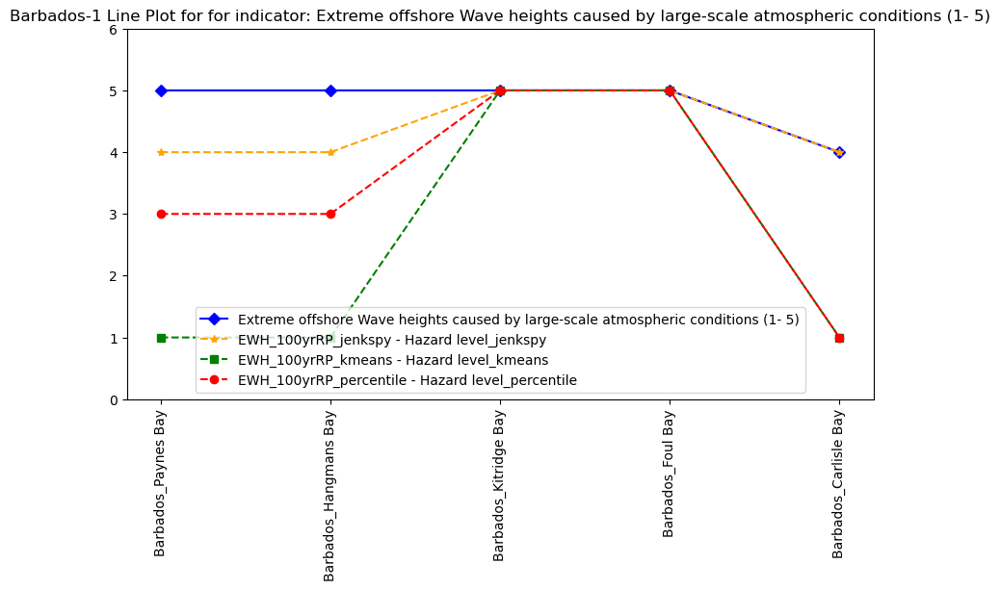

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


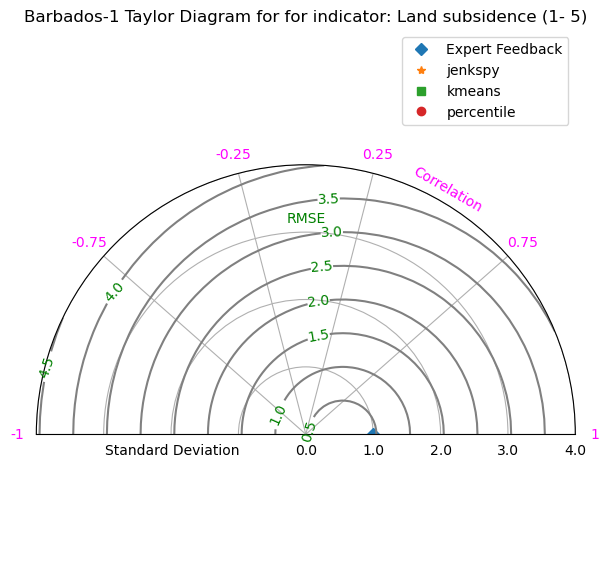

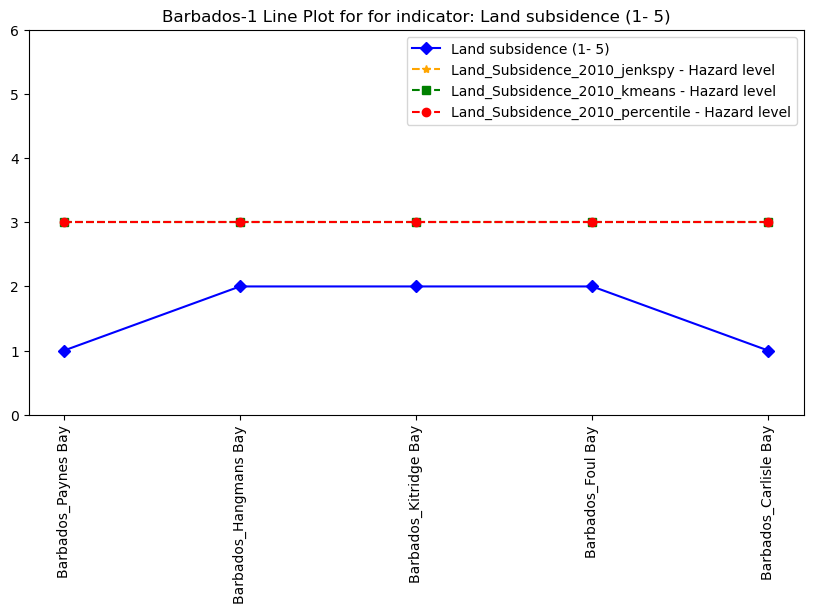

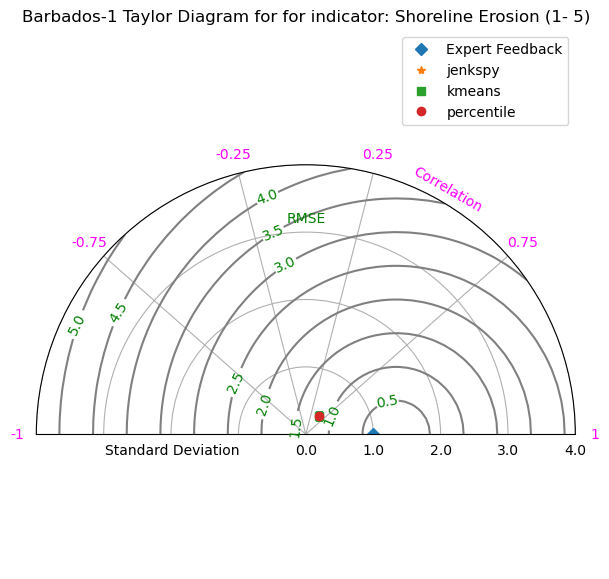

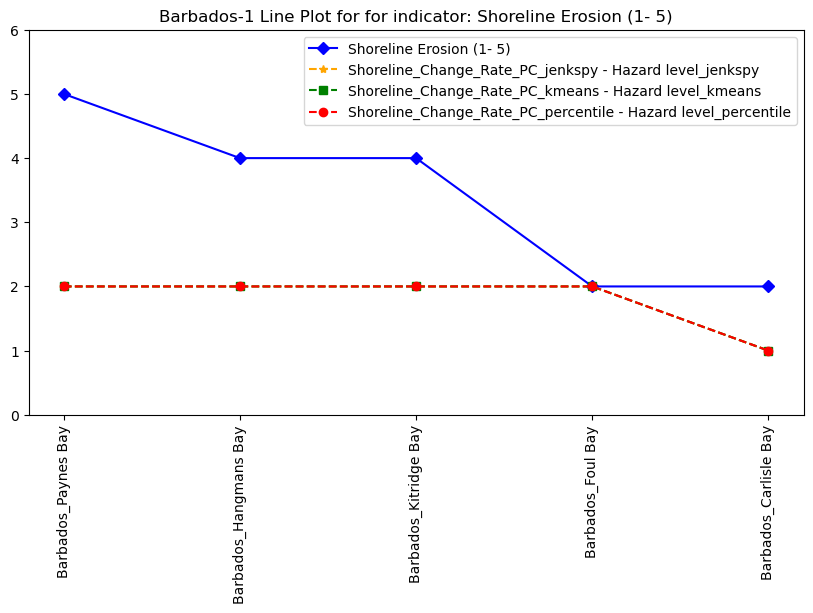

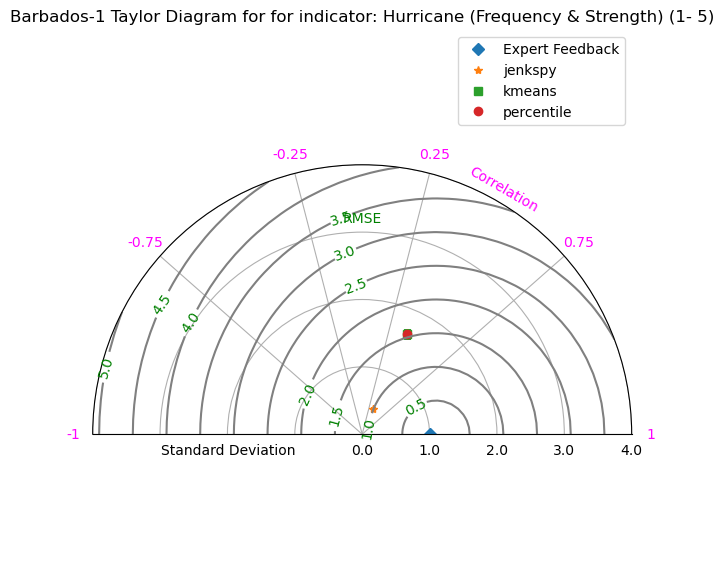

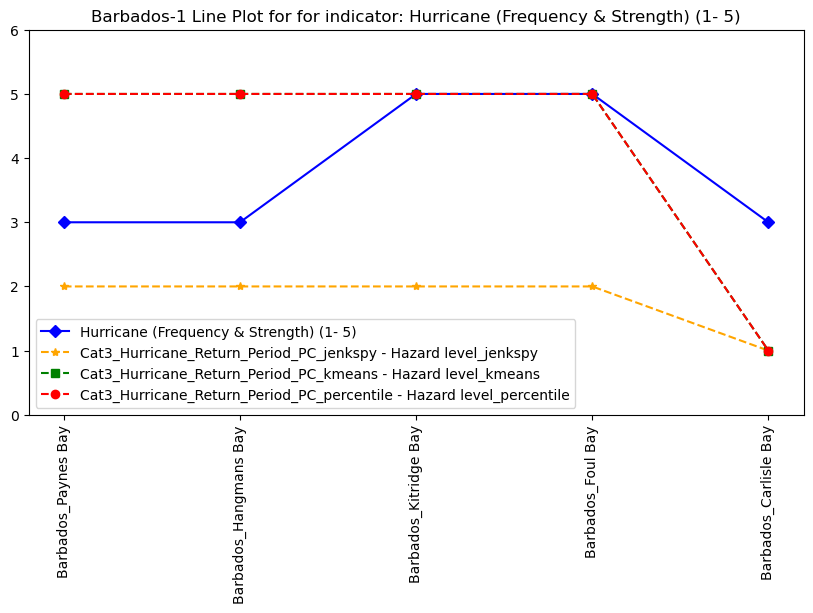

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: divide by zero encountered in scalar divide
  r = stddev / self.refstd


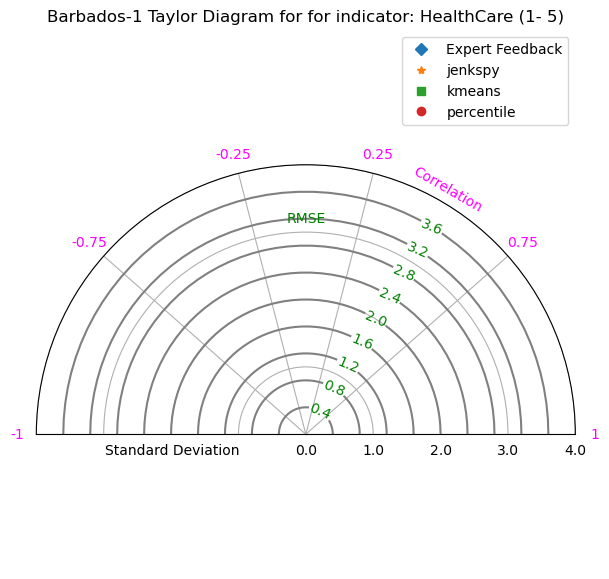

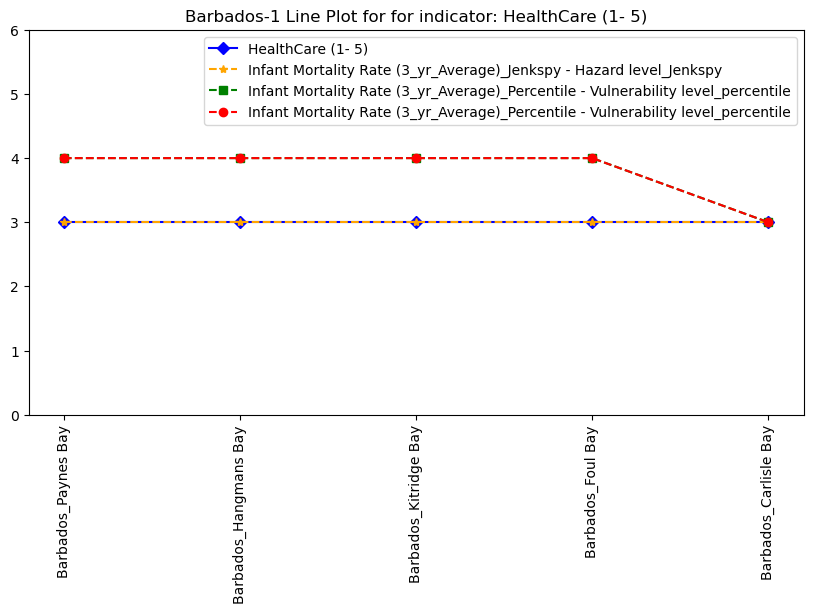

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


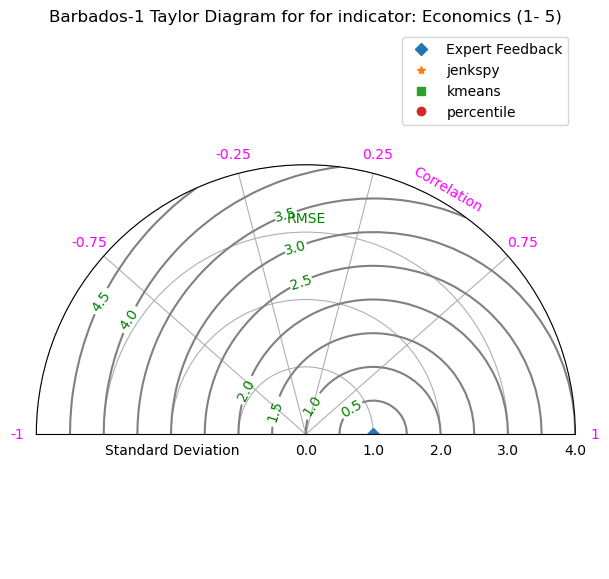

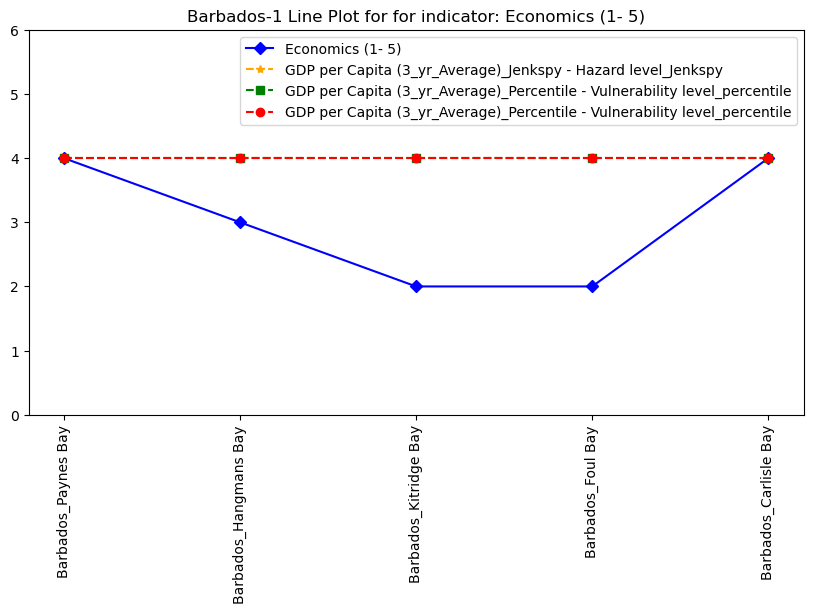

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd


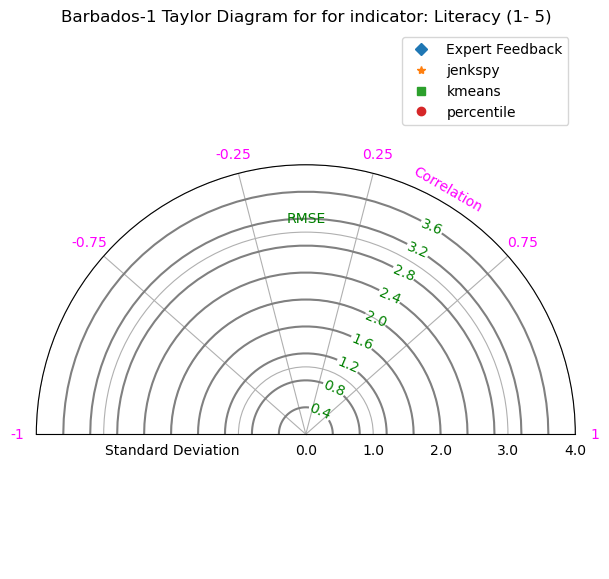

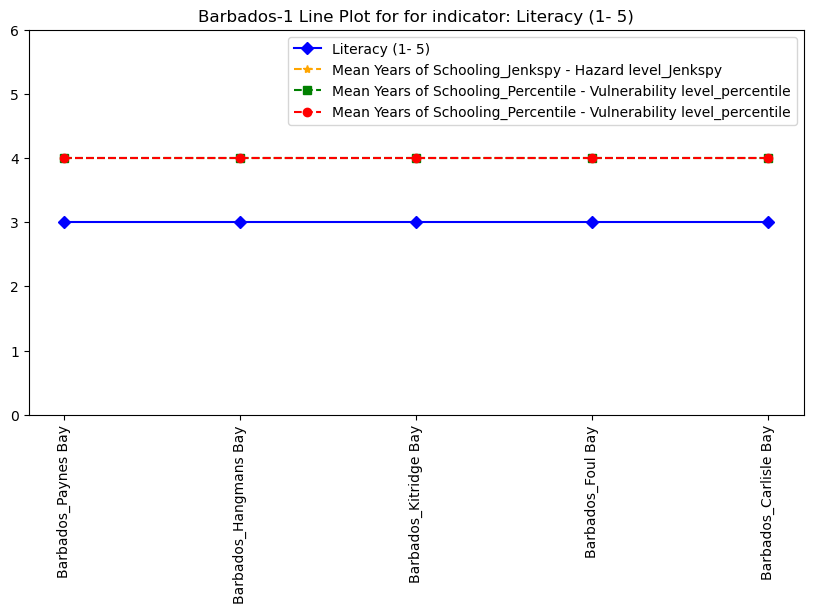

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


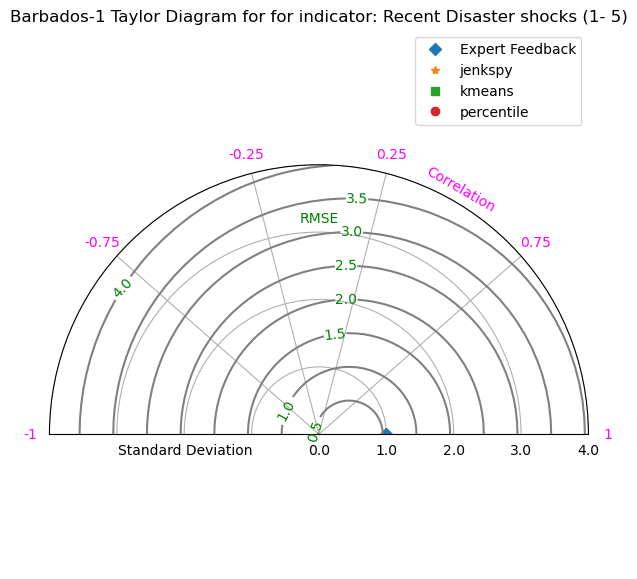

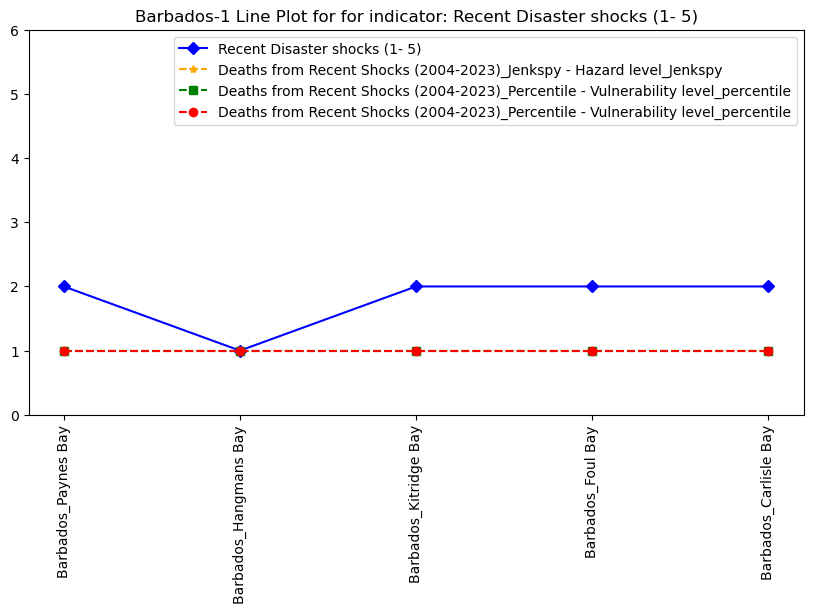

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: divide by zero encountered in scalar divide
  r = stddev / self.refstd


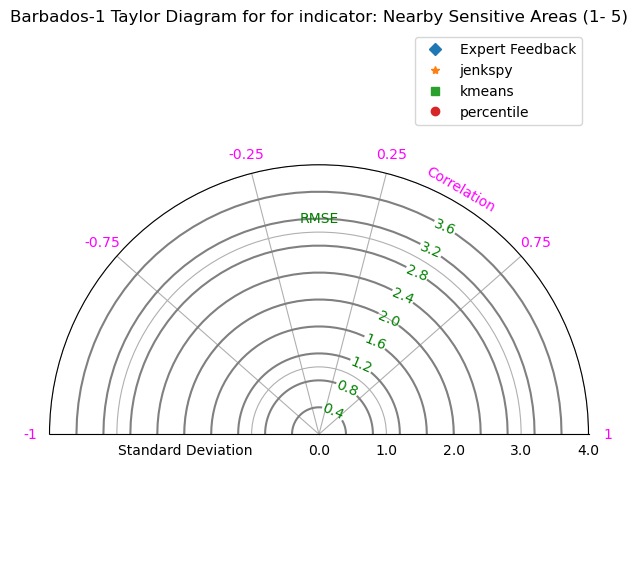

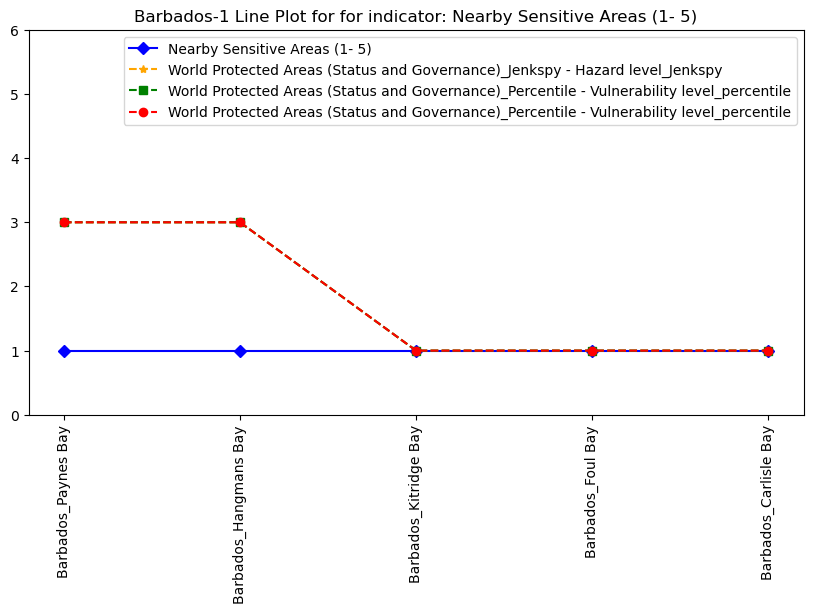

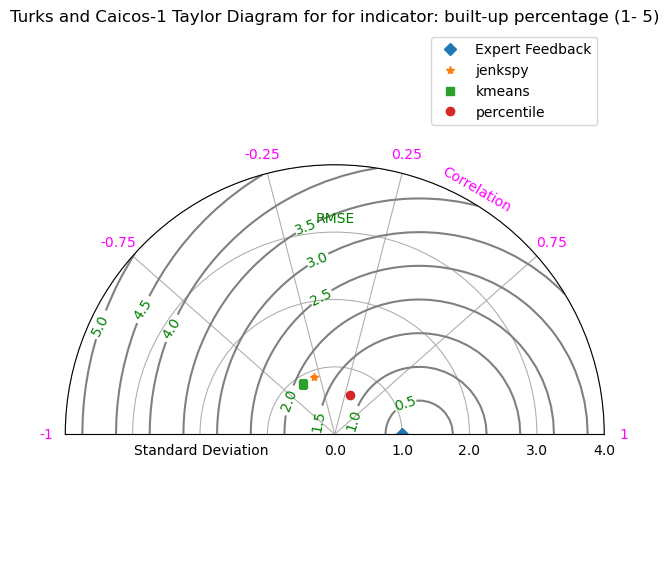

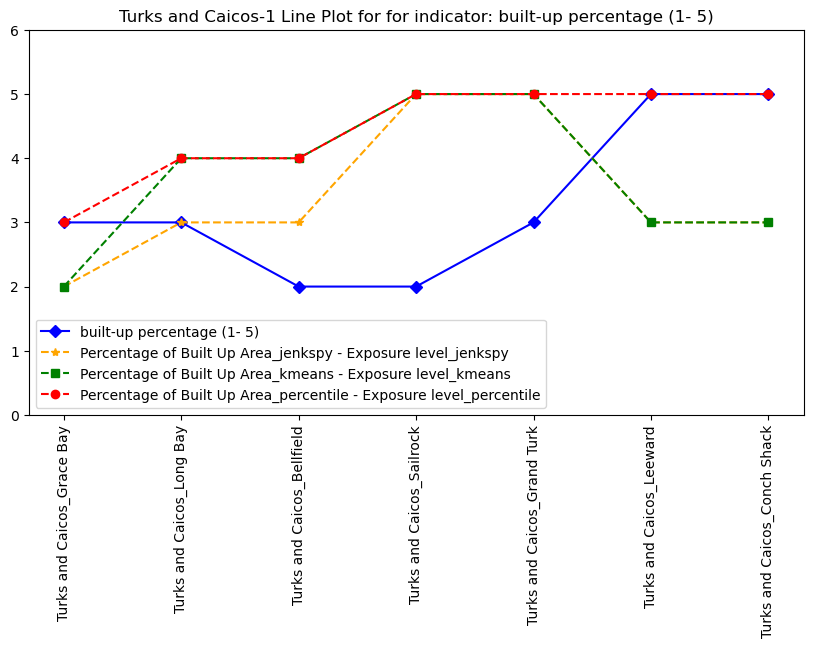

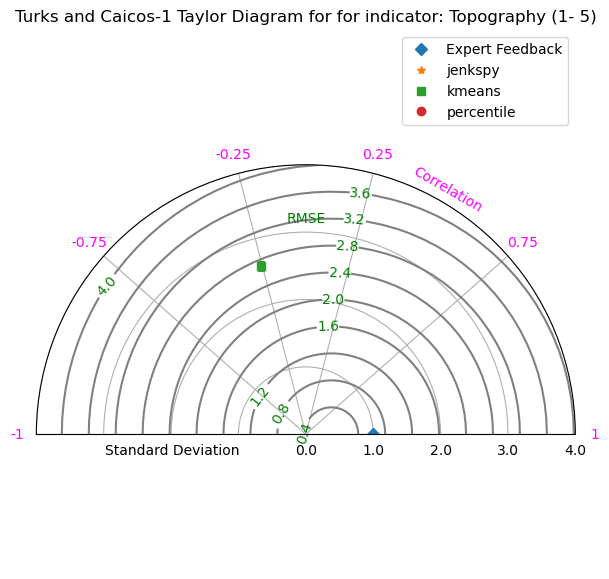

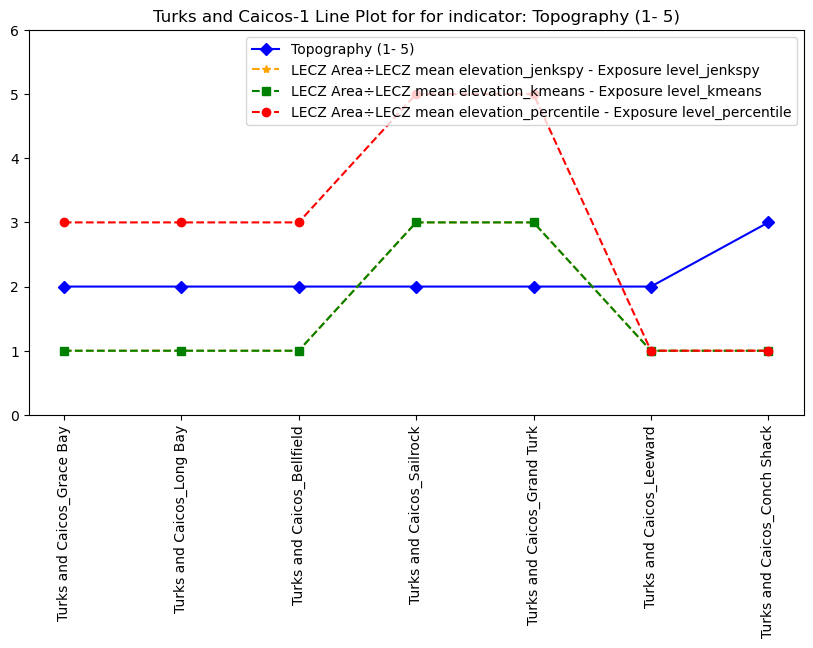

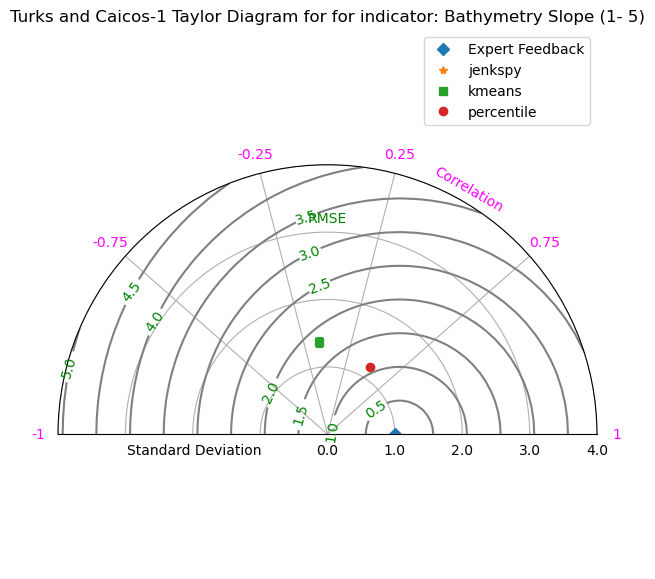

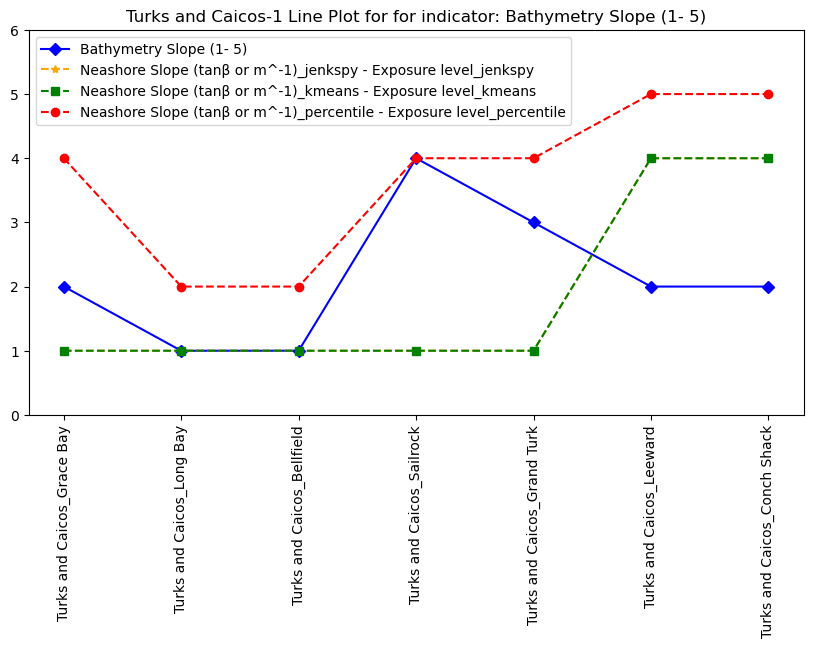

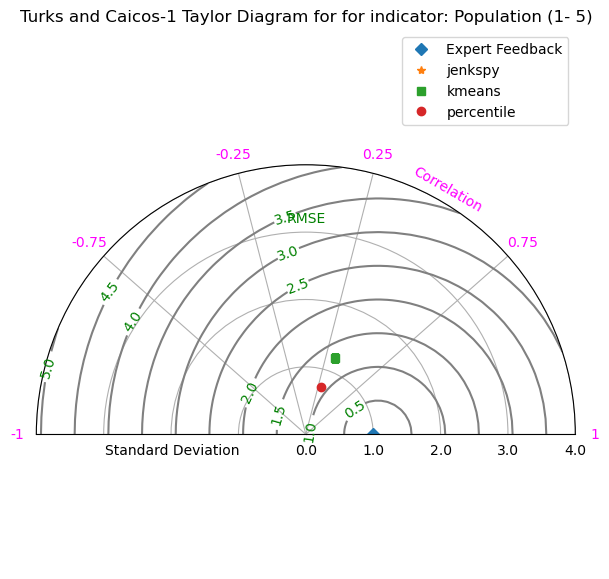

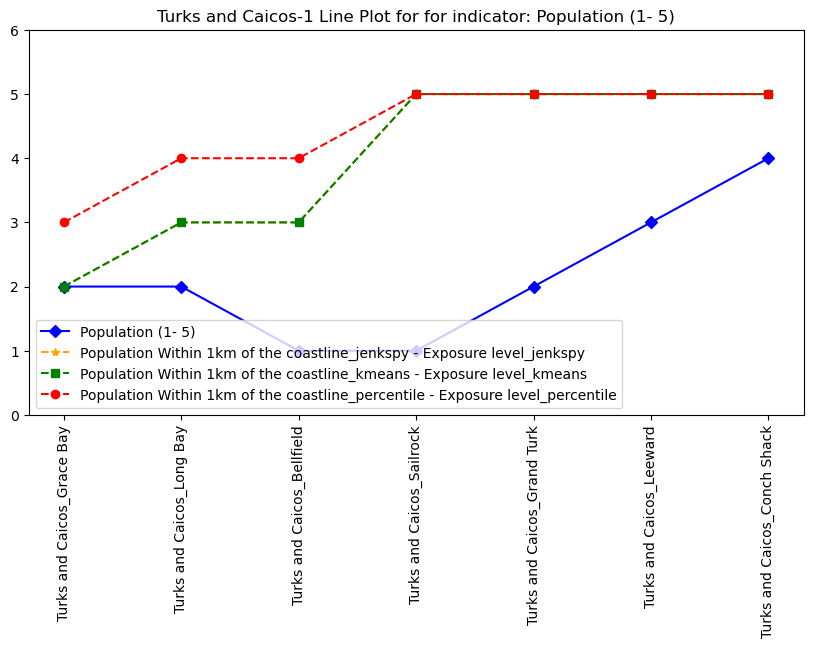

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd


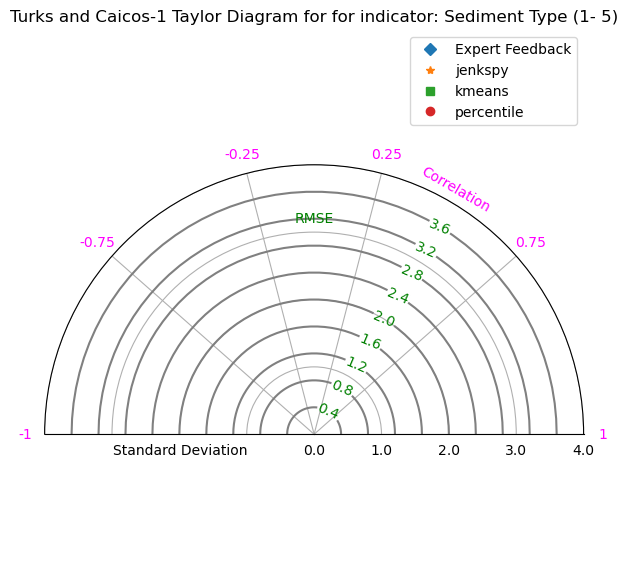

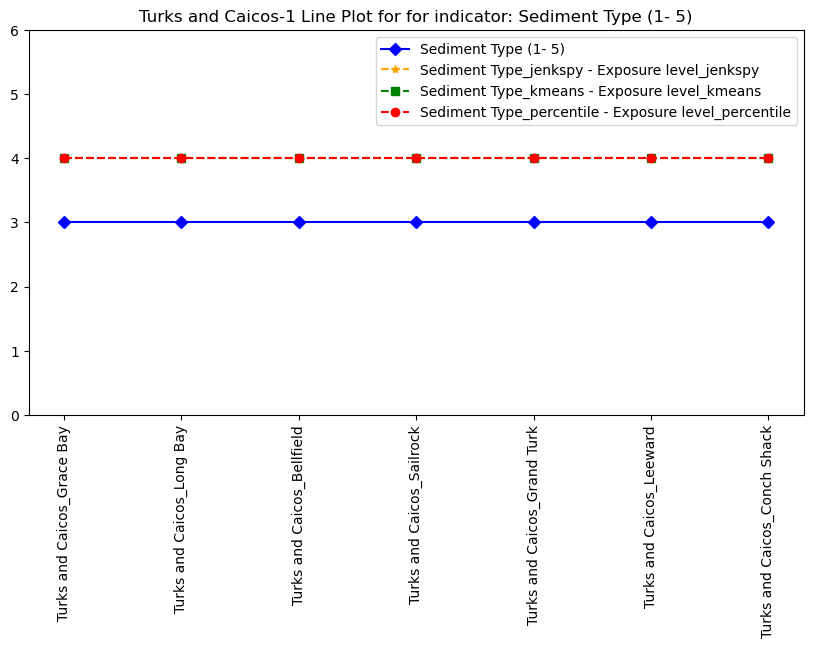

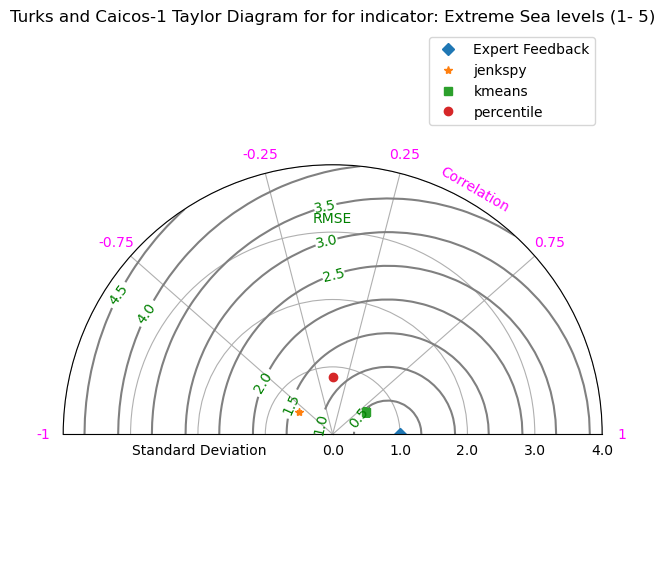

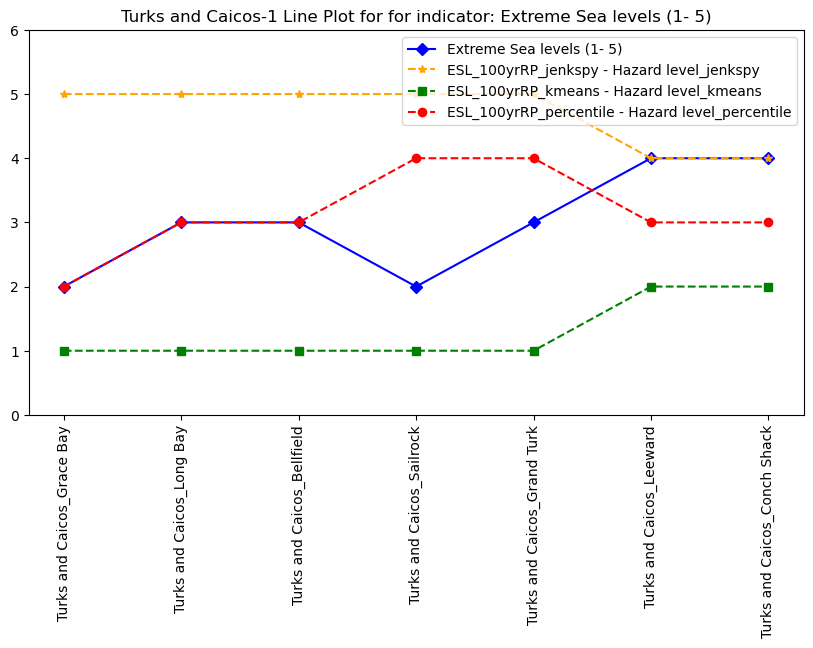

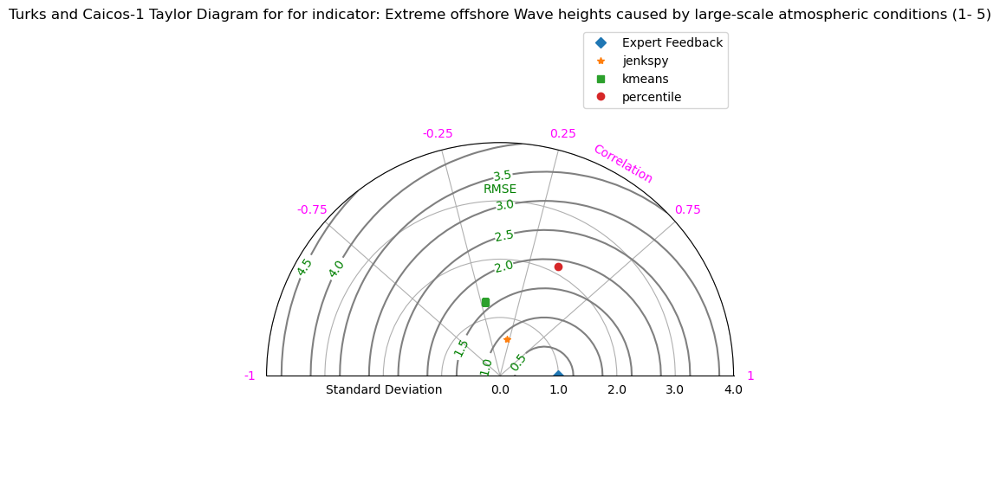

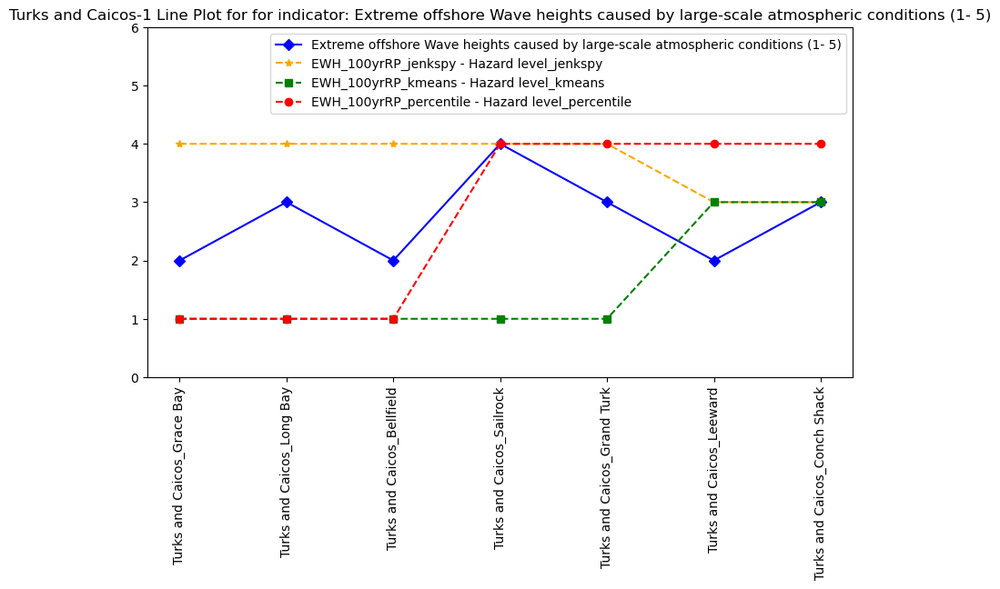

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd


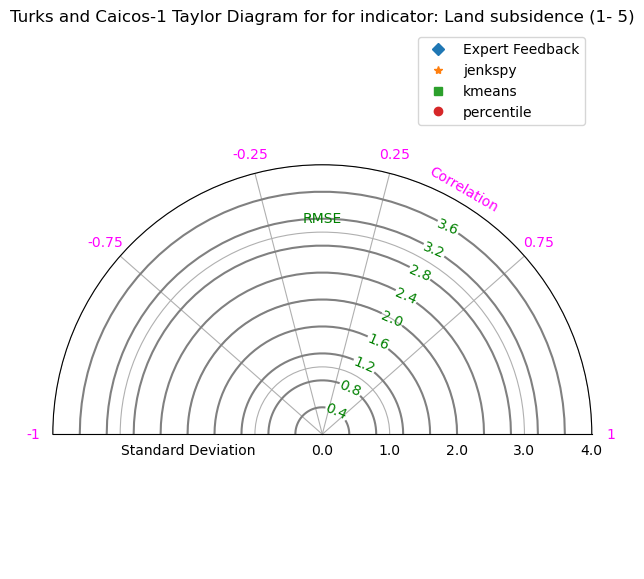

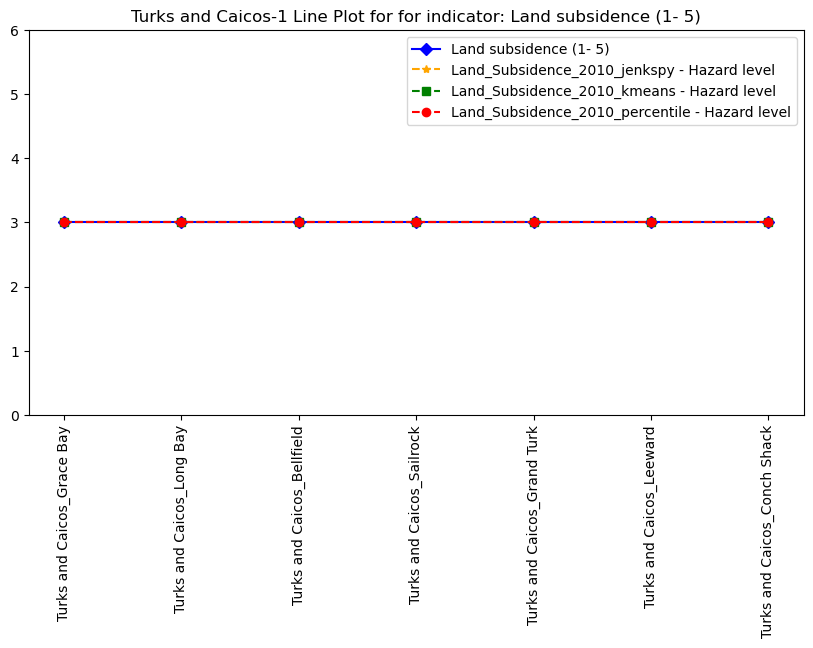

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


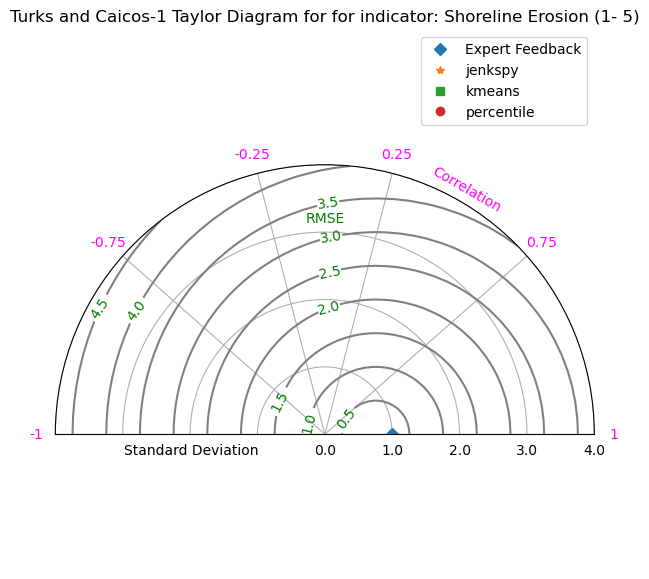

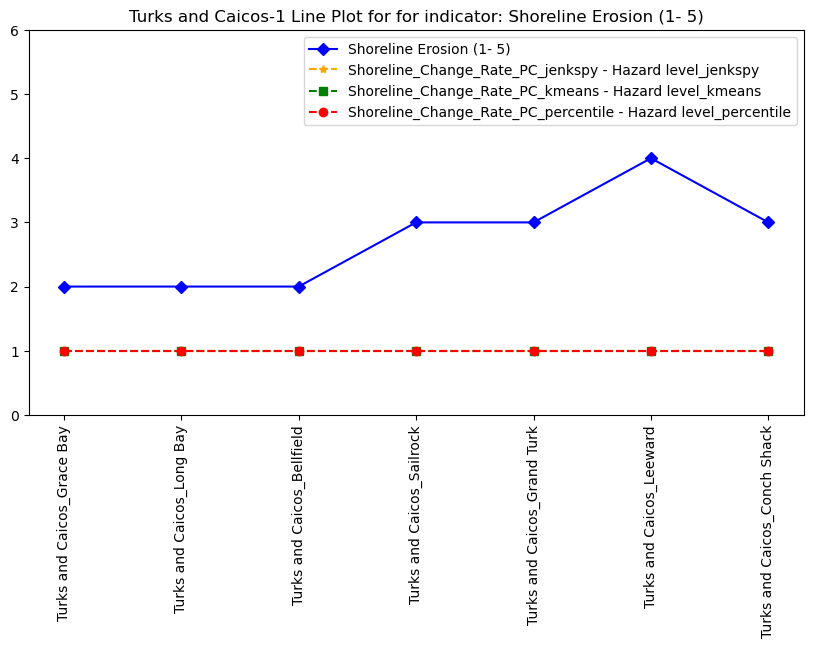

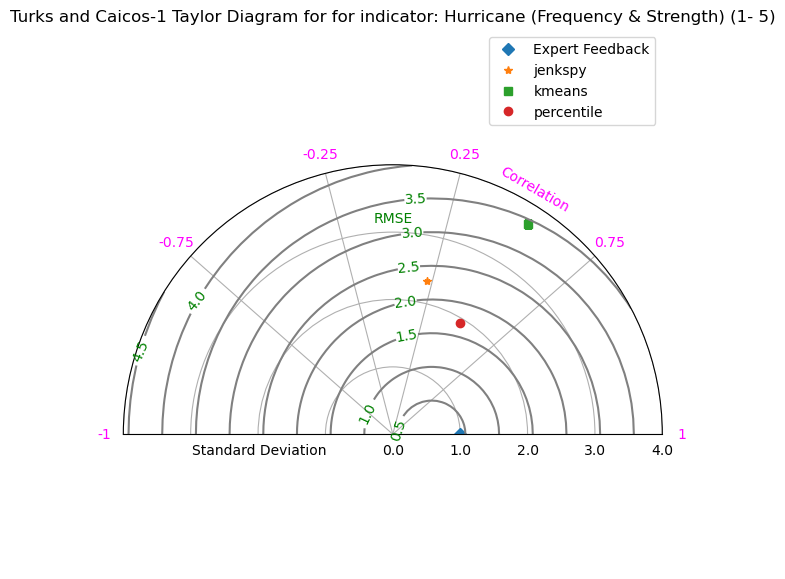

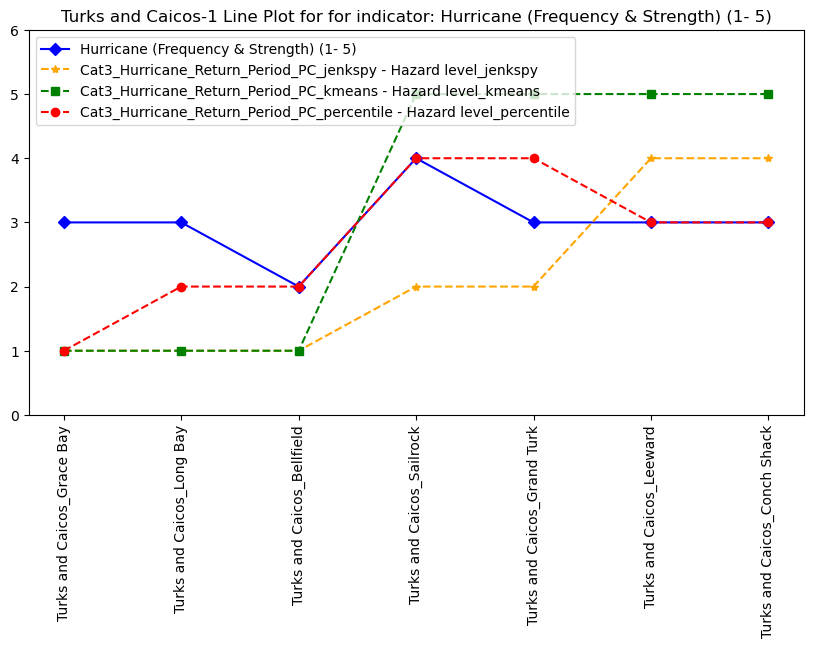

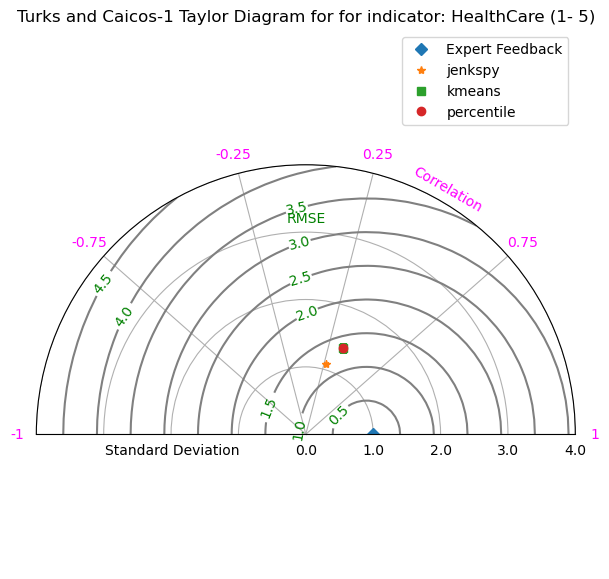

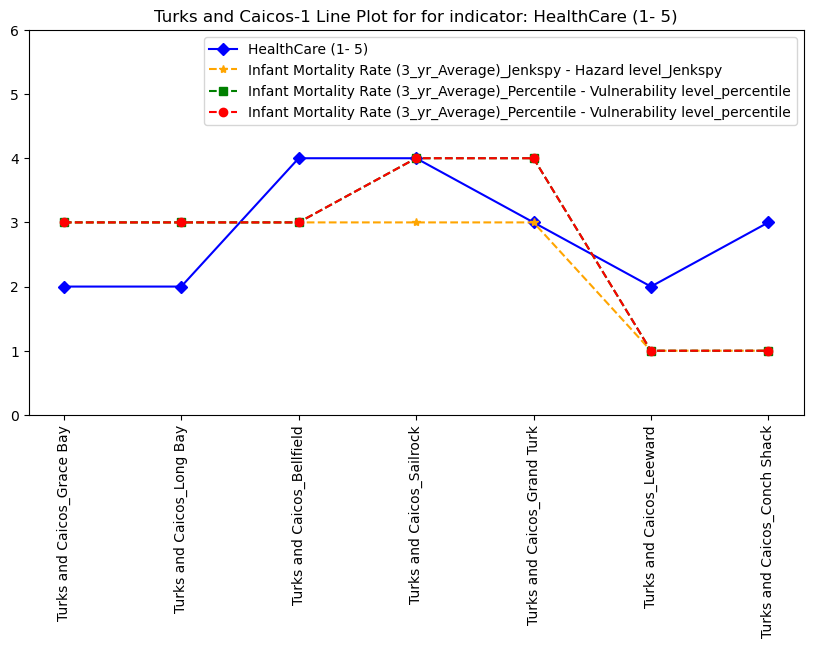

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


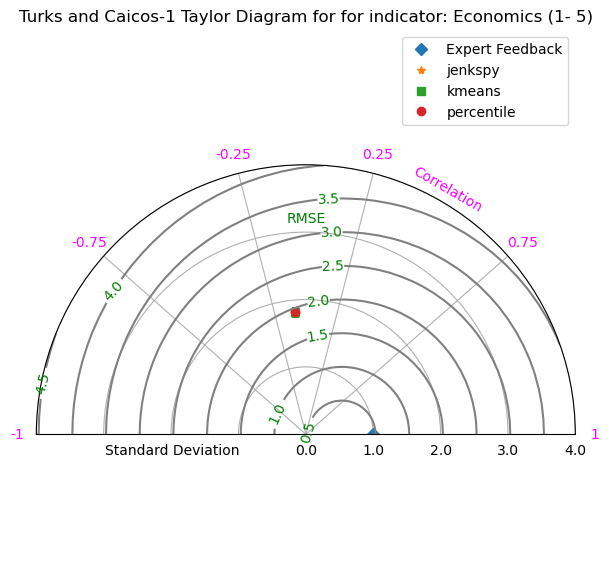

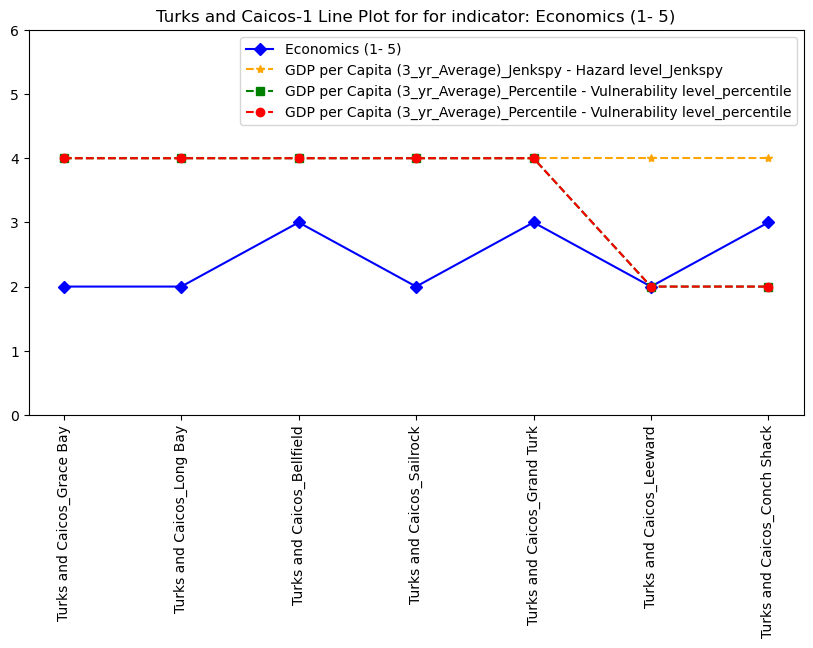

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: divide by zero encountered in scalar divide
  r = stddev / self.refstd


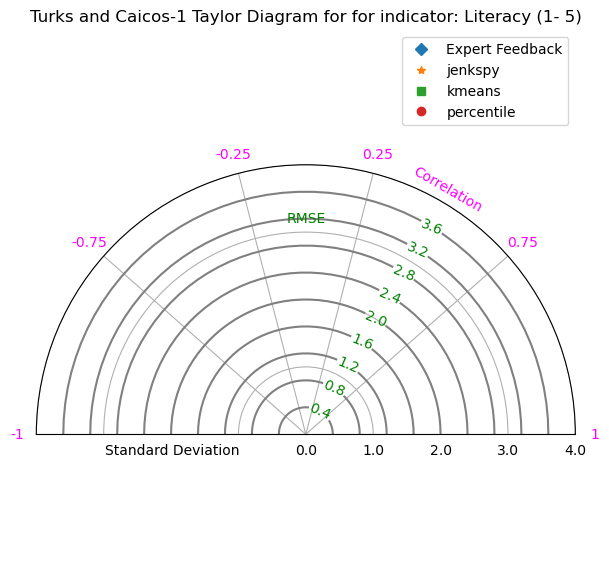

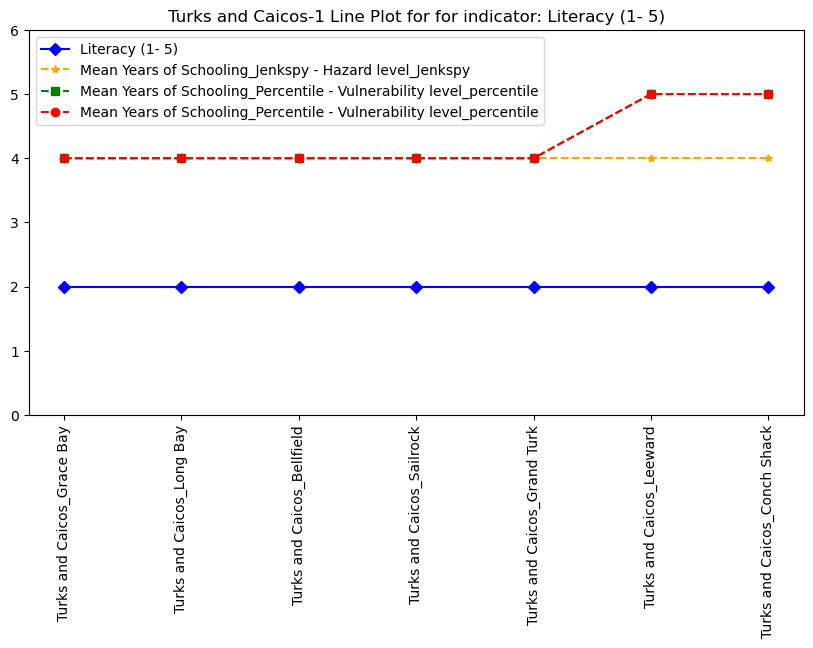

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


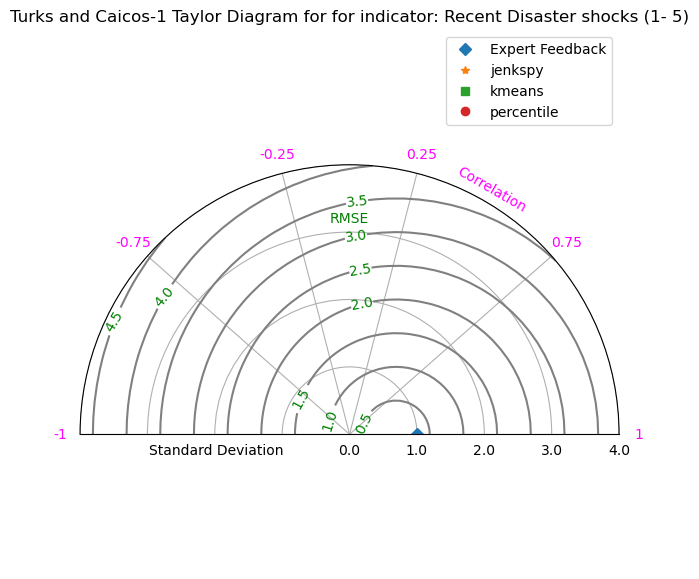

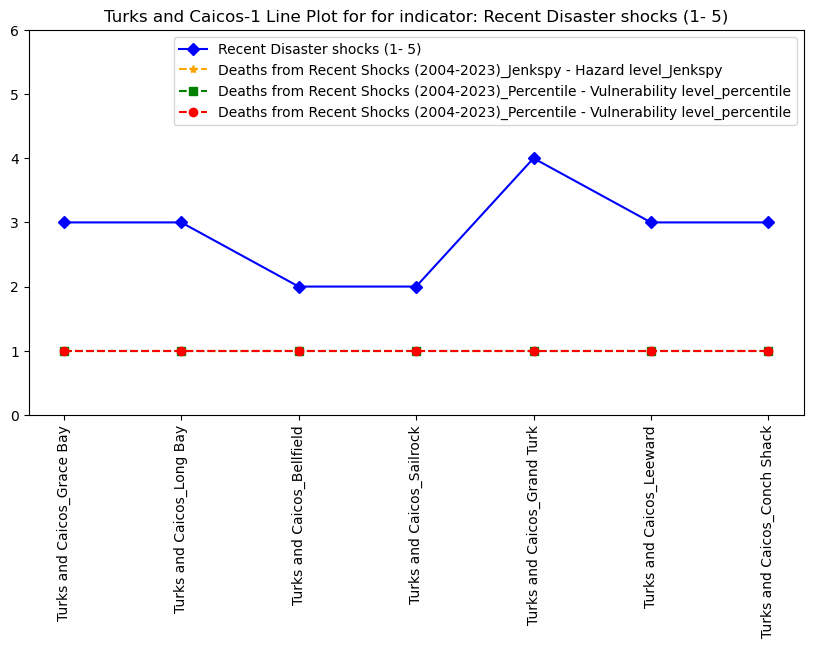

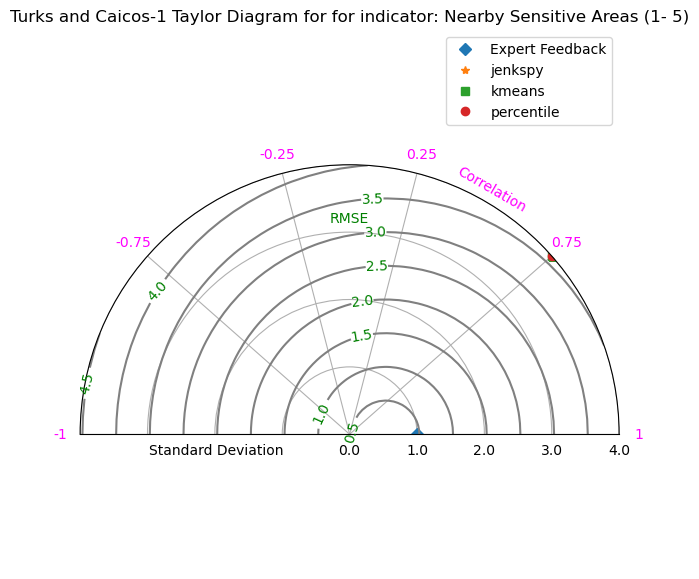

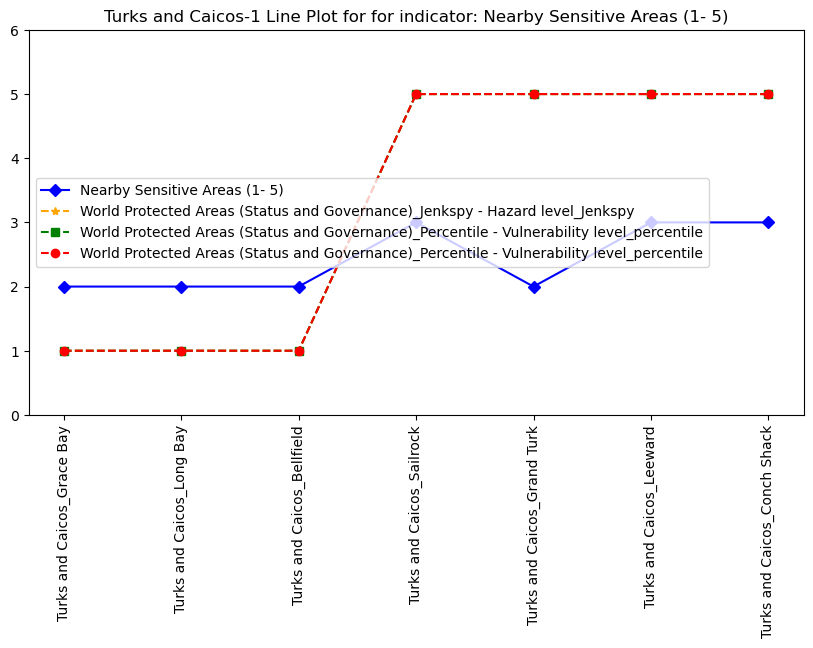

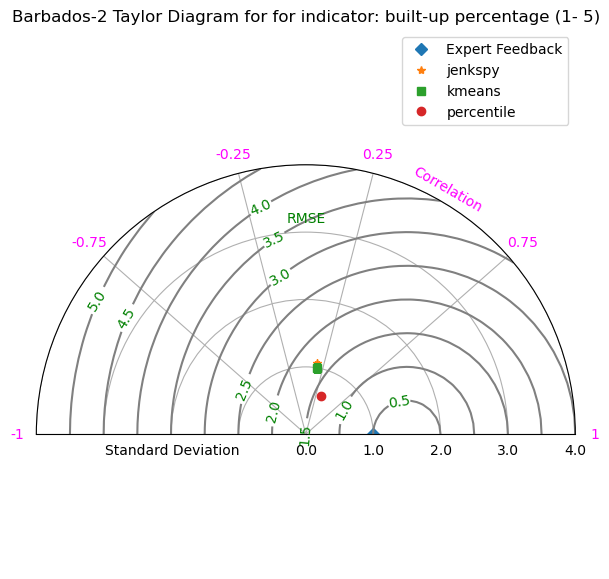

...

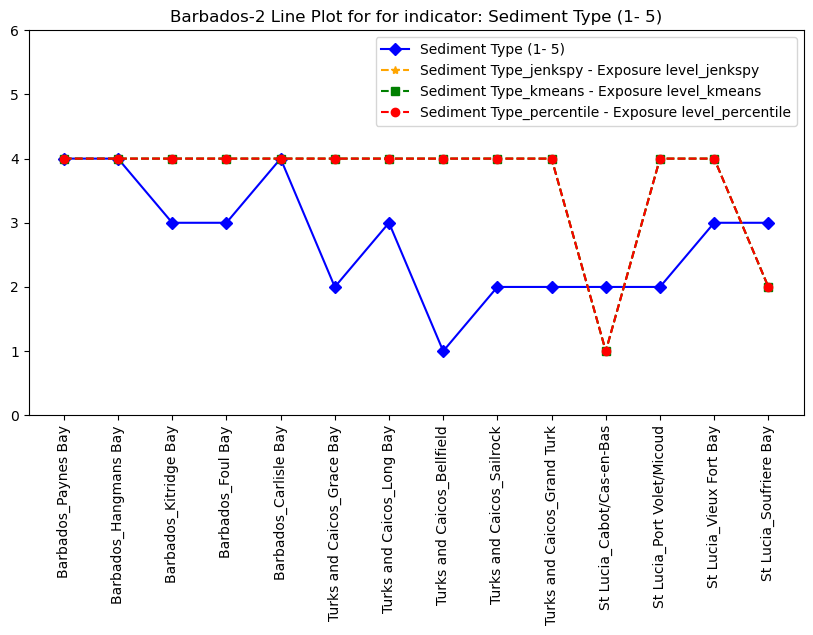

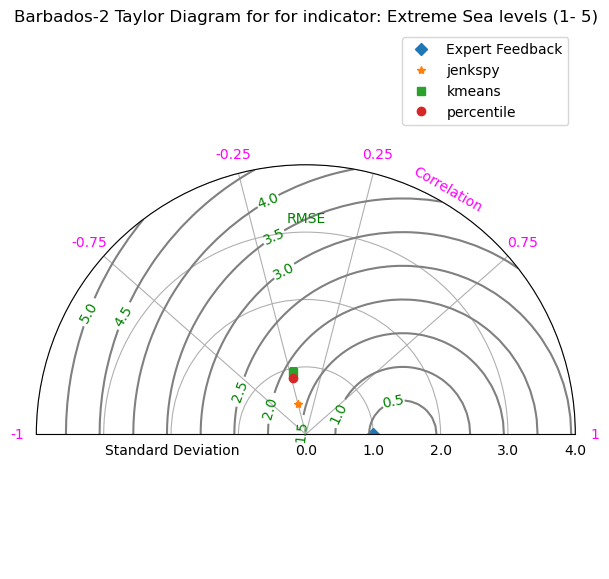

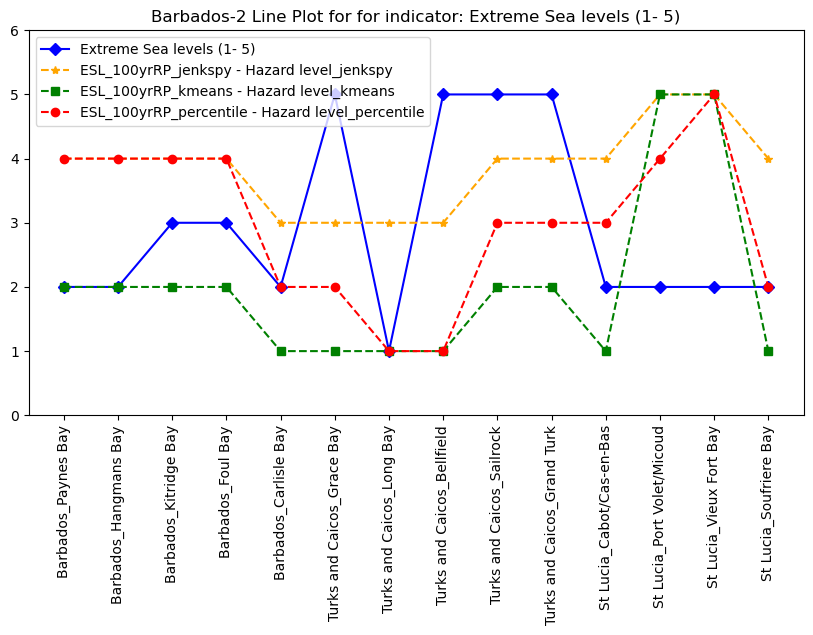

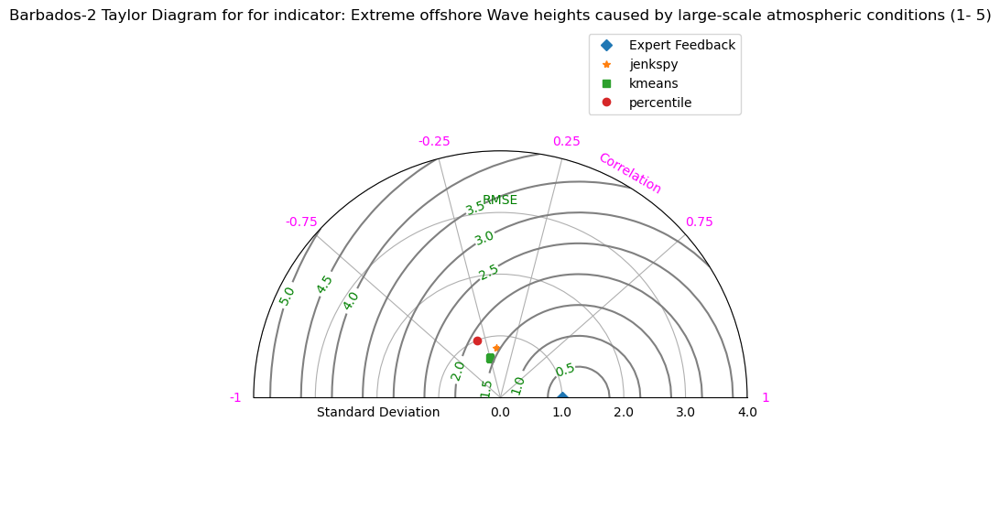

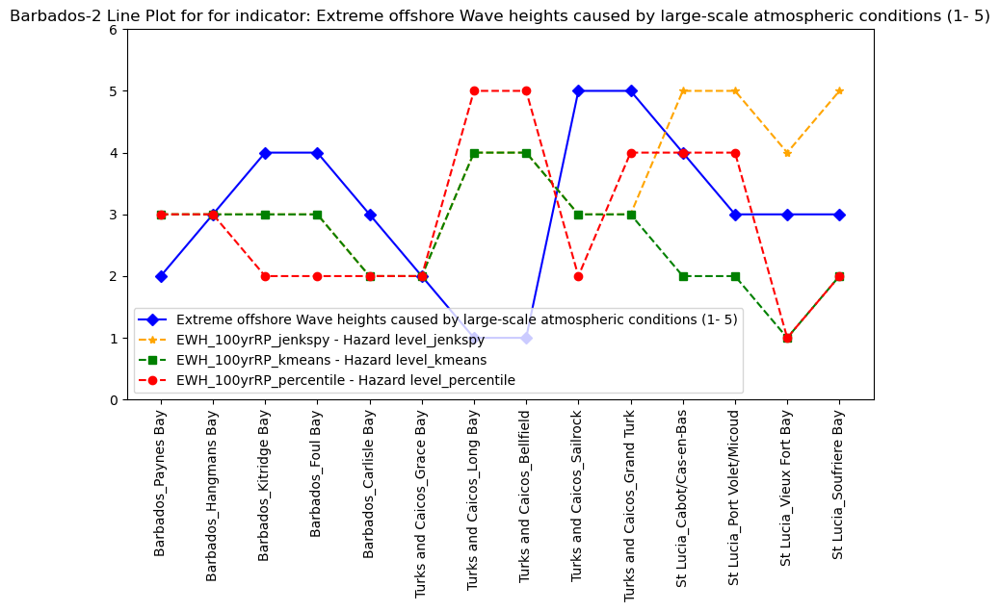

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


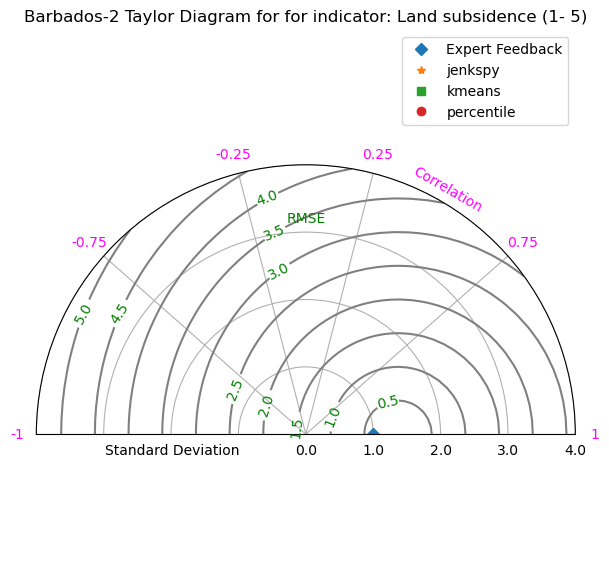

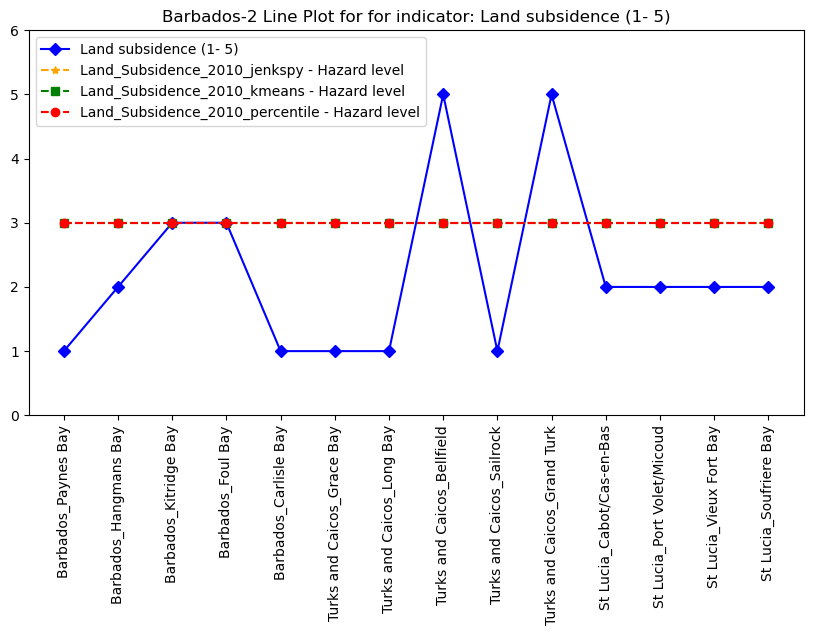

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


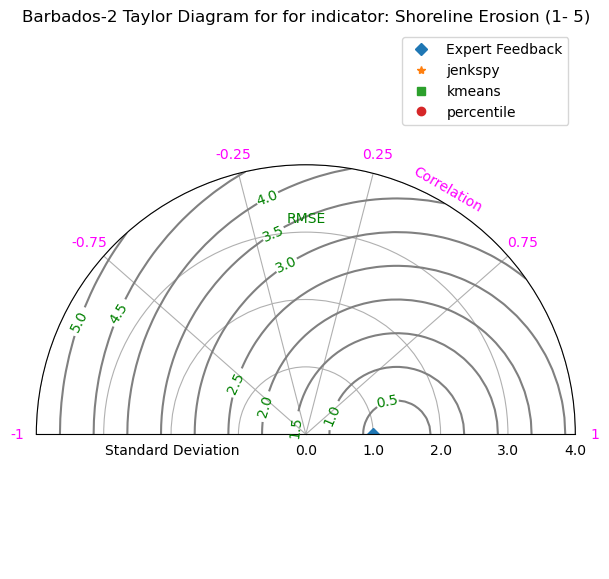

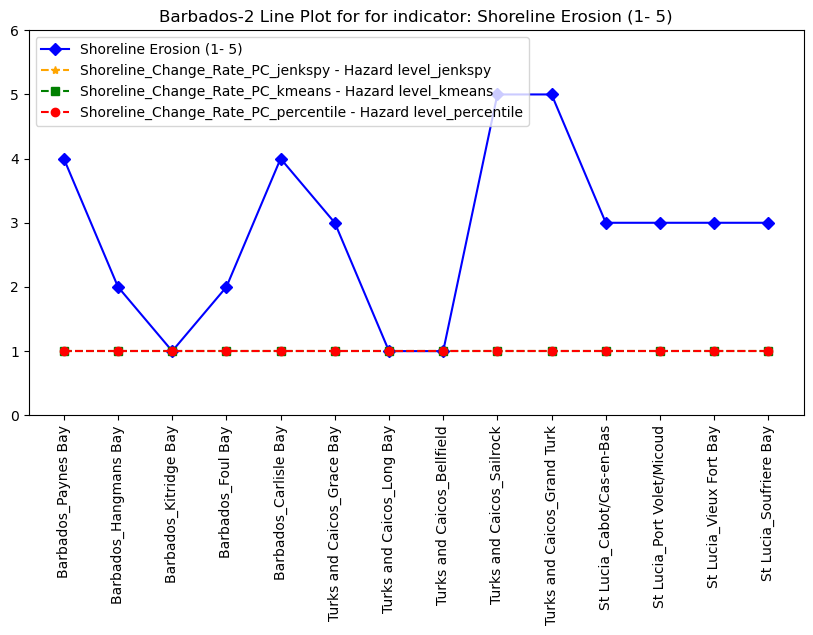

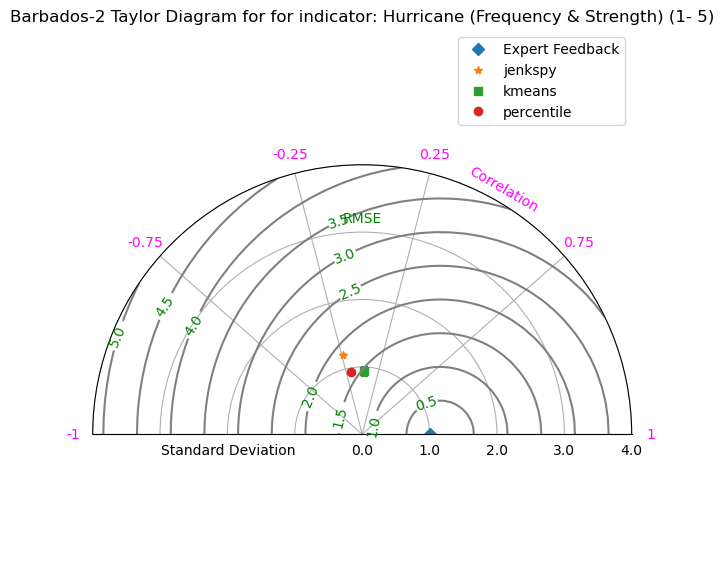

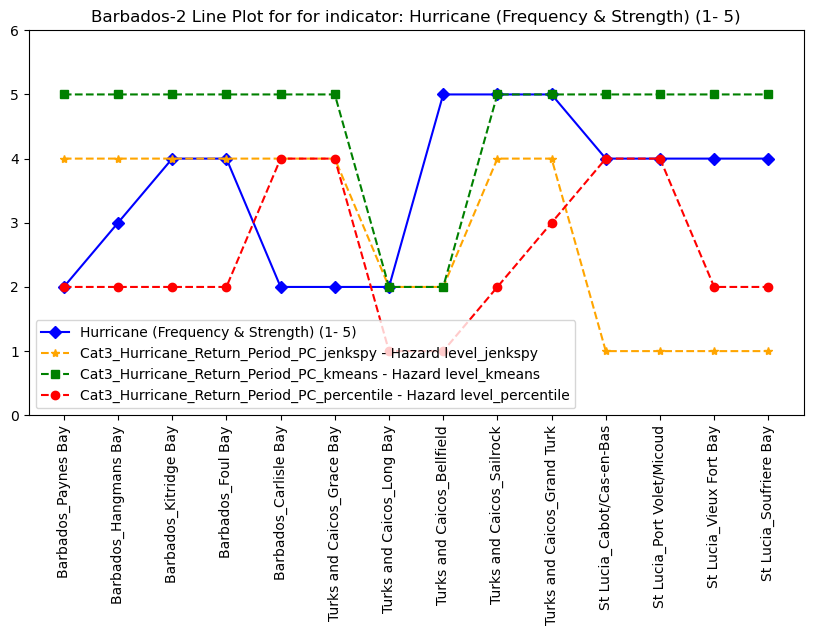

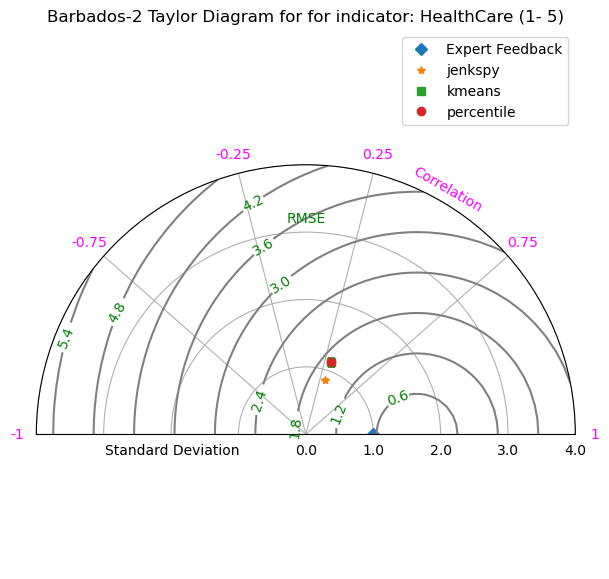

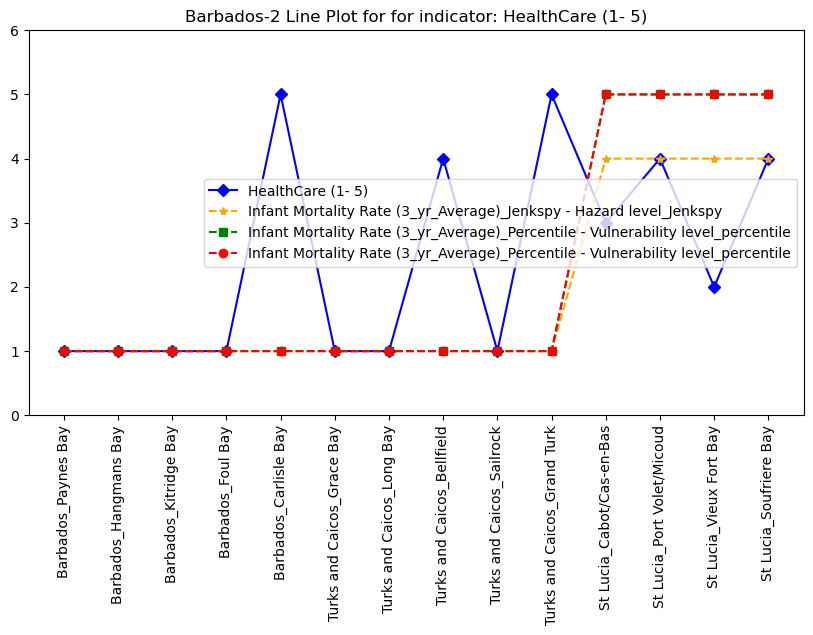

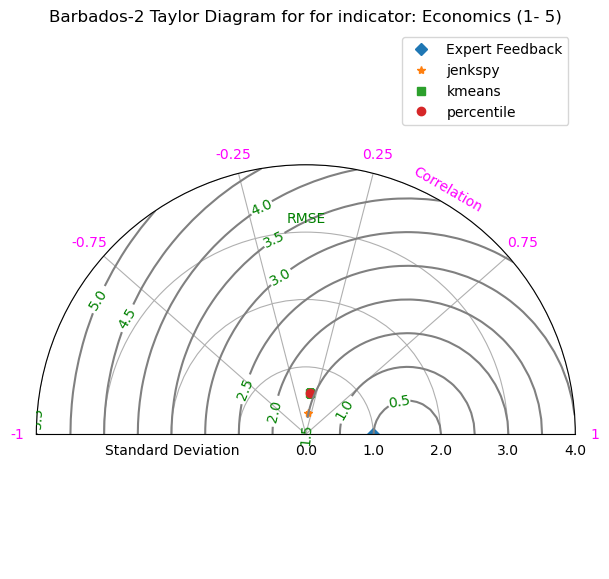

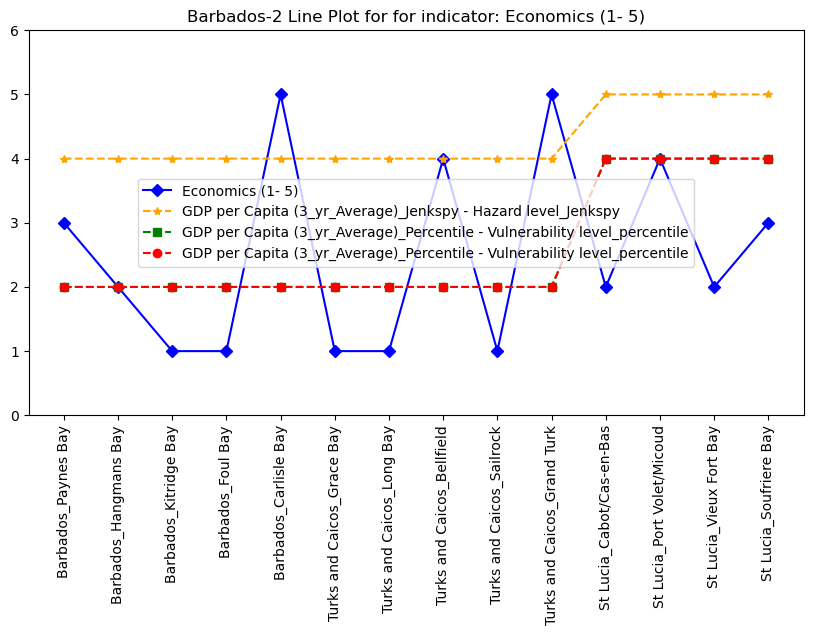

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


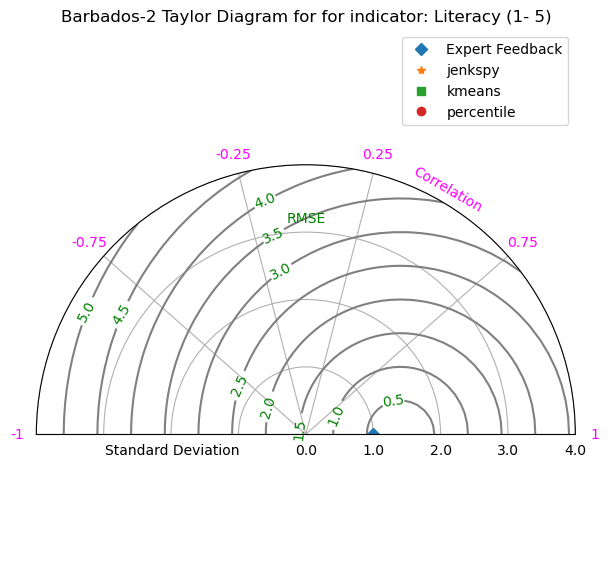

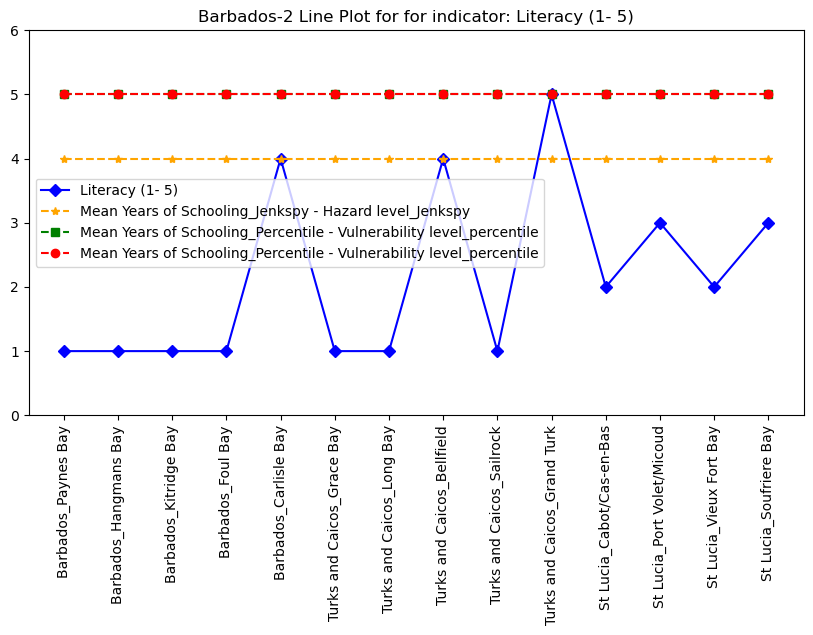

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


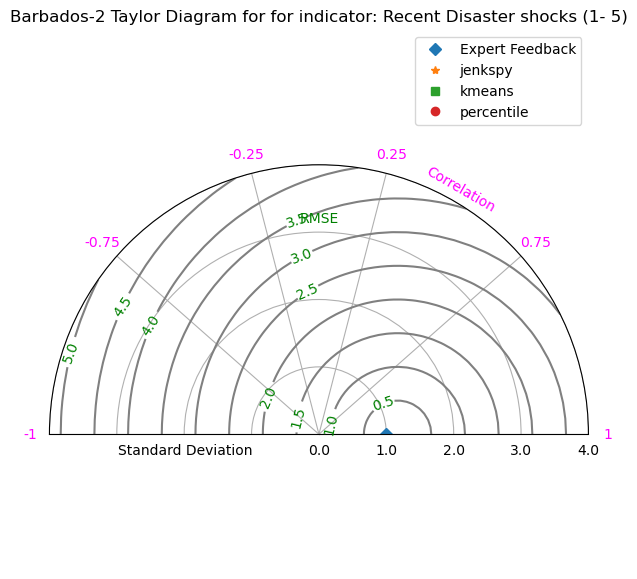

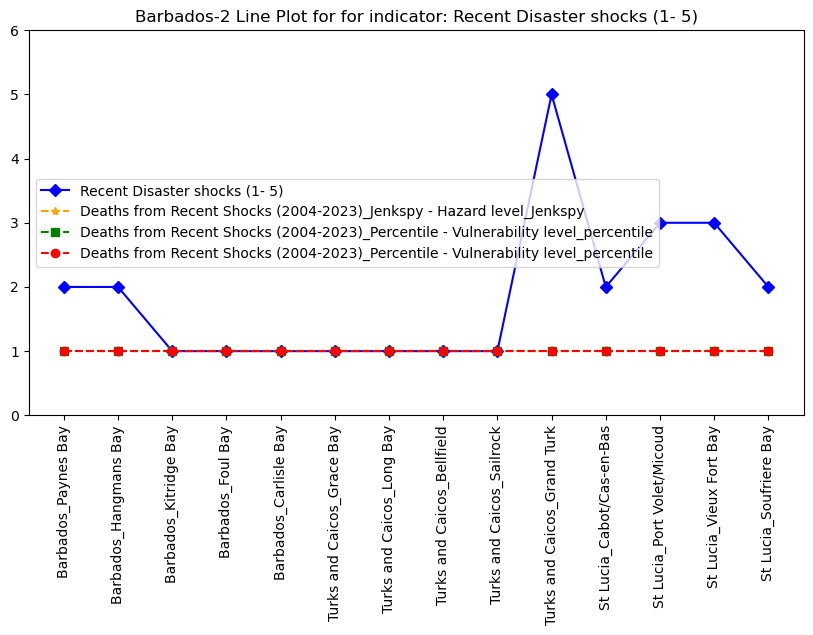

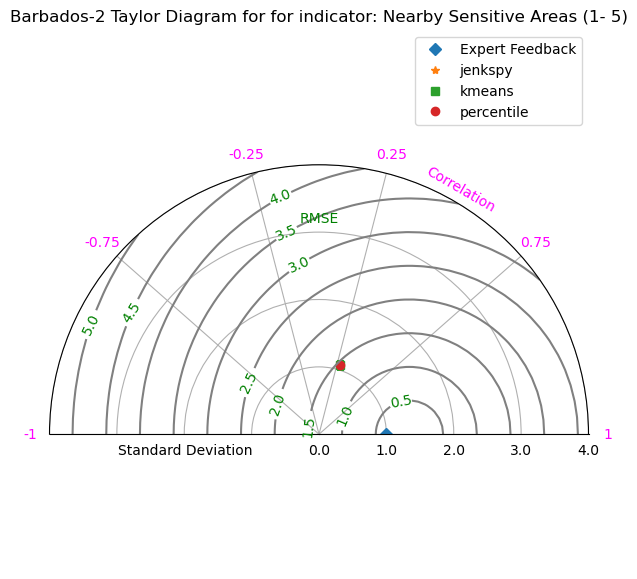

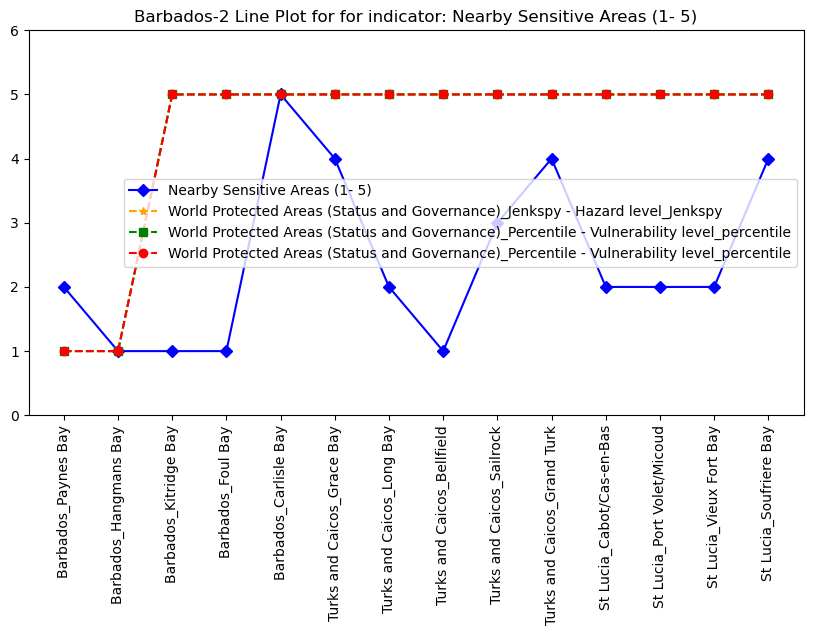

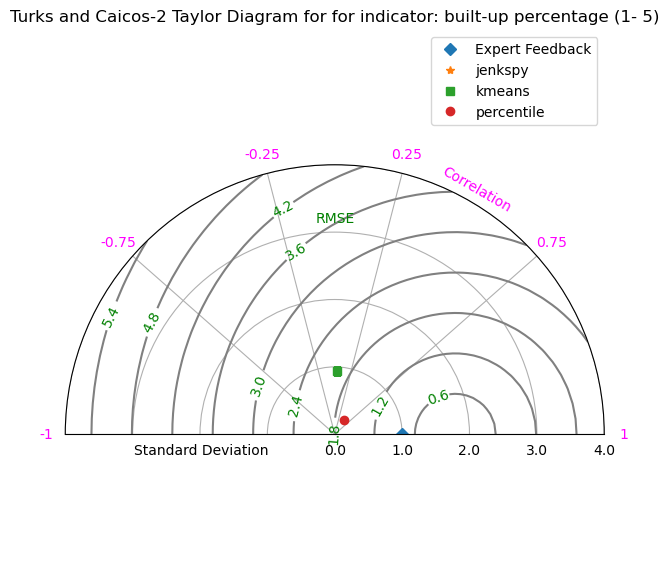

...

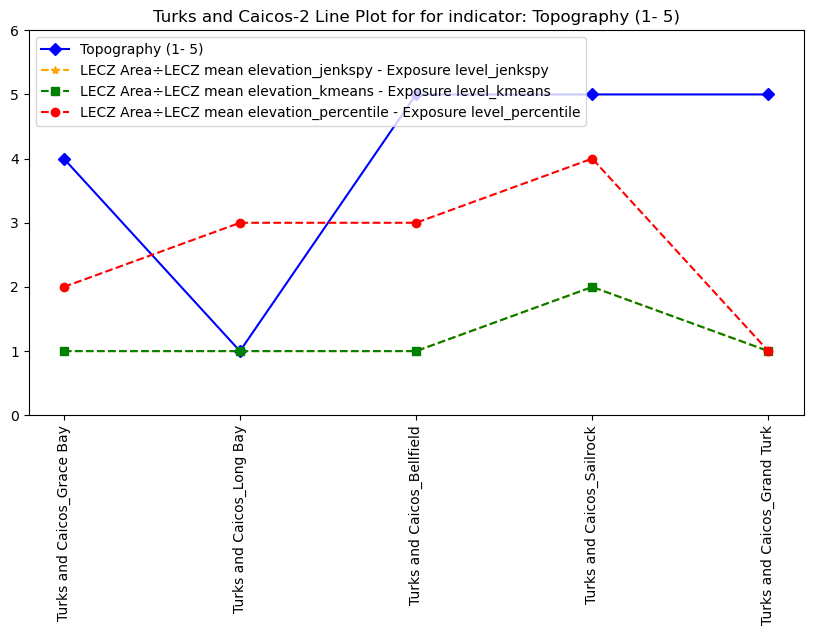

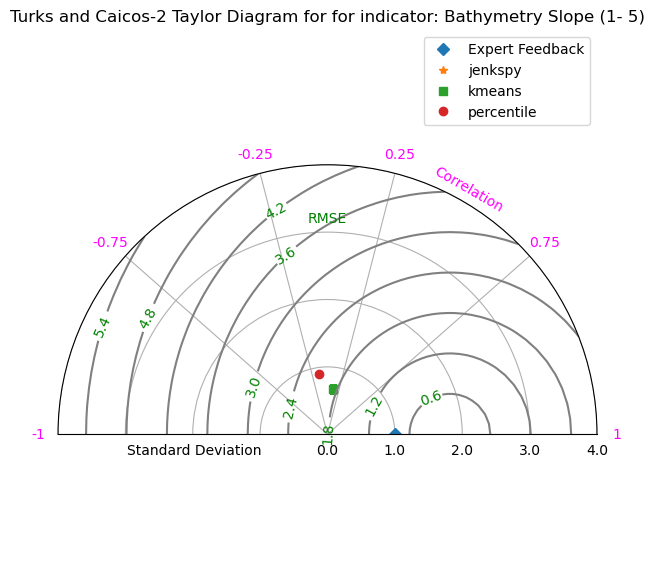

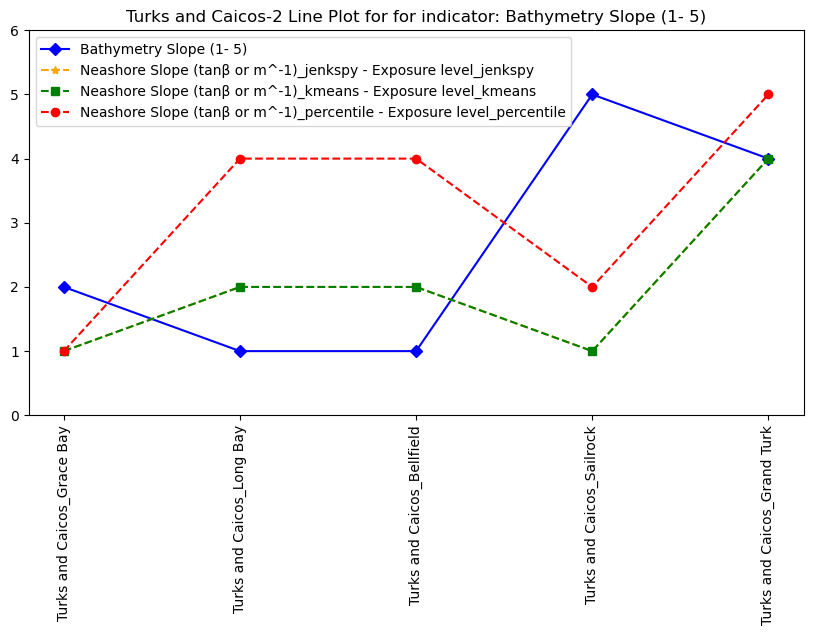

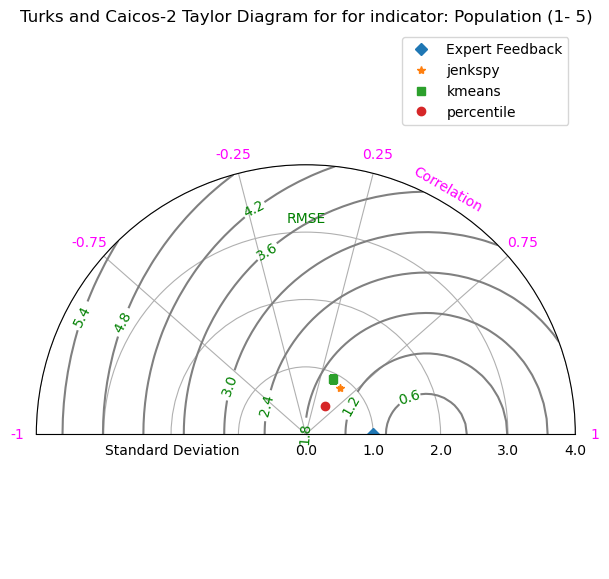

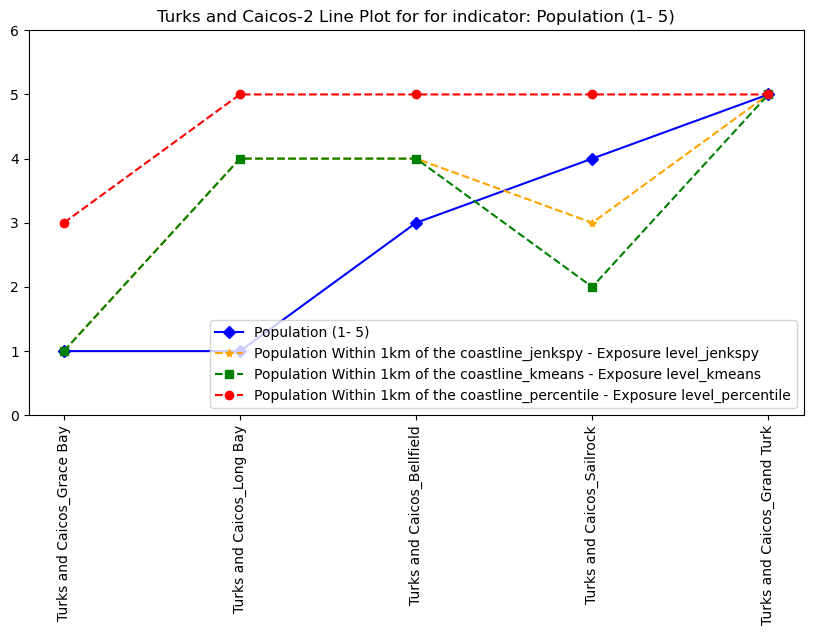

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


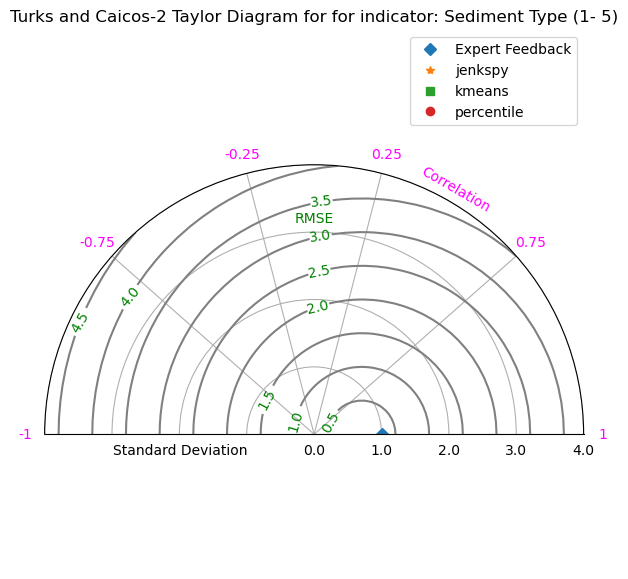

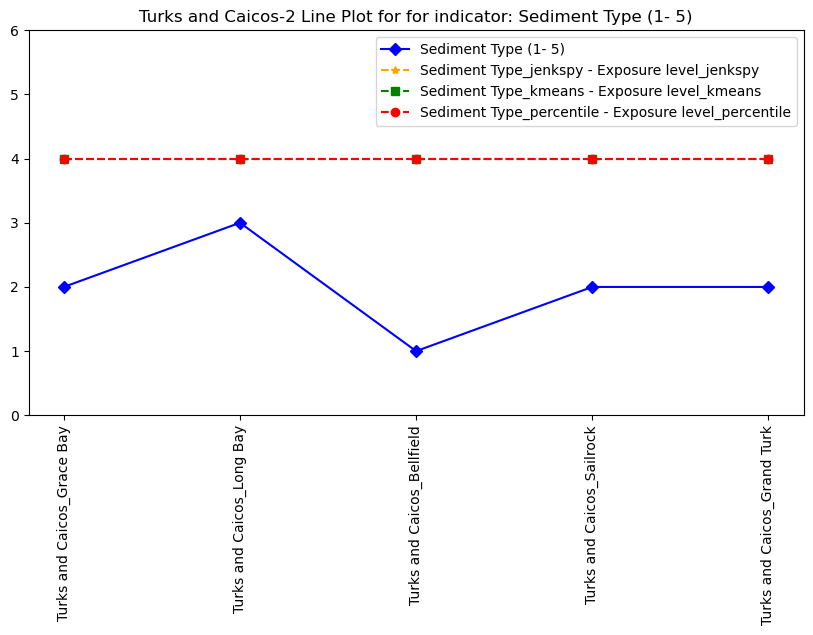

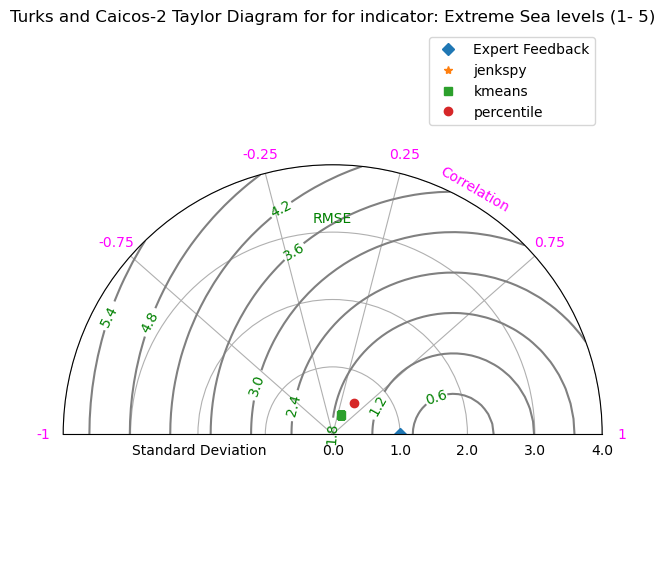

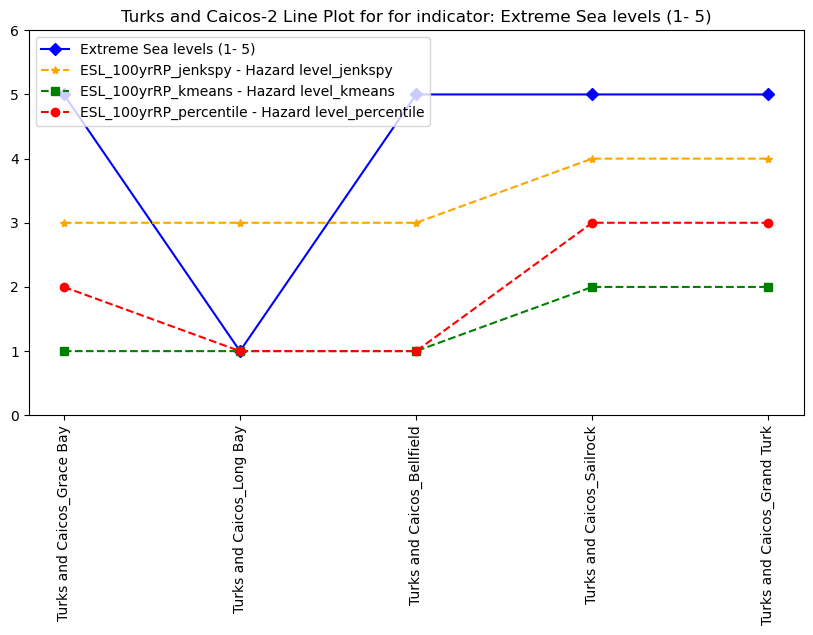

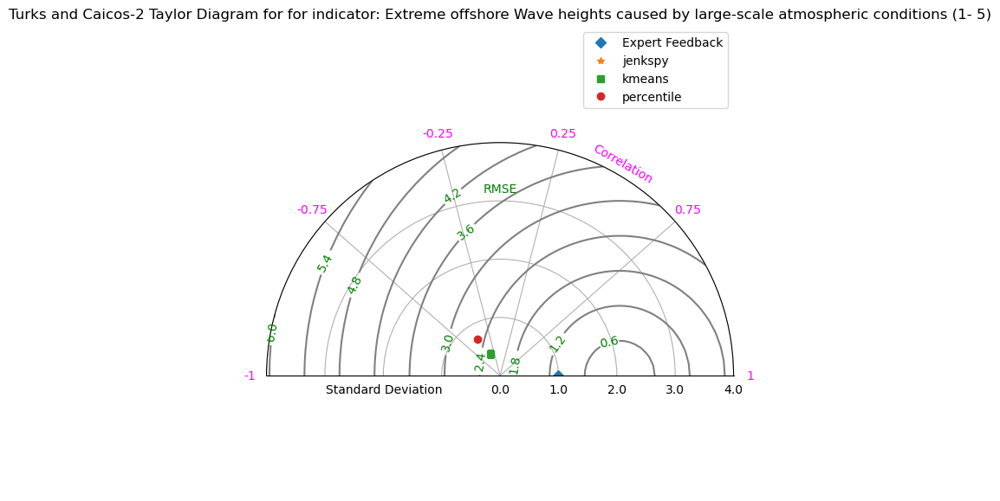

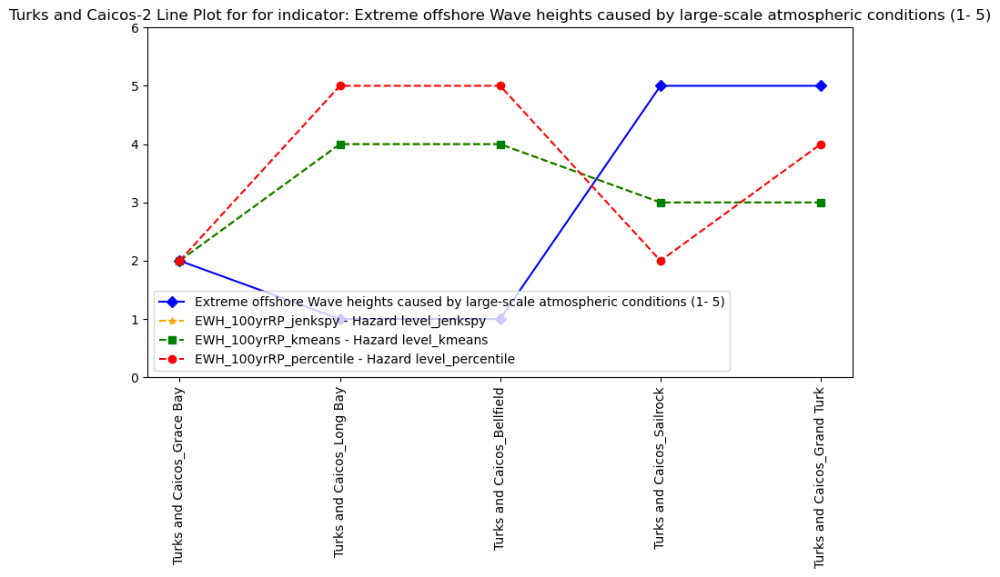

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


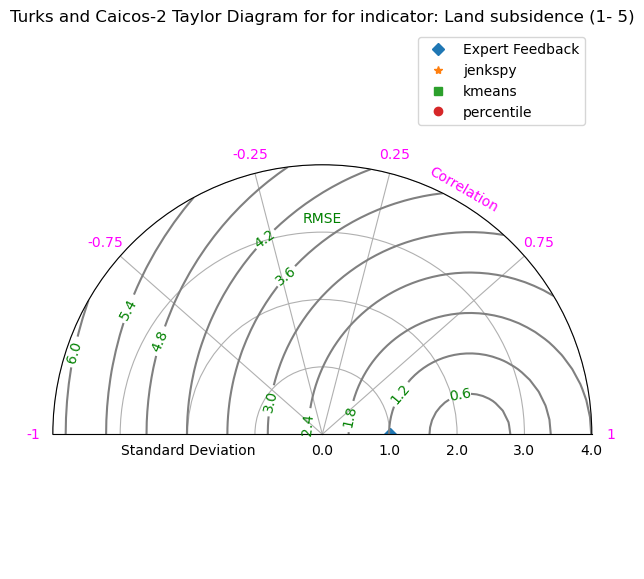

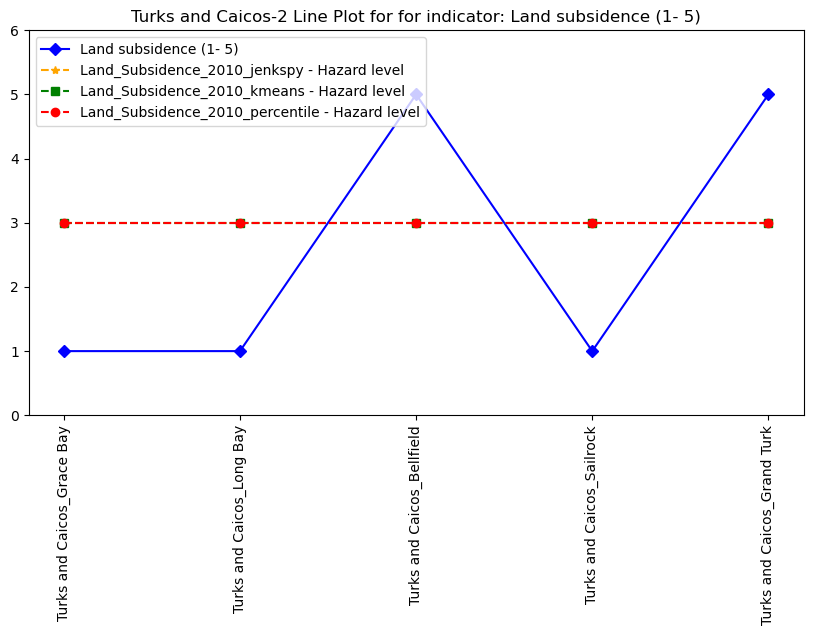

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


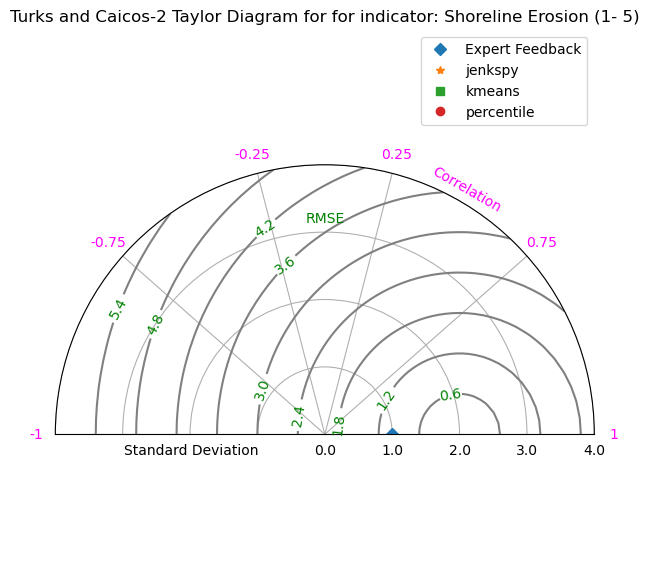

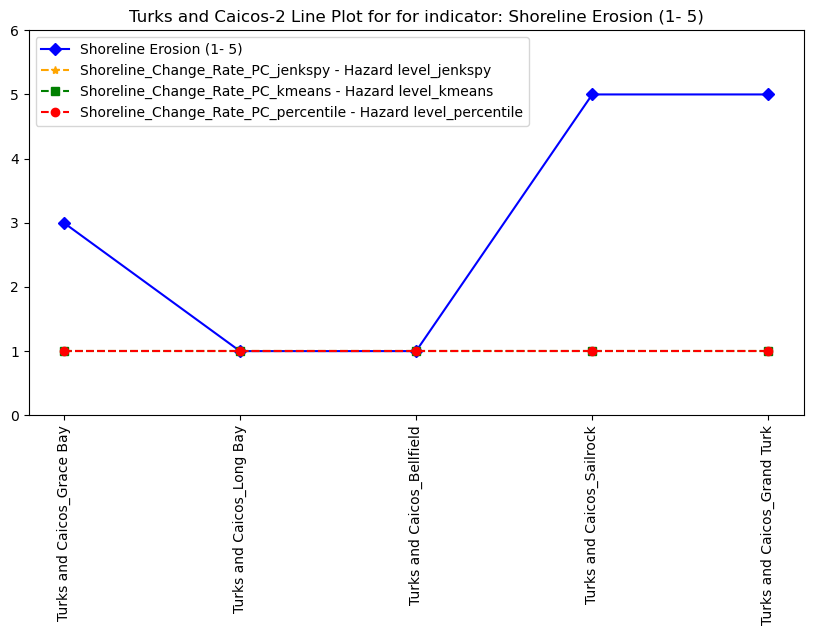

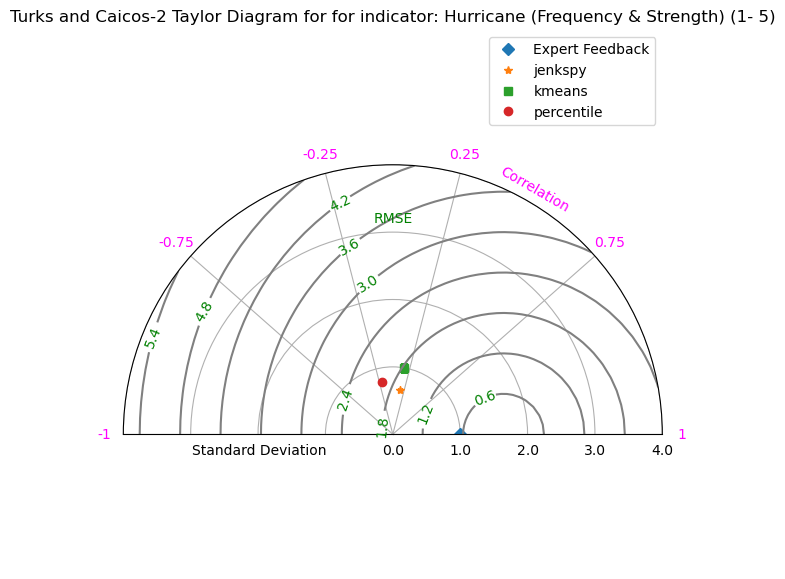

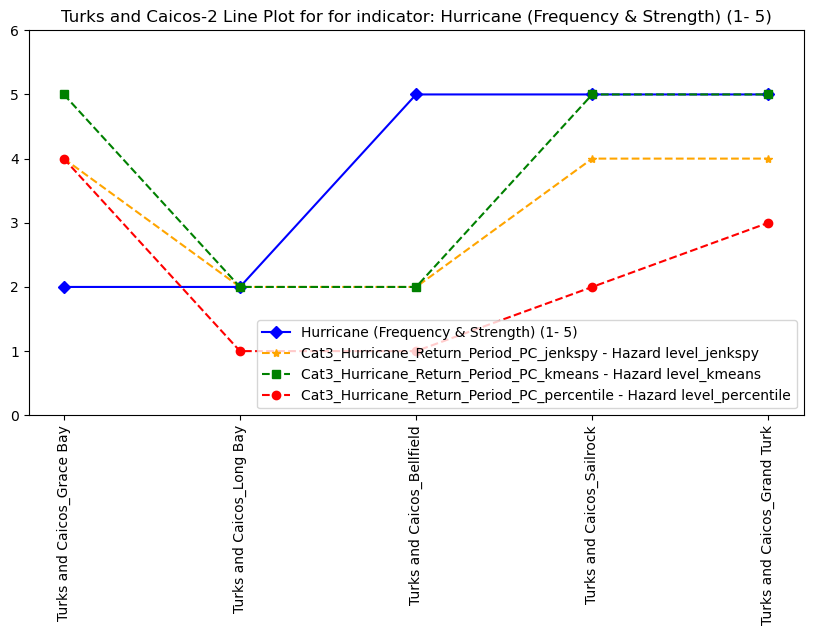

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


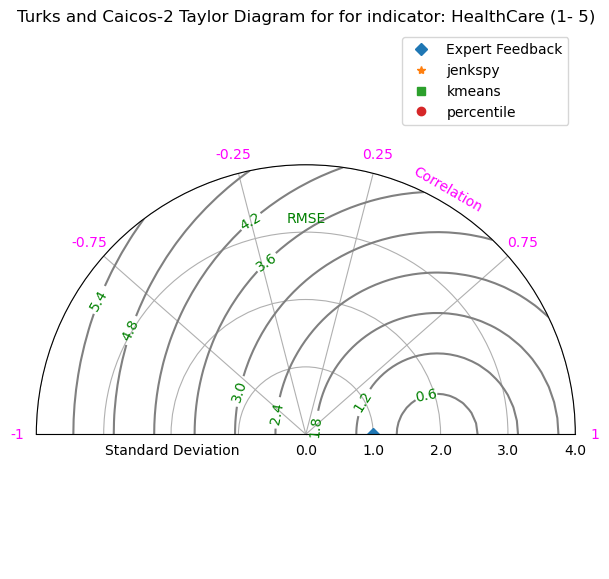

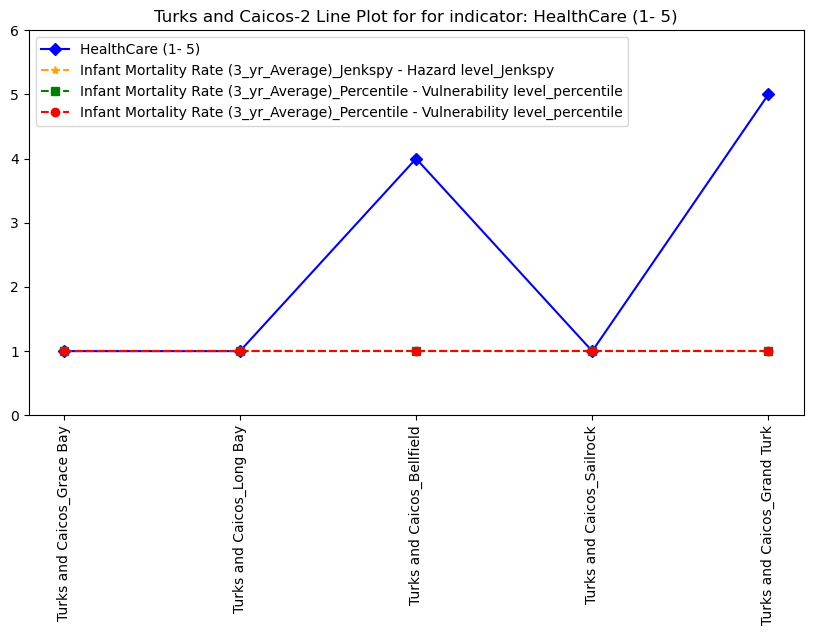

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


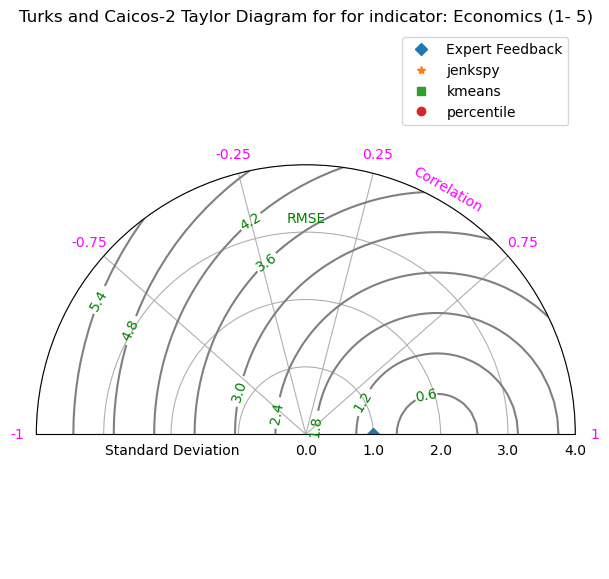

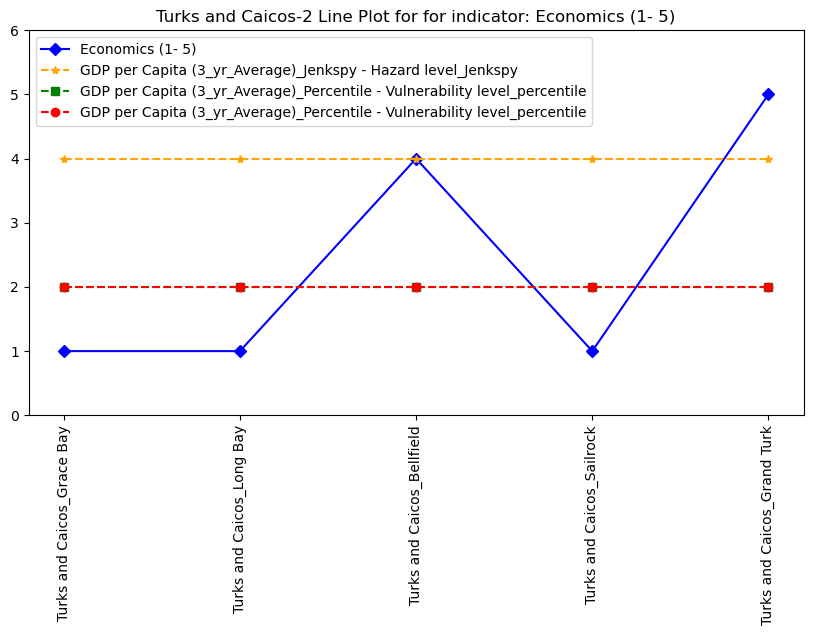

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


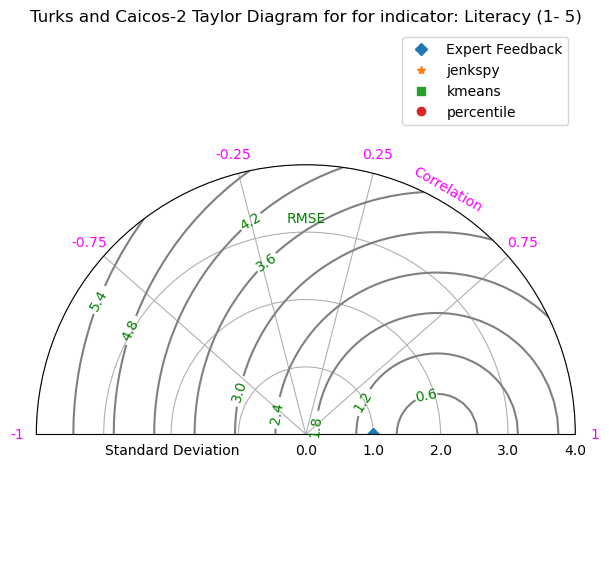

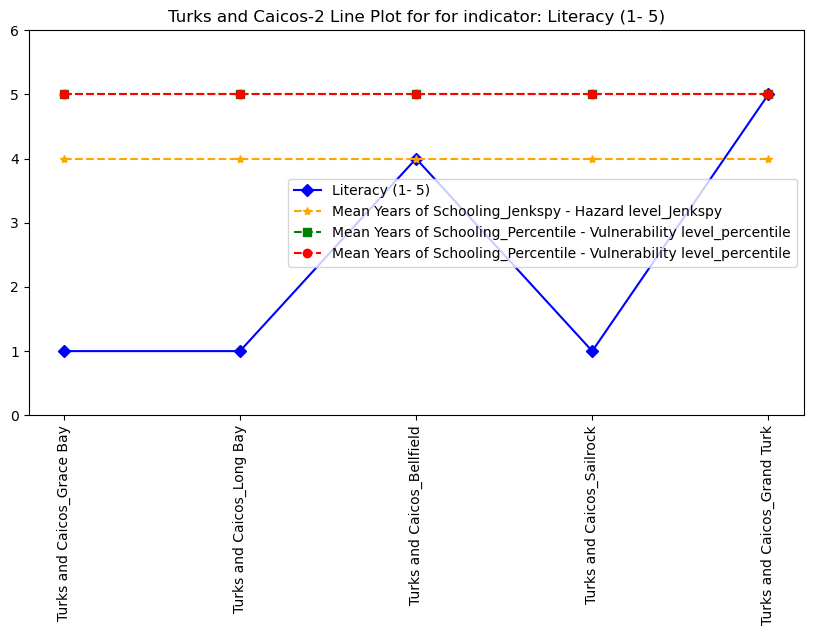

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


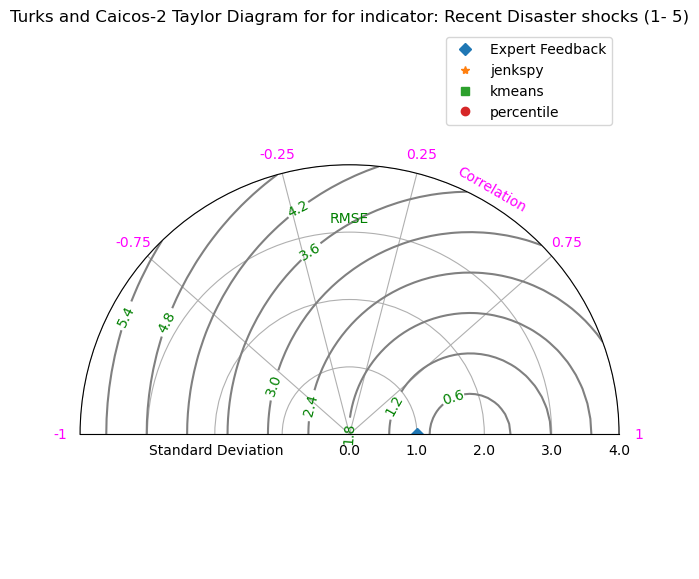

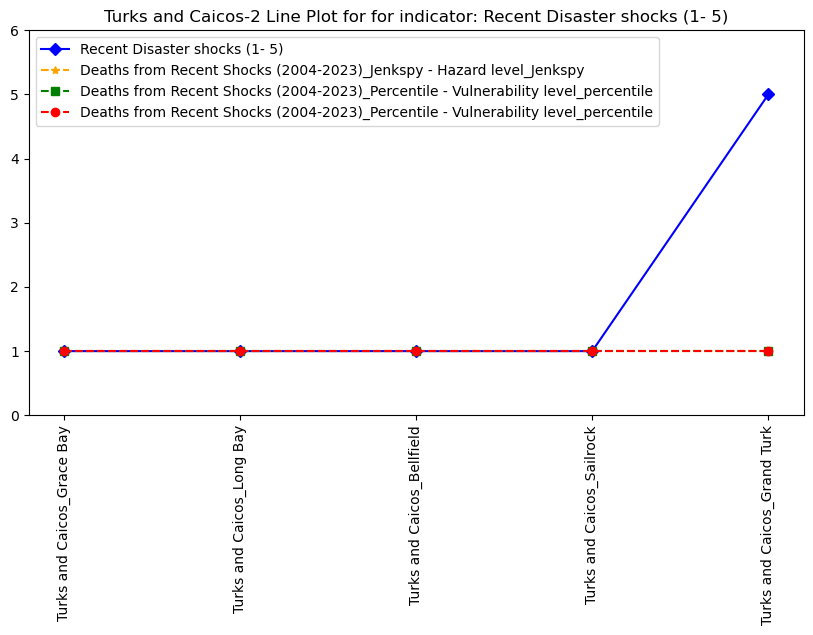

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


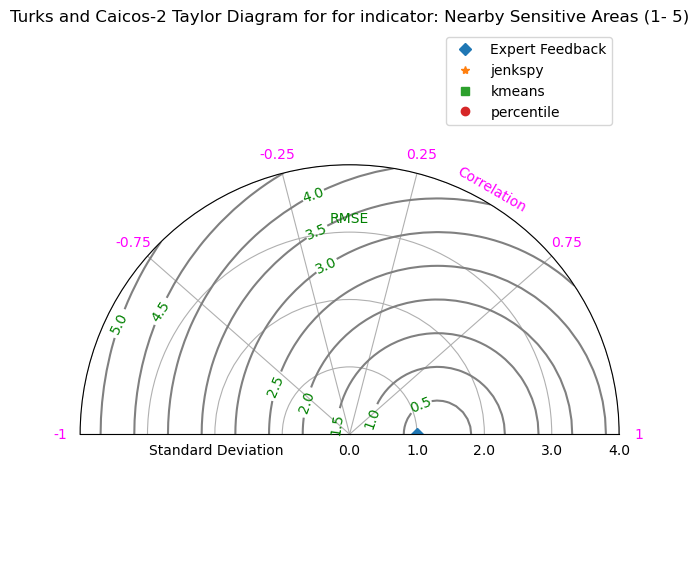

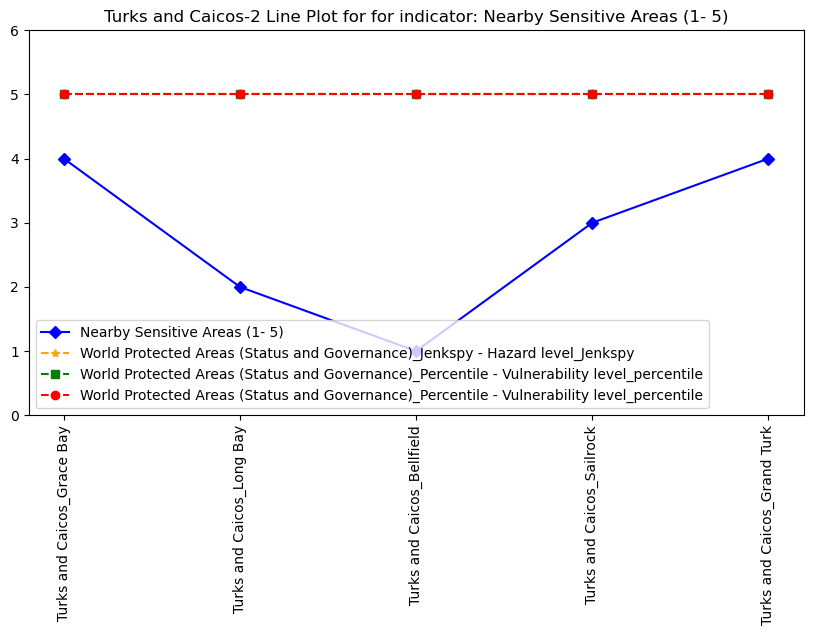

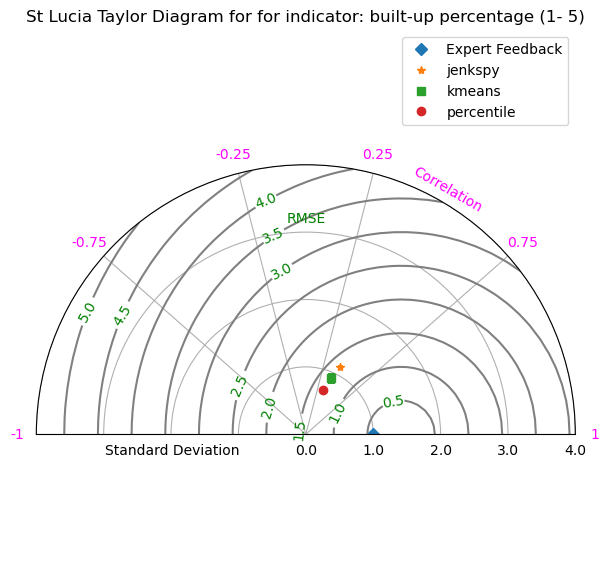

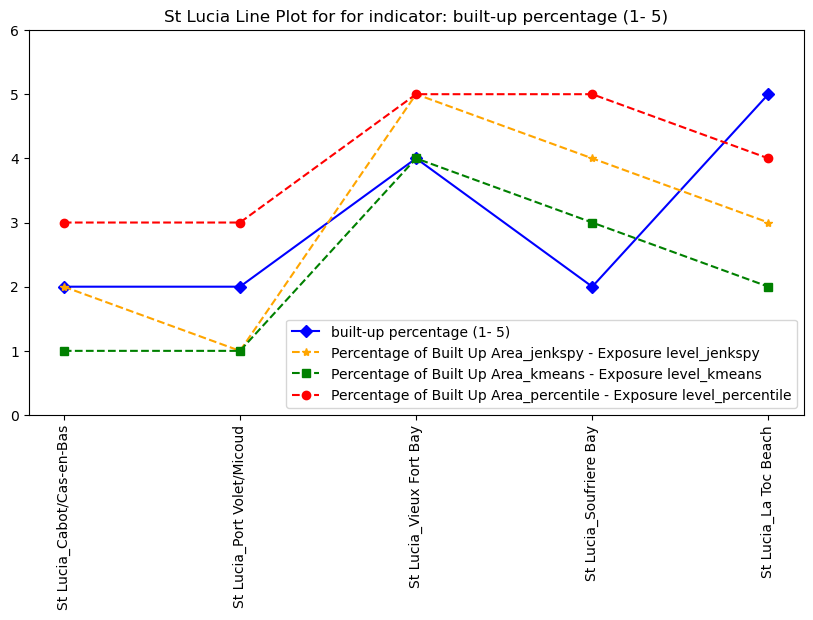

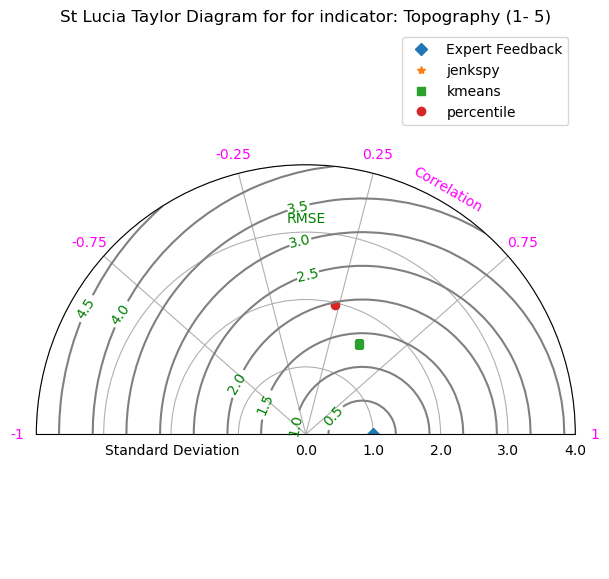

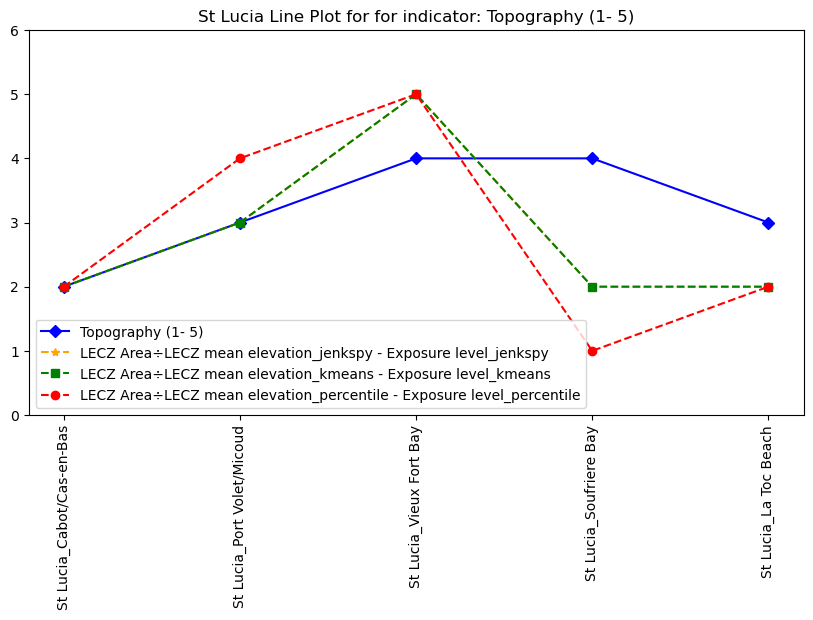

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


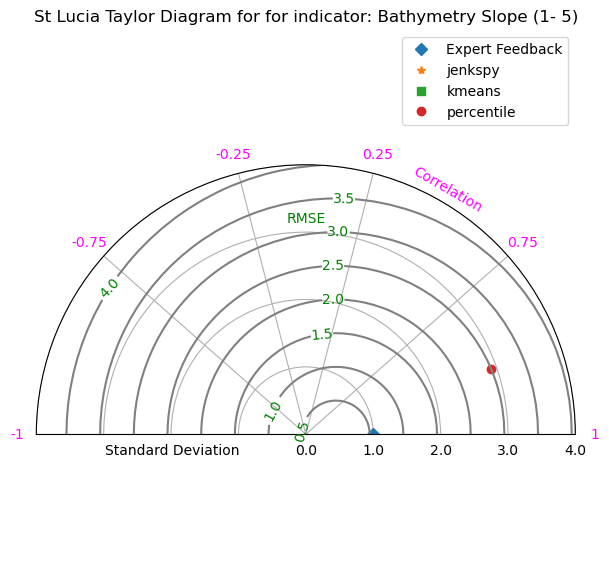

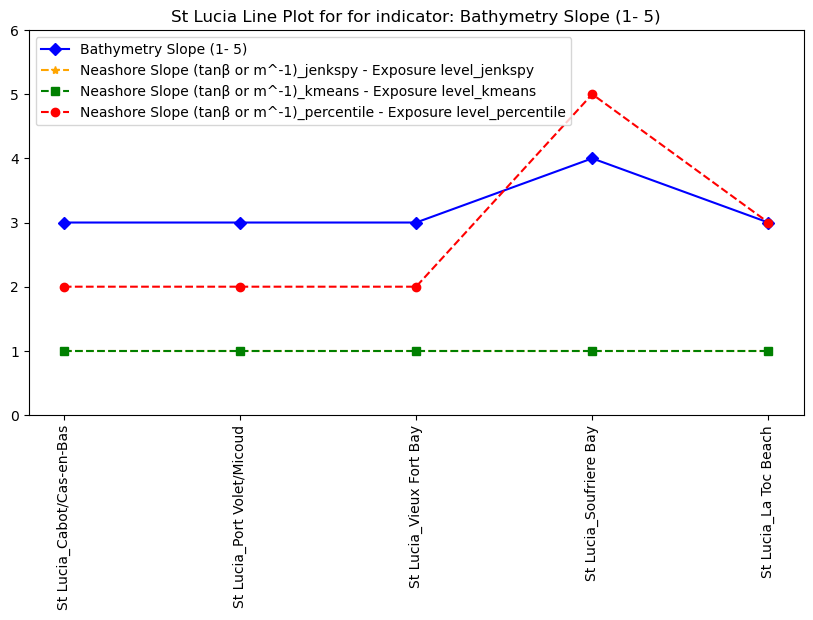

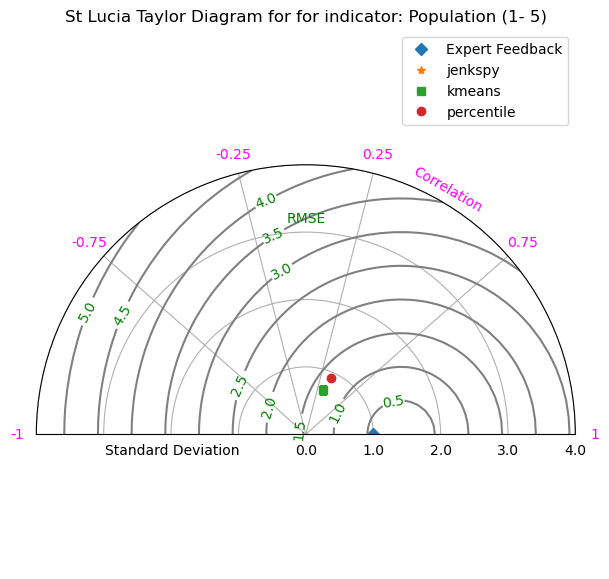

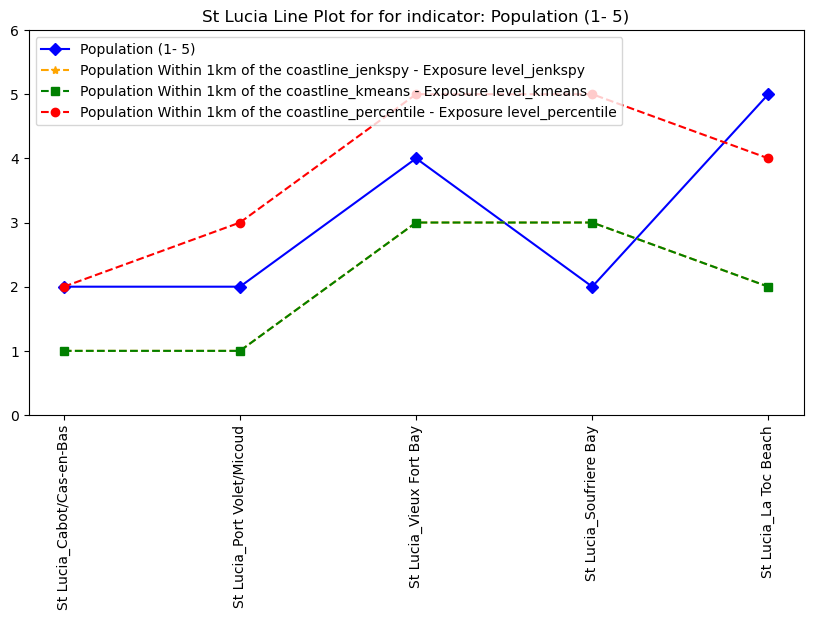

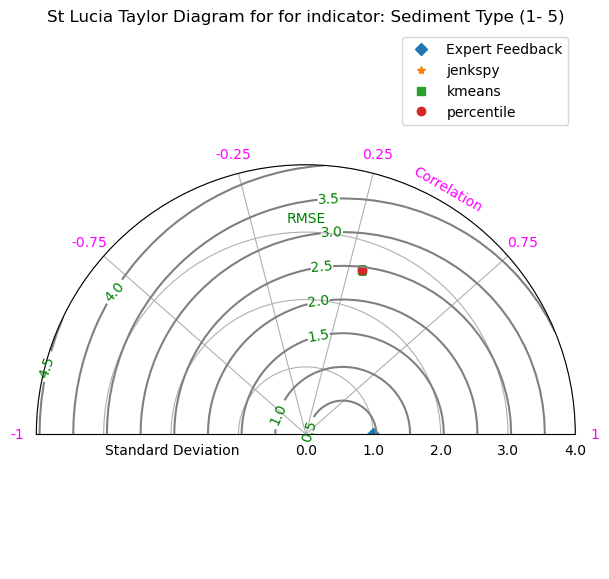

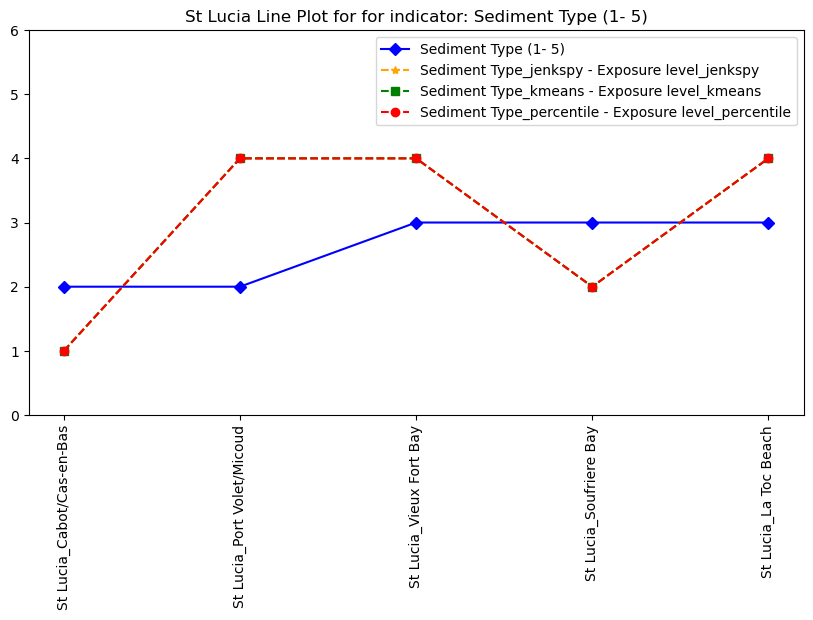

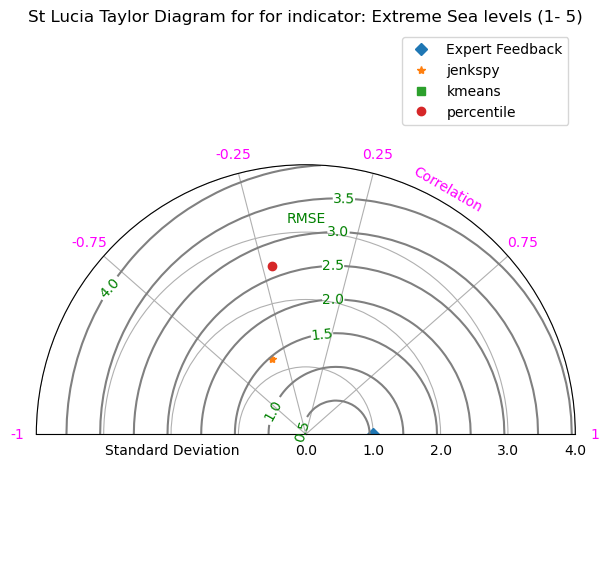

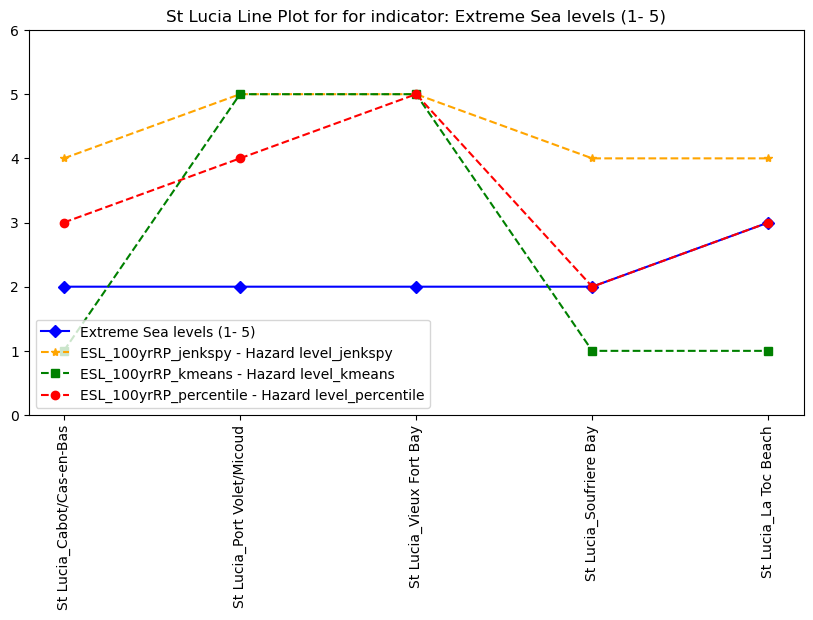

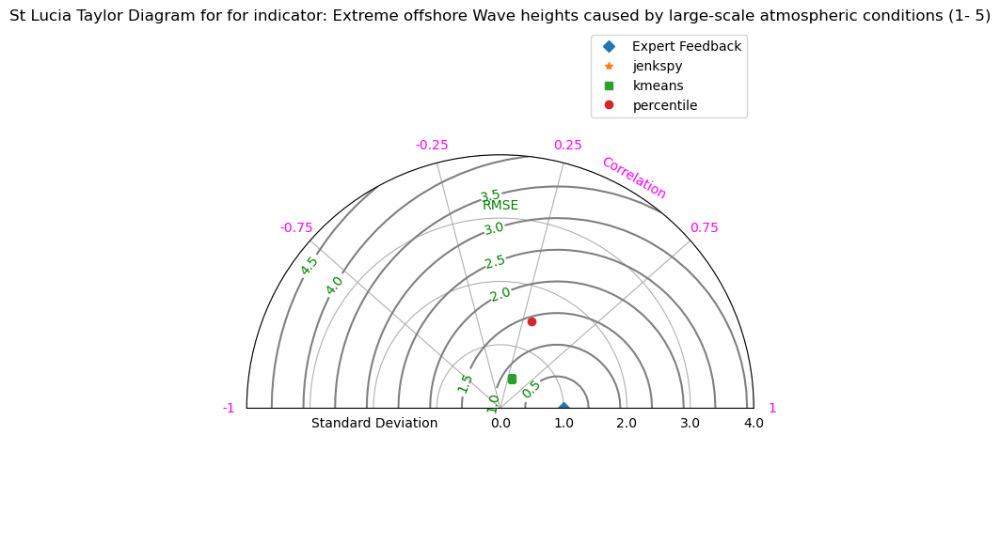

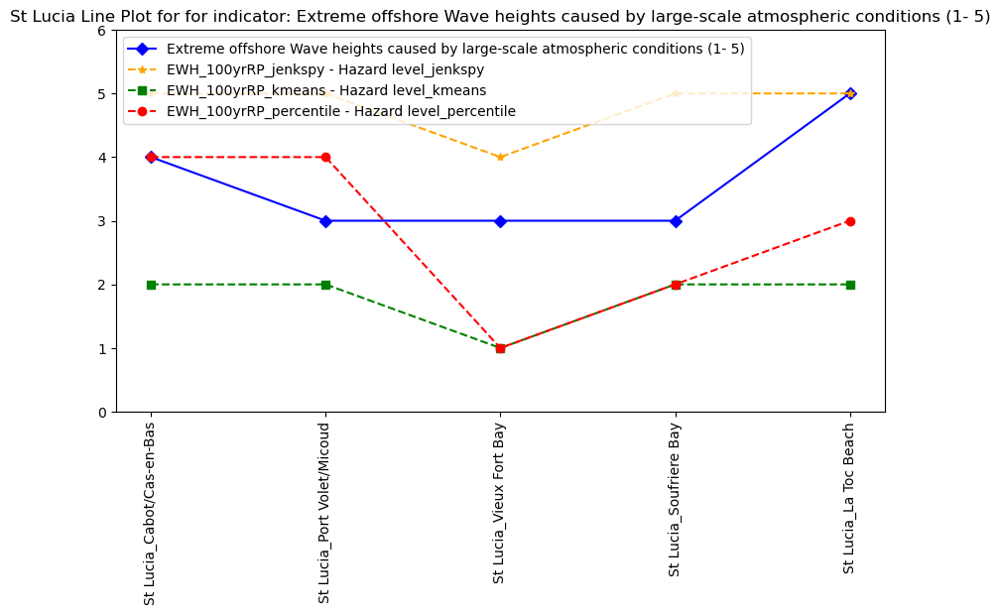

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd


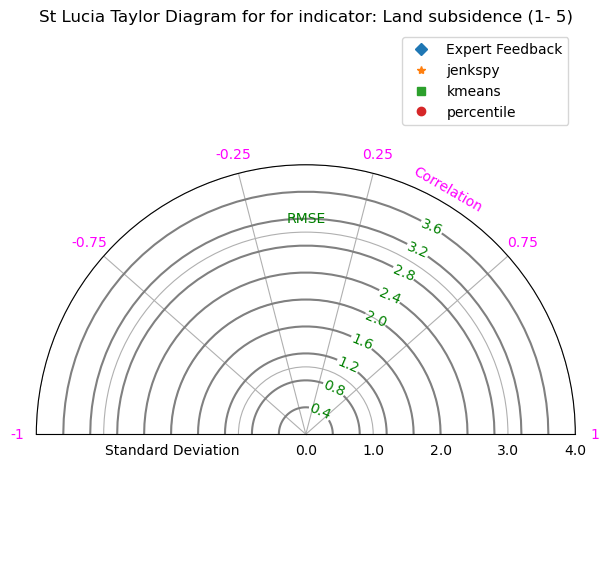

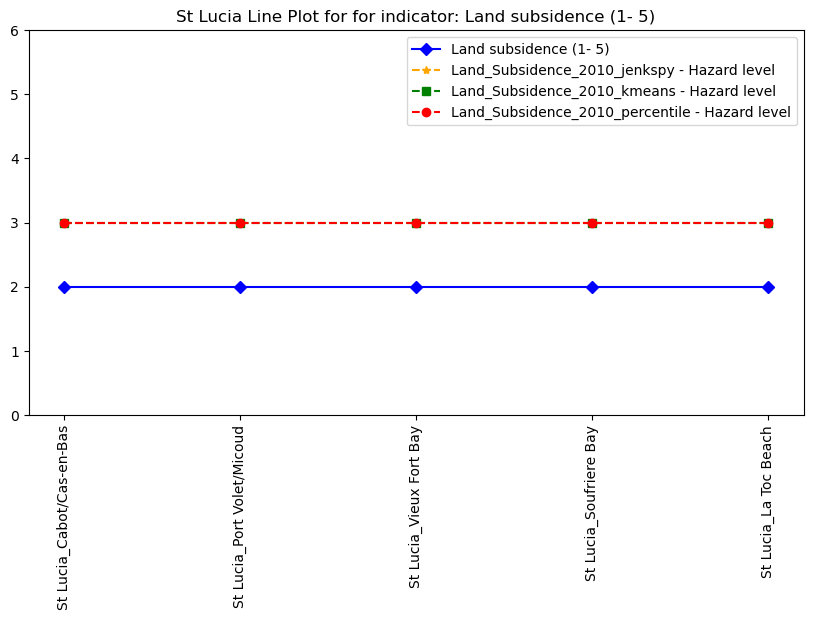

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


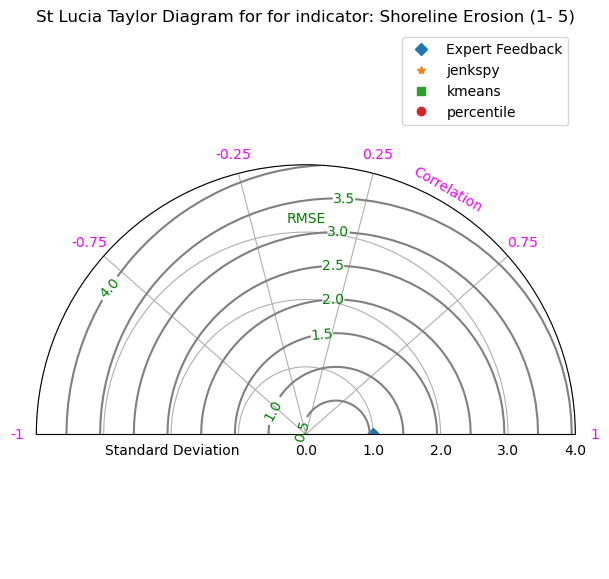

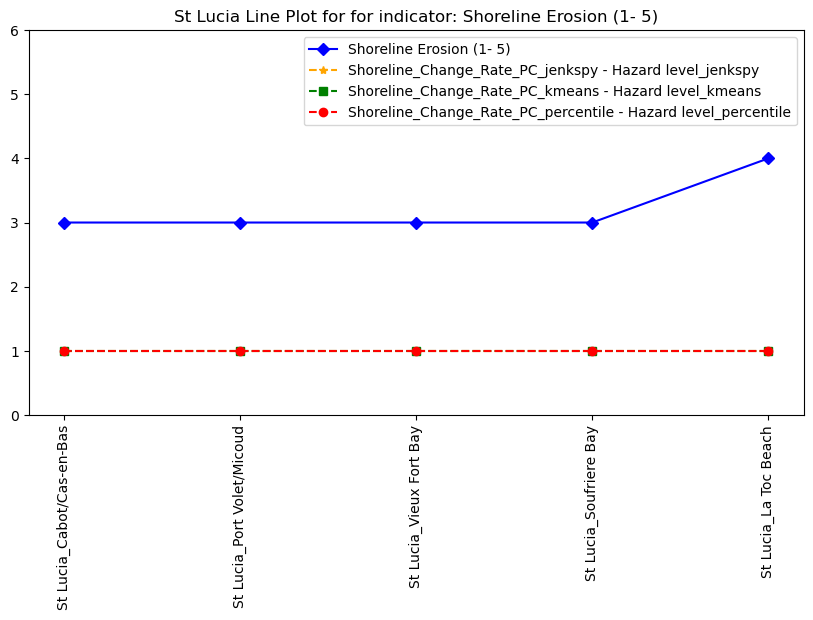

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: divide by zero encountered in scalar divide
  r = stddev / self.refstd


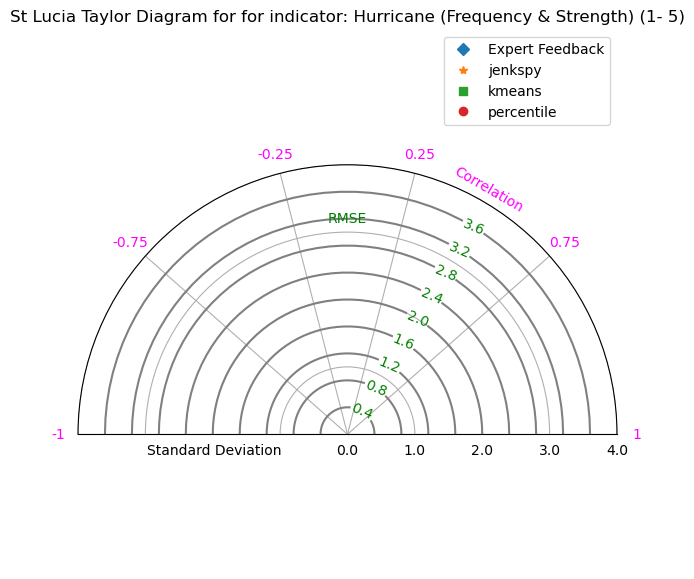

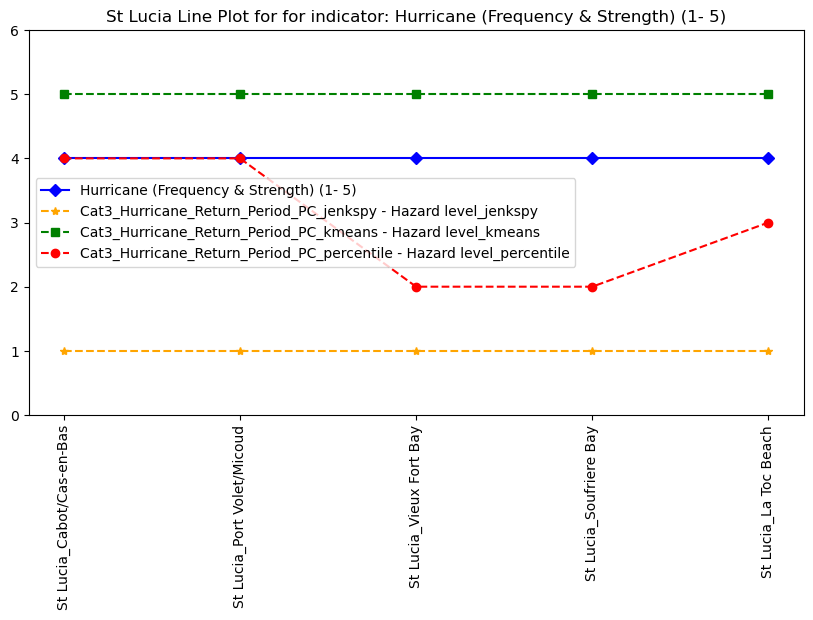

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


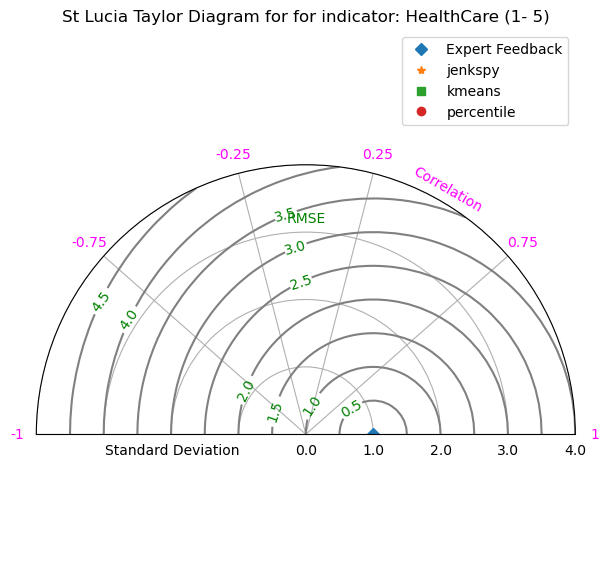

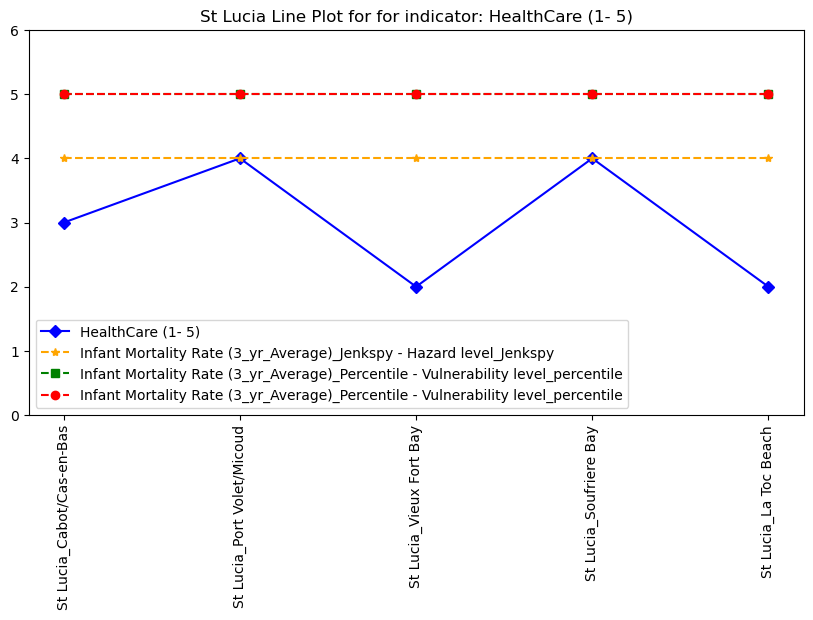

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


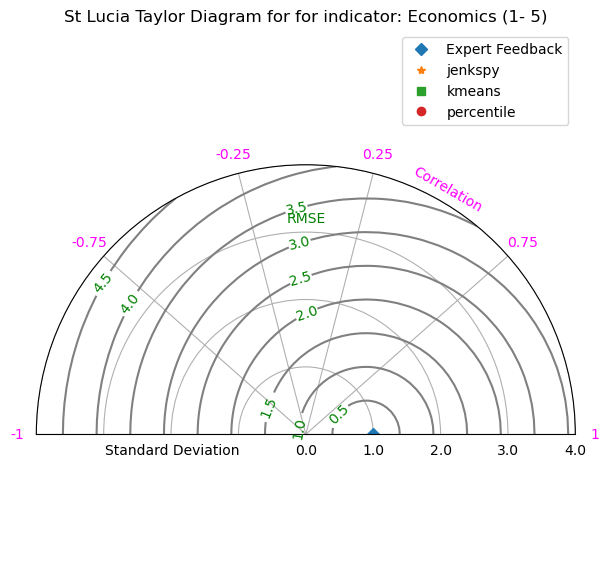

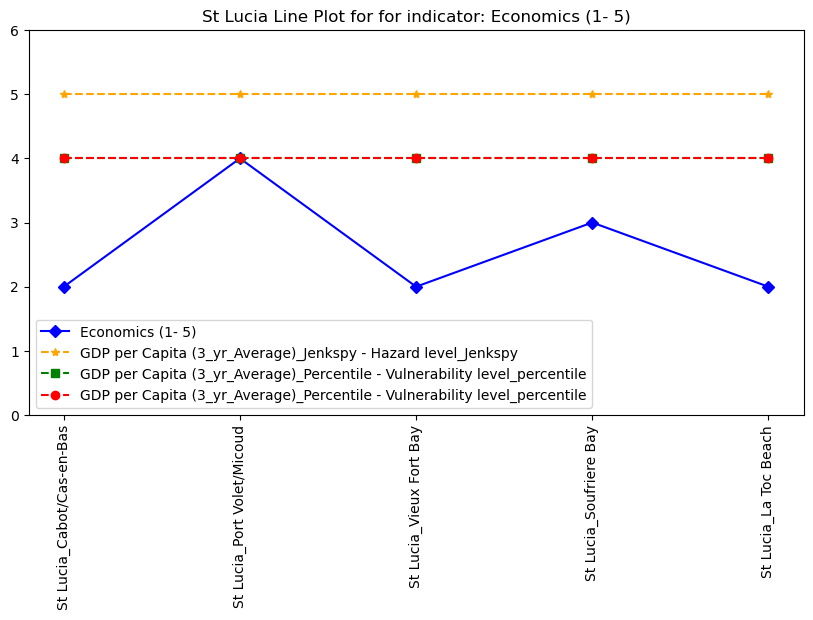

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


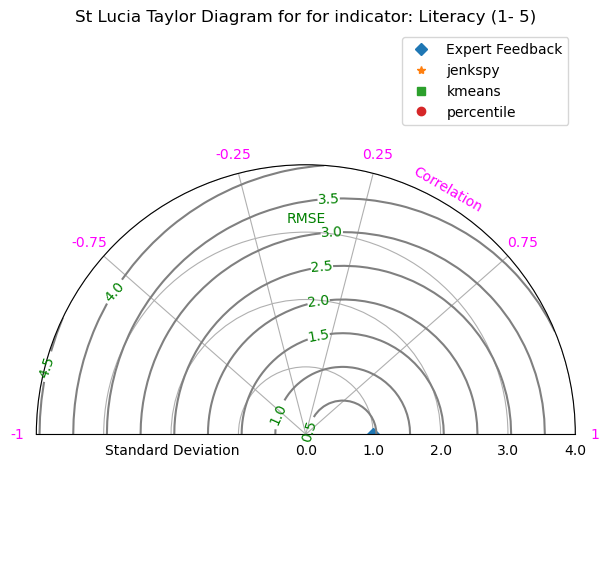

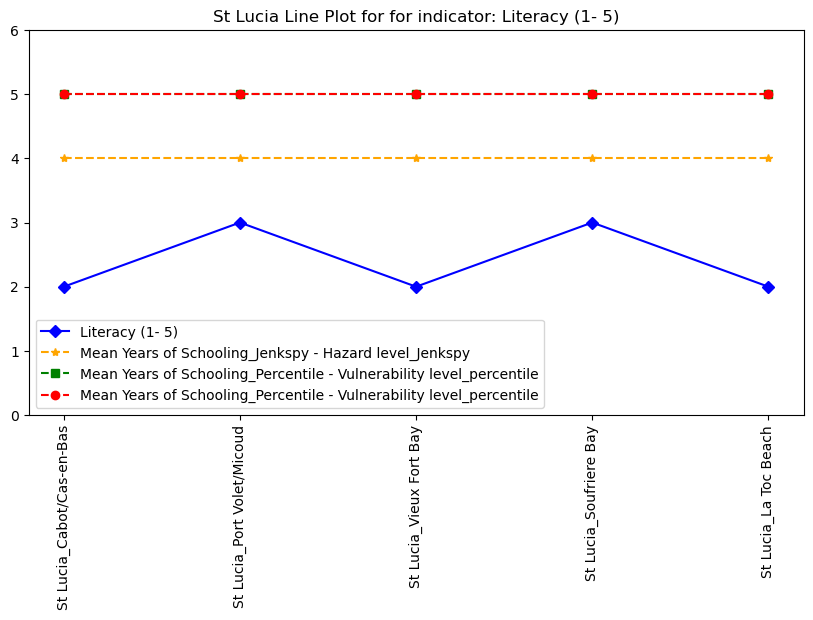

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


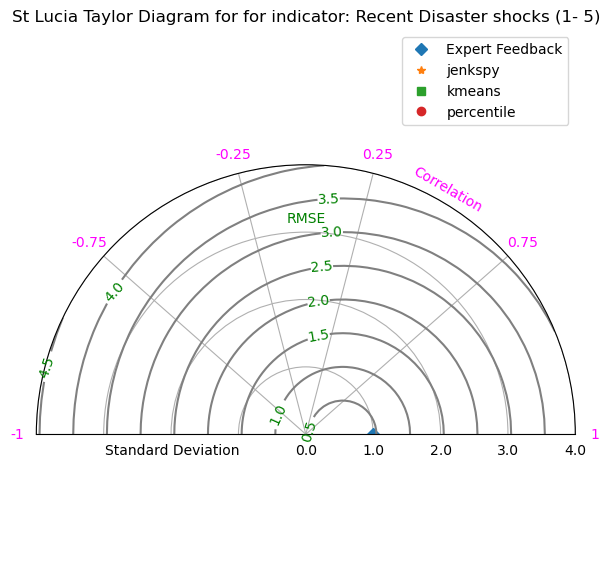

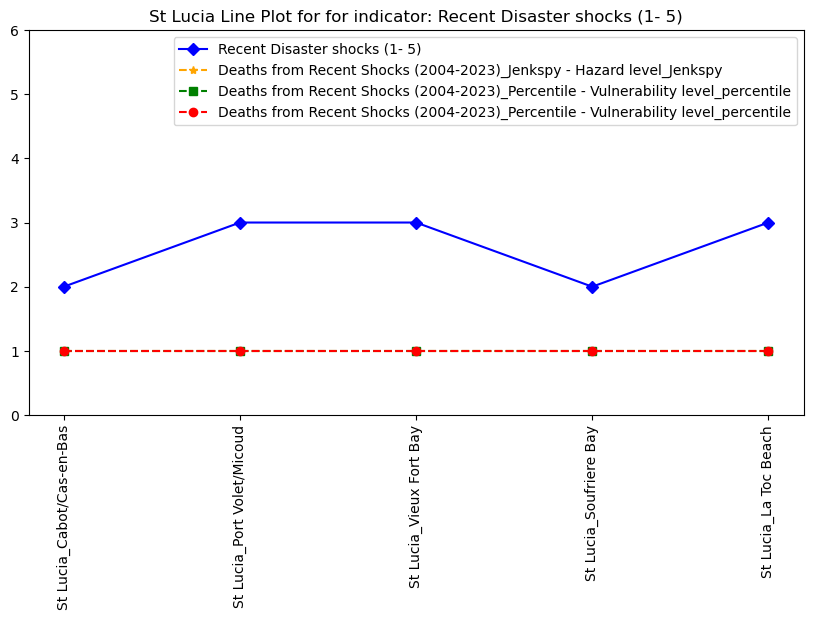

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


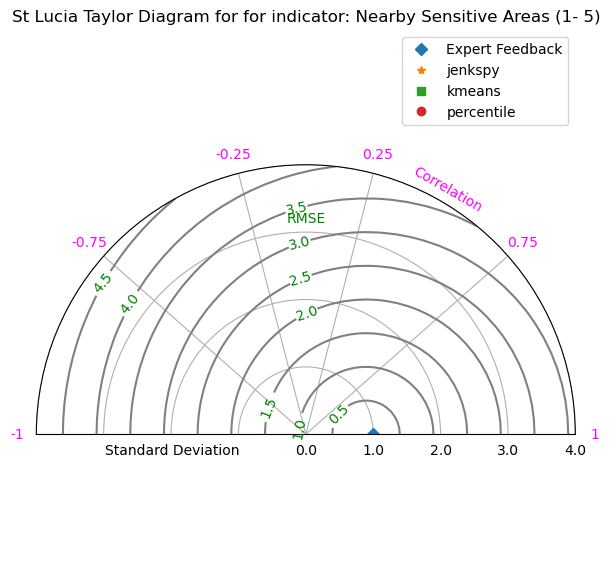

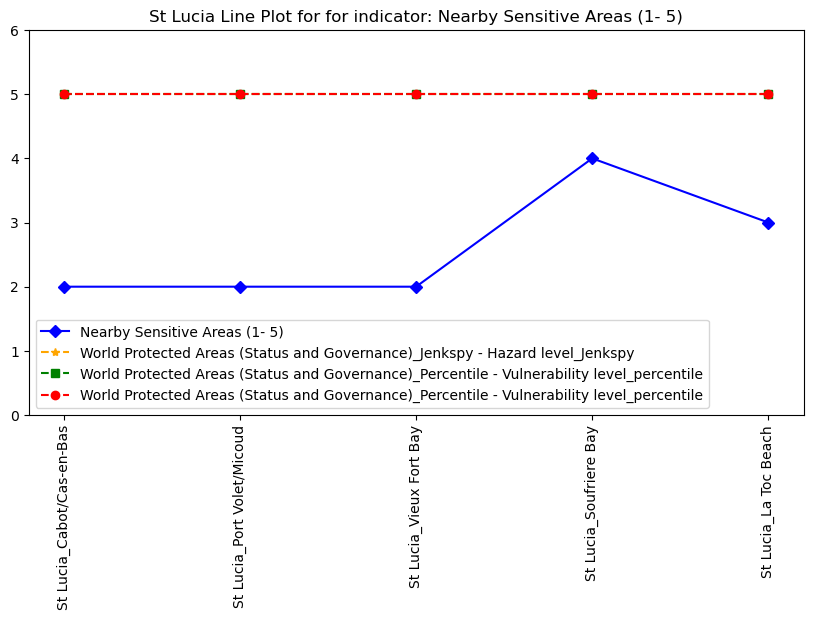

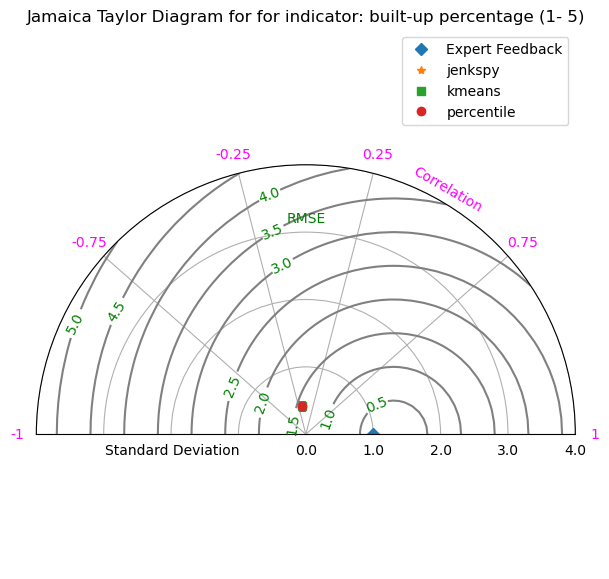

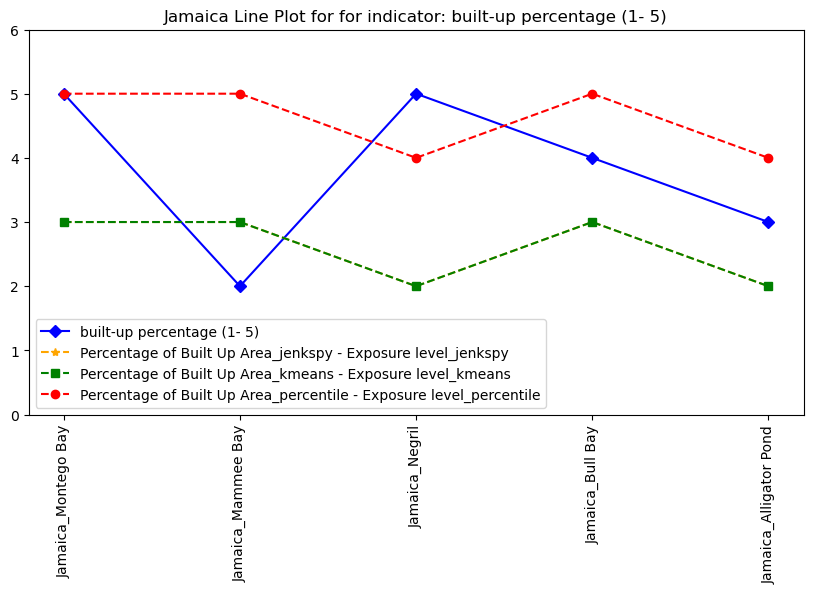

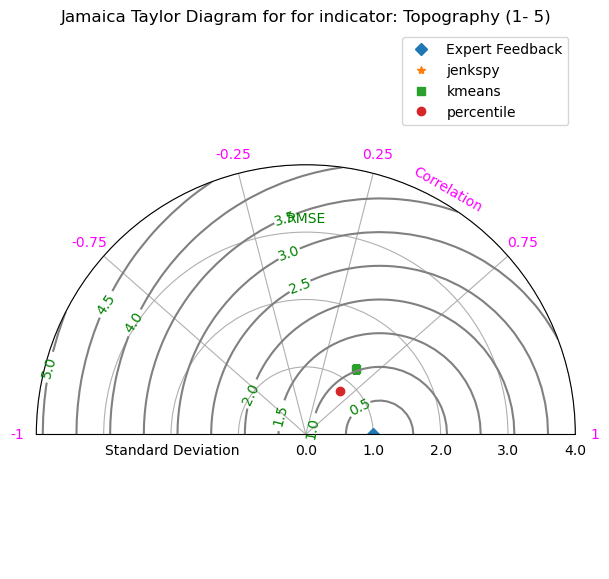

...

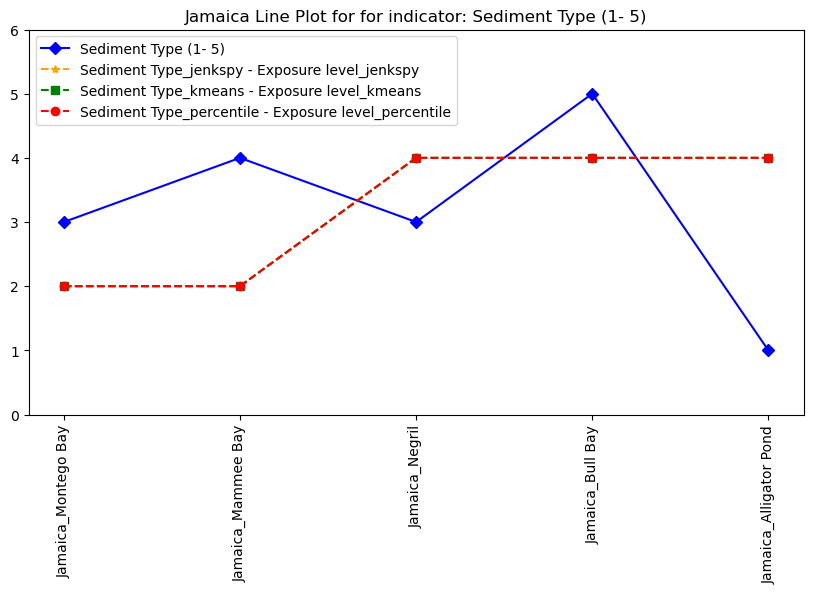

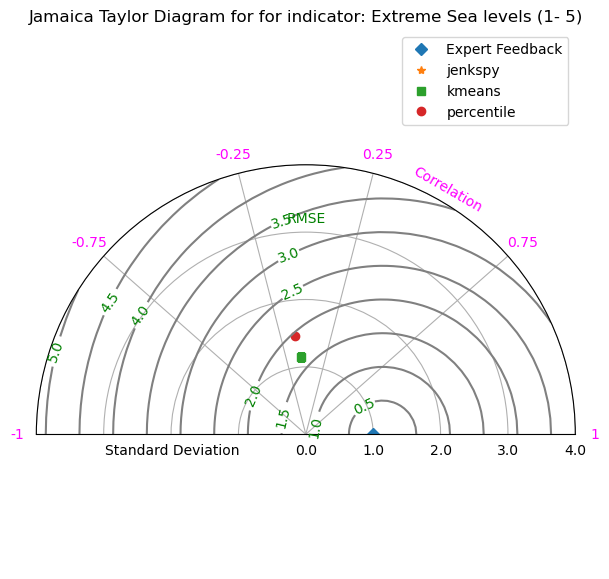

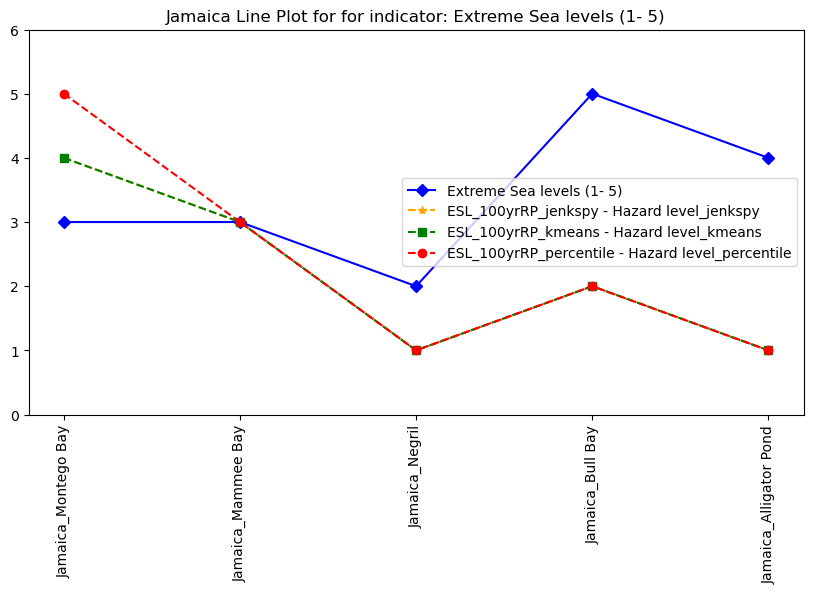

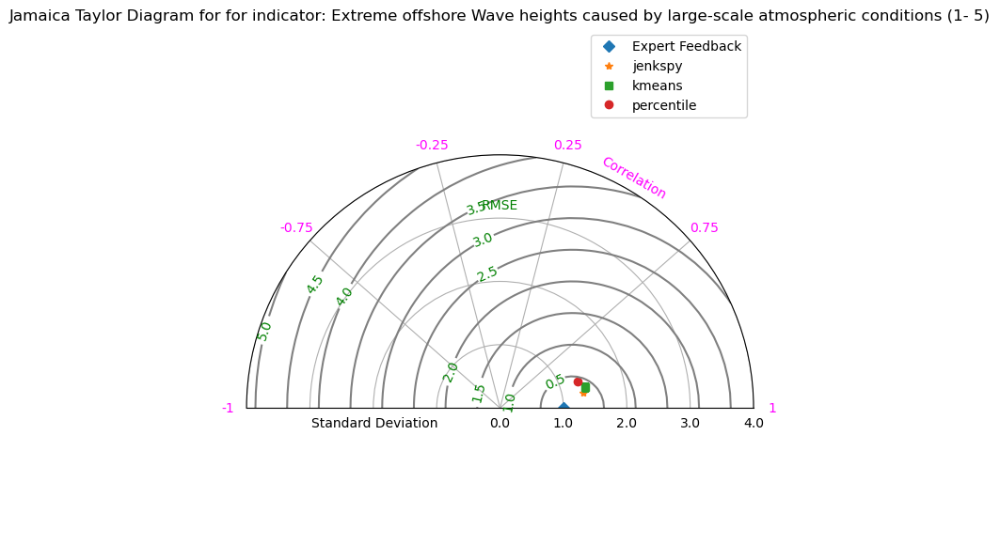

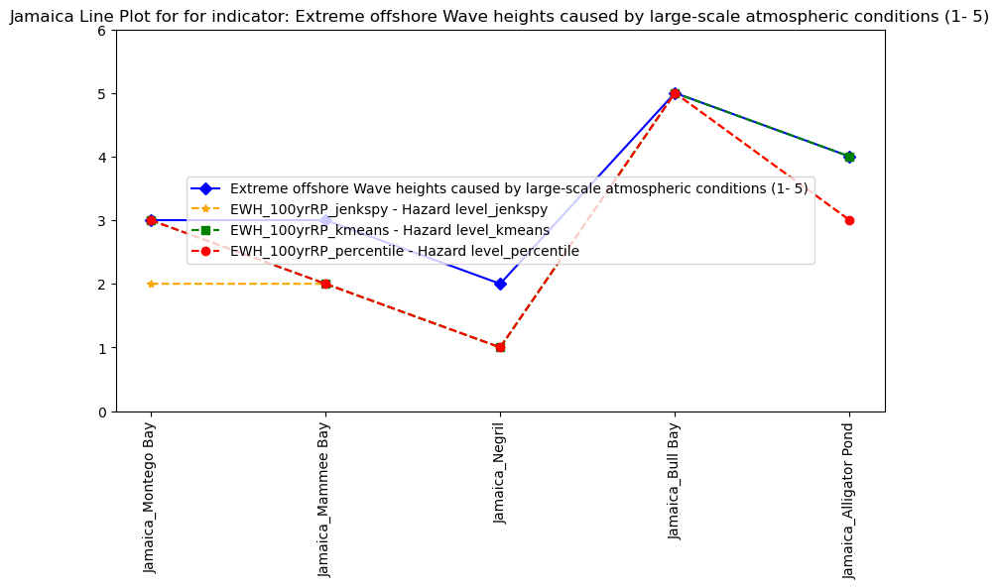

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: divide by zero encountered in scalar divide
  r = stddev / self.refstd


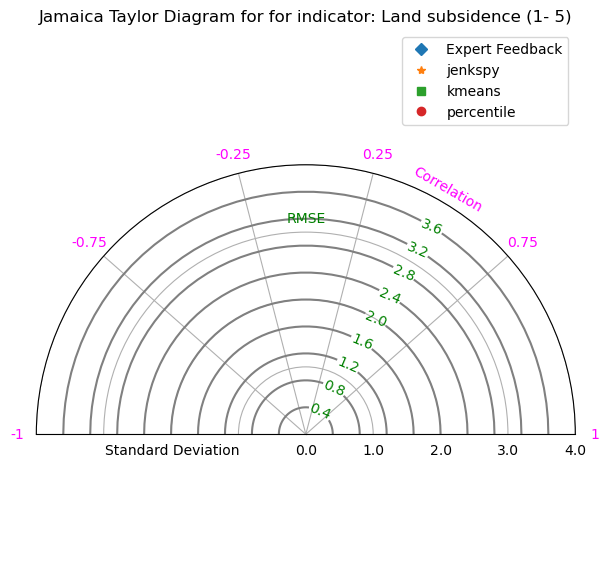

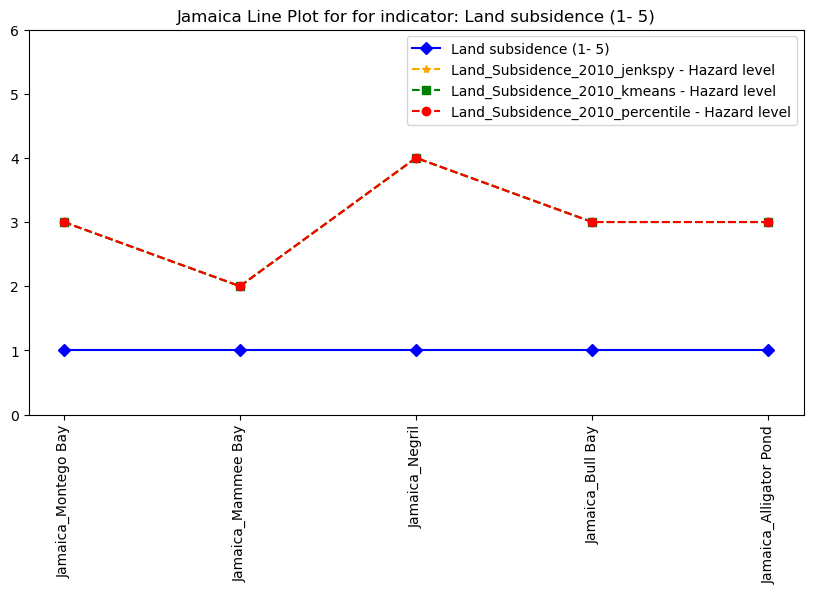

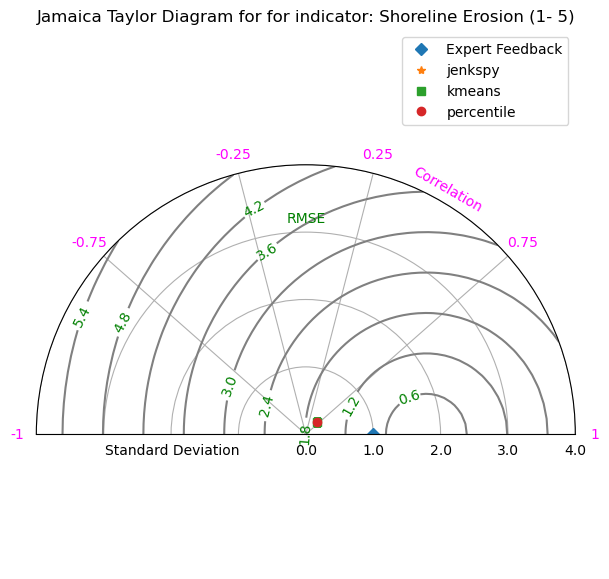

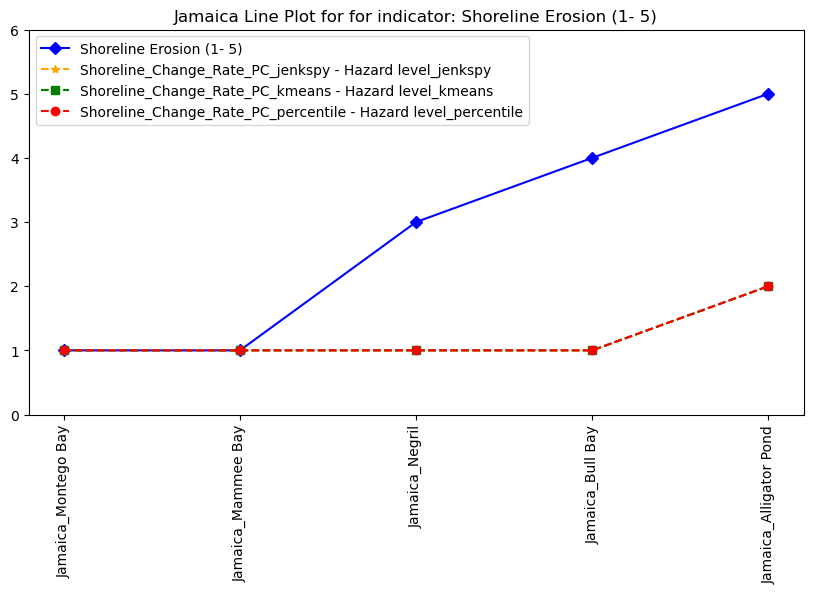

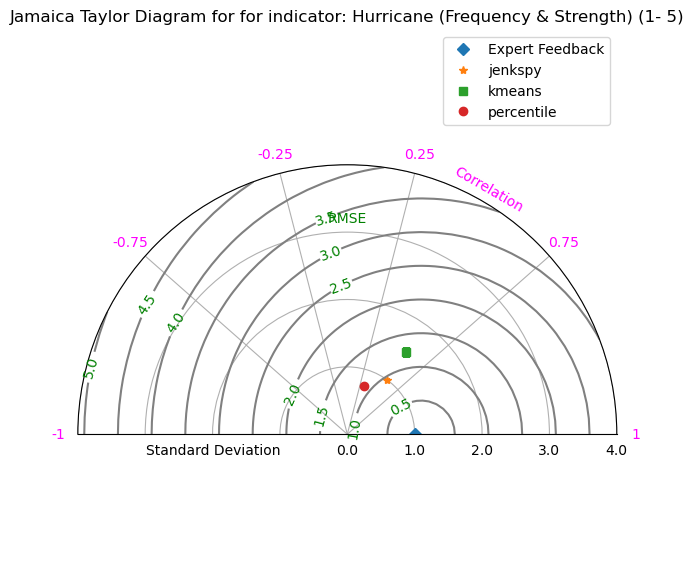

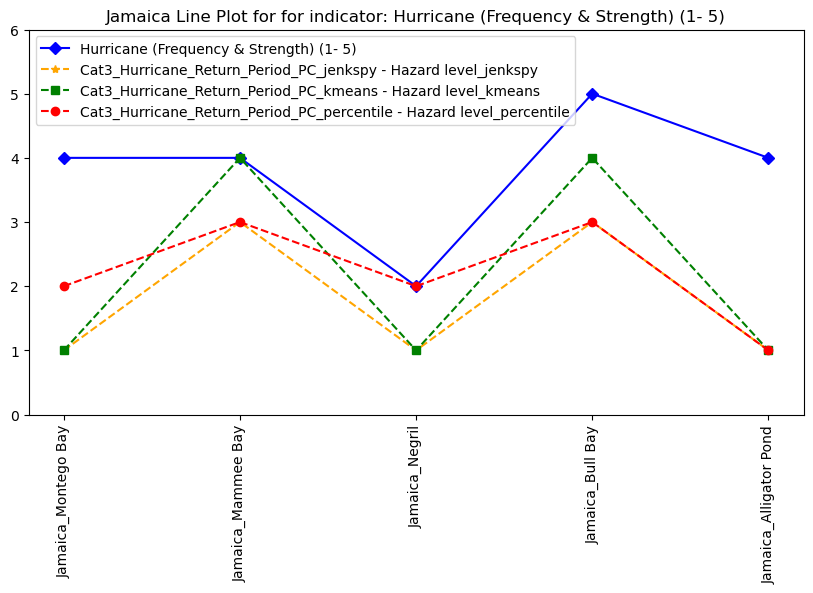

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd


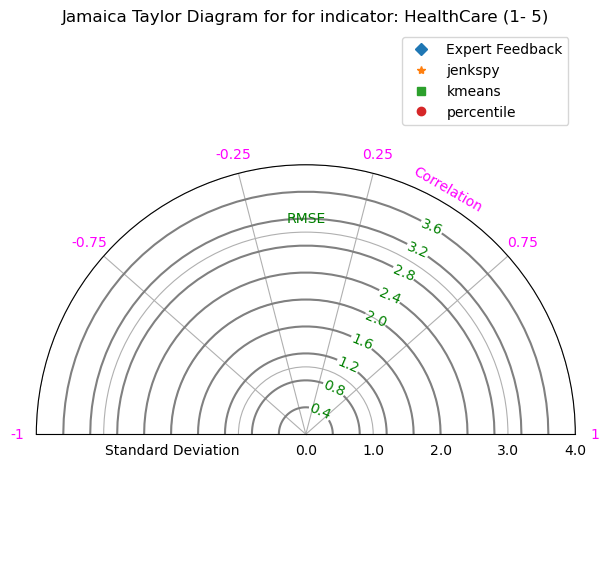

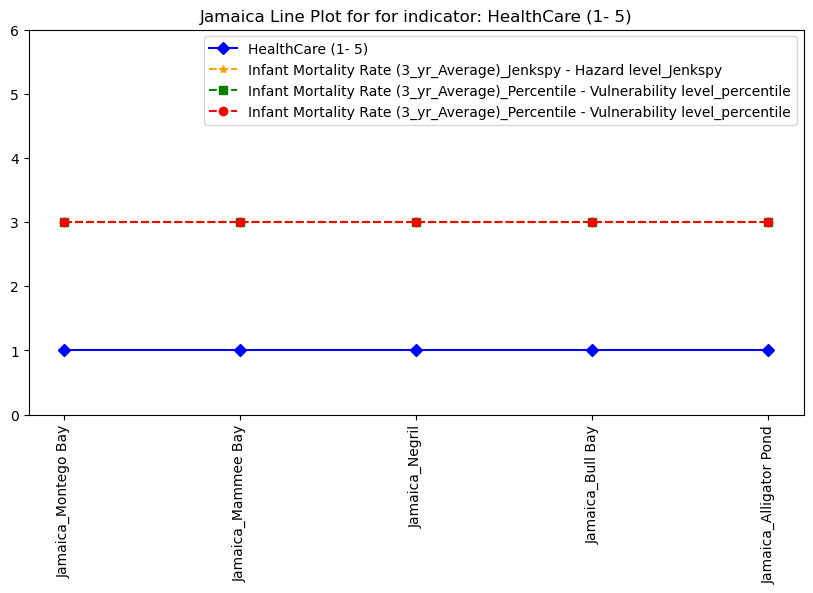

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd


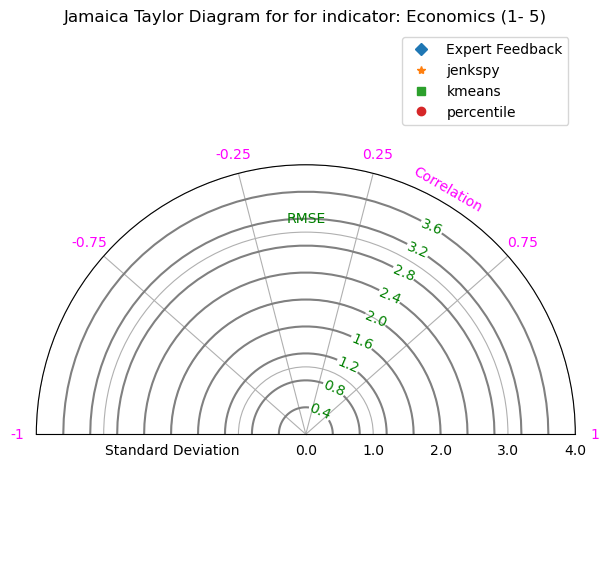

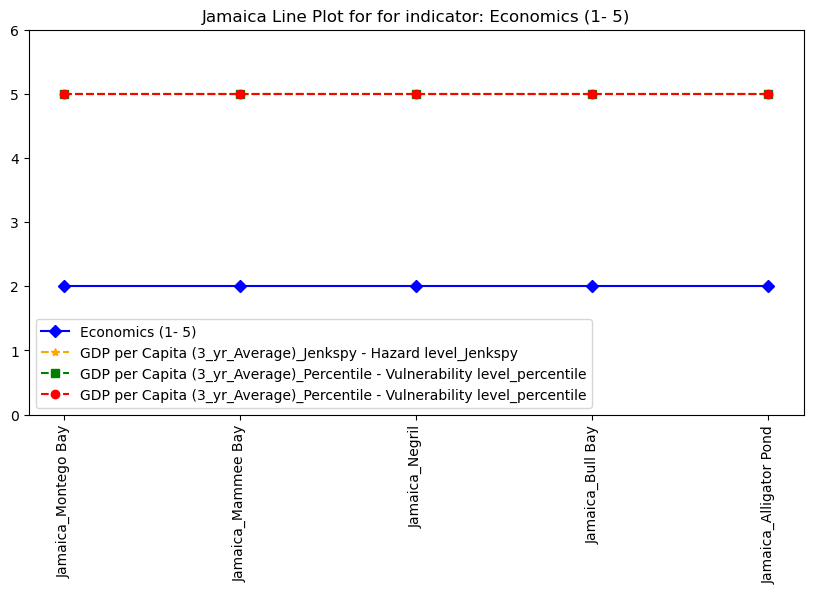

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: divide by zero encountered in scalar divide
  r = stddev / self.refstd


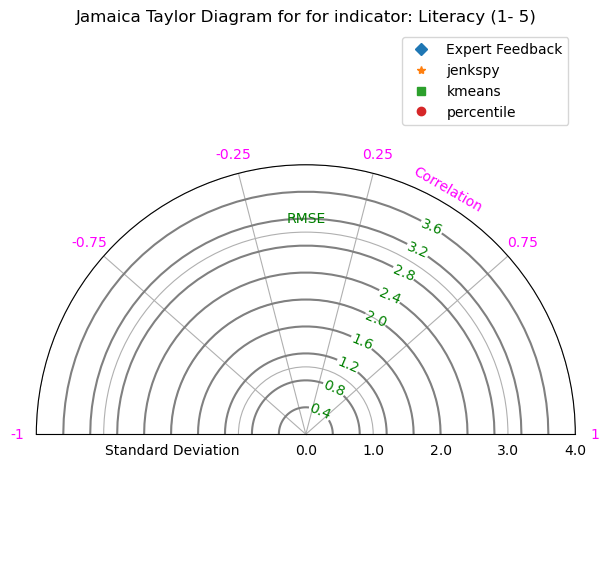

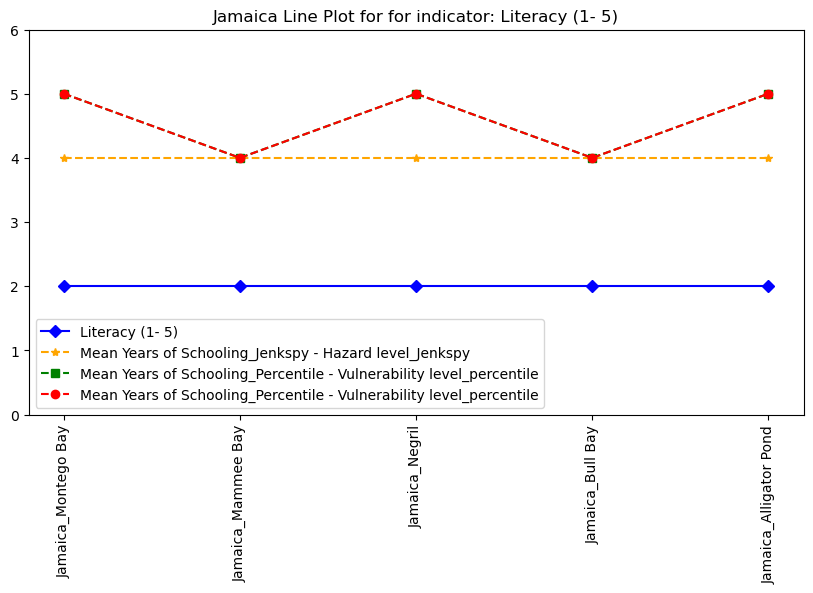

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\rowe\AppData\Local\Temp\ipykernel_16296\4149909722.py:34: RuntimeWarning: invalid value encountered in scalar divide
  r = stddev / self.refstd


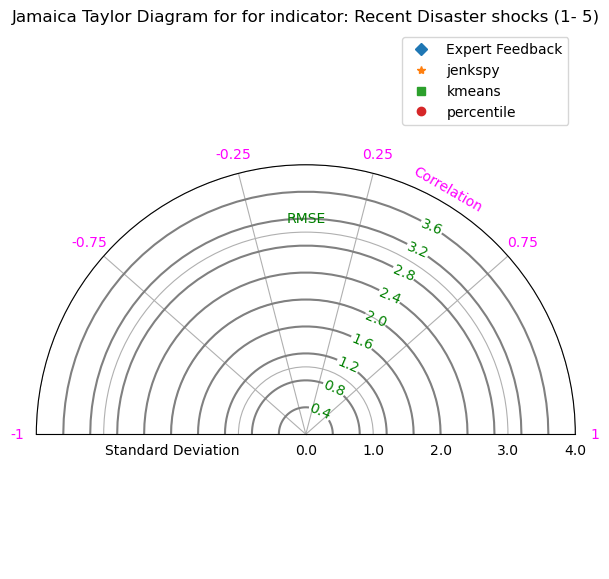

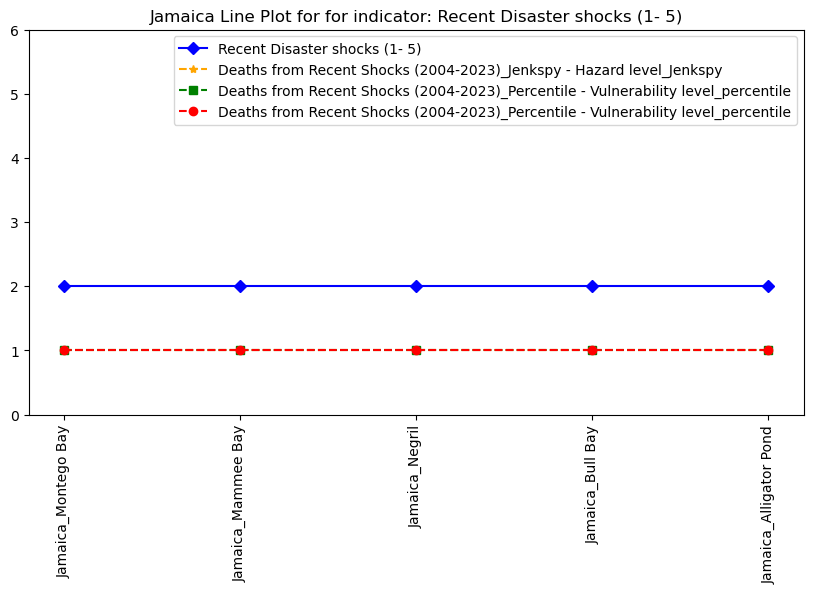

c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\rowe\AppData\Local\miniconda3\envs\coclico\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


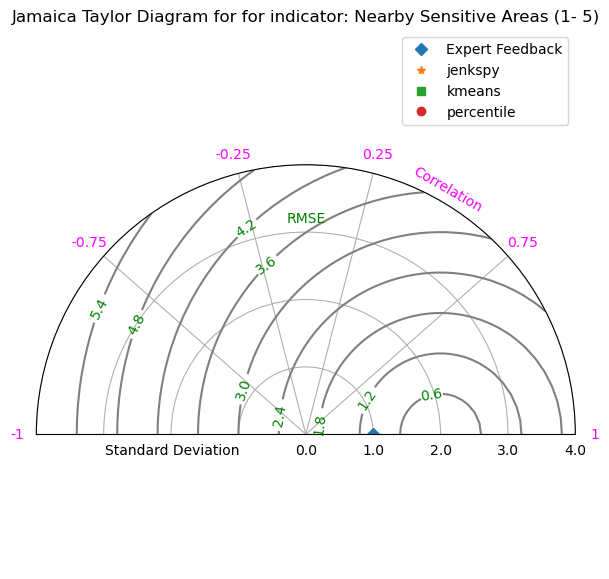

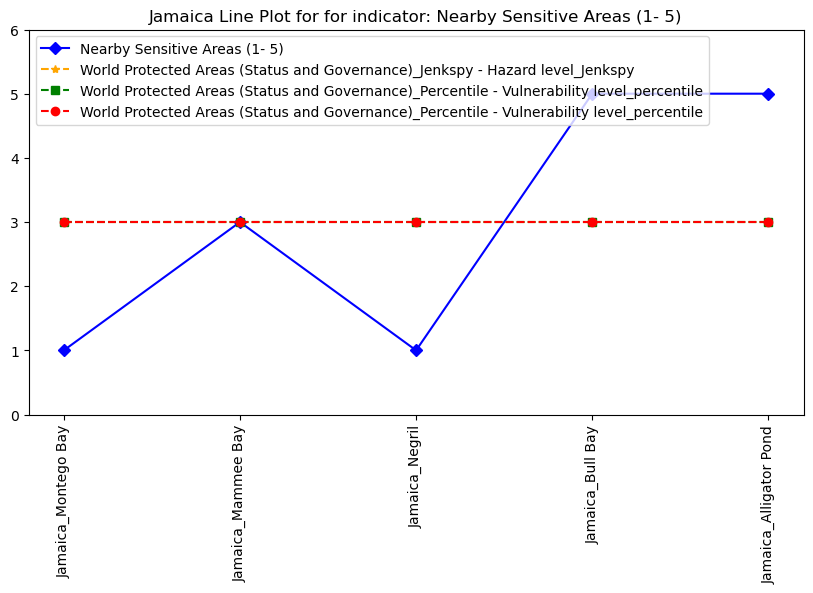

In [15]:


beg= [0,3,8,15,20,25,30]
end=[3,8,15,29,25,30,35]
countries= ["Bahamas","Barbados-1","Turks and Caicos-1","Barbados-2","Turks and Caicos-2","St Lucia","Jamaica"]
for idx,country in enumerate(countries):
    for col in range(0,15):

        # Data
        observed = groundtruth.iloc[:,col+4].values[beg[idx]:end[idx]]
        jenkspy = jenkspy_pd.iloc[:,col+5].values[beg[idx]:end[idx]]
        kmeans = kmeans_pd.iloc[:,col+5].values[beg[idx]:end[idx]]
        percentile = percentile_pd.iloc[:,col+5].values[beg[idx]:end[idx]]


        models = [observed,jenkspy, kmeans, percentile]
        model_names = ["Expert Feedback",'jenkspy', 'kmeans', 'percentile']

        # Standard deviation of the observed data
        std_observed = np.std(observed, ddof=1)

        # Calculate standard deviations and correlations for each model
        stddevs = [np.std(model, ddof=1) for model in models]
        correlations = [np.corrcoef(observed, model)[0, 1] for model in models]

        # Taylor Diagram
        fig = plt.figure(figsize=(10, 7))
        dia = TaylorDiagram(std_observed, fig=fig, rect=111, label='Observed')

        # Add models to Taylor diagram
        for i, (stddev, corr, name) in enumerate(zip(stddevs, correlations, model_names)):
            if i==0:
                dia.add_sample(stddev, corr, marker='D', ls='', label=name)
            elif i==1:
                dia.add_sample(stddev, corr, marker='*', ls='', label=name)
            elif i==2:
                dia.add_sample(stddev, corr, marker='s', ls='', label=name)
            elif i==3:
                dia.add_sample(stddev, corr, marker='o', ls='', label=name)

        # Add labels
        dia.ax.text(np.pi/2, 3.2, 'RMSE', ha='center', va='center',color="green")
        # dia.ax.text(np.pi/2, 1.7, 'Standard Deviation', ha='center', va='center')
        dia.ax.text(np.pi+np.pi/25, 2, 'Standard Deviation', ha='center', va='center')
        dia.ax.text(np.pi/3, 4.2, 'Correlation', ha='center', va='center',color="magenta",rotation=-30)

        # Add a legend[idx]
        contours = dia.add_contours(levels=10, colors='0.5')
        plt.clabel(contours, inline=2, fontsize=10,colors="green")

        plt.legend(loc='upper right')
        title_=f'Caribbean Taylor Diagram for for indicator: {groundtruth.columns[col+4]}'.replace("Caribbean",country)
        plt.title(title_)
        

        fig_name=title_+".png"
        directory=r"P:\11209197-018-global-coastal-atlas\MSc_students\ClenmarRowe\Data\Processed_data_CVI_components\Caribbean Thesis_Results\Validation\Taylor plots"
        directory=os.path.join(directory,country)
        if not os.path.exists(directory):
            os.makedirs(directory)

        plt.savefig(os.path.join(directory,fig_name.replace(":","")),dpi=300, bbox_inches='tight')

        plt.show()




        # plotline plots
        plt.figure(figsize=(10, 5))
        plt.plot((groundtruth.iloc[:,0].values[beg[idx]:end[idx]]+"_"+groundtruth.iloc[:,1].values[beg[idx]:end[idx]]),observed,"D-",color="blue")
        plt.plot(list(groundtruth.iloc[:,0].values[beg[idx]:end[idx]]+"_"+groundtruth.iloc[:,1].values[beg[idx]:end[idx]]),jenkspy,"*--",color="orange")
        plt.plot(list(groundtruth.iloc[:,0].values[beg[idx]:end[idx]]+"_"+groundtruth.iloc[:,1].values[beg[idx]:end[idx]]),kmeans,"s--",color="green")
        plt.plot(list(groundtruth.iloc[:,0].values[beg[idx]:end[idx]]+"_"+groundtruth.iloc[:,1].values[beg[idx]:end[idx]]),percentile, "o--",color="red")

        # plt.plot(groundtruth.index[beg[idx]:end[idx]],observed,"D-",color="blue")
        # plt.plot(groundtruth.index[beg[idx]:end[idx]],jenkspy,"*--",color="orange")
        # plt.plot(groundtruth.index[beg[idx]:end[idx]],kmeans,"s--",color="green")
        # plt.plot(groundtruth.index[beg[idx]:end[idx]],percentile, "o--",color="red")


        # plt.plot(groundtruth.iloc[:,1].values[beg[idx]:end[idx]],percentile, "o--",color="red")

        plt.legend([groundtruth.columns[col+4],jenkspy_pd.columns[col+5],kmeans_pd.columns[col+5],percentile_pd.columns[col+5]])
        plt.xticks(rotation=90)
        plt.ylim(0,6)
        plt.title(title_.replace("Taylor Diagram","Line Plot"))
        plt.savefig(os.path.join(directory,fig_name.replace(":","").replace("Taylor Diagram","Line Plot")),dpi=300, bbox_inches='tight')

        plt.show()


In [60]:
# Identify the correct geometry column (replace 'geometry_column_name' with the actual column name)
geometry_column_name = 'geometry'
circle_center_df=kmeans_pd
circle_center_df['x'] = circle_center_df[geometry_column_name].apply(lambda point_str: float(point_str.strip('POINT ()').split()[0]))
circle_center_df['y'] = circle_center_df[geometry_column_name].apply(lambda point_str: float(point_str.strip('POINT ()').split()[1]))

circle_center_df = circle_center_df.drop(columns=[geometry_column_name])

# Create the GeoDataFrame with the correct geometry column
circle_center = gpd.GeoDataFrame(circle_center_df, geometry=gpd.points_from_xy(circle_center_df.x, circle_center_df.y))



# Slice the DataFrame to exclude 'geometry', 'x', and 'y' columns
other_columns = circle_center.iloc[:, 0:-3]

# Concatenate the 'geometry' column with the other columns
circle_center2 = gpd.GeoDataFrame(geometry=circle_center.geometry, data=other_columns)


kmeans_pd=circle_center2


In [41]:
groundtruth.columns
kmeans_pd.columns

Index(['geometry', 'transect_id', 'country_id', 'continent', 'country_name',
       'Percentage of Built Up Area_kmeans - Exposure level_kmeans',
       'LECZ Area÷LECZ mean elevation_kmeans - Exposure level_kmeans',
       'Neashore Slope (tanβ or m^-1)_kmeans - Exposure level_kmeans',
       'Population Within 1km of the coastline_kmeans - Exposure level_kmeans',
       'Sediment Type_kmeans - Exposure level_kmeans',
       'ESL_100yrRP_kmeans - Hazard level_kmeans',
       'EWH_100yrRP_kmeans - Hazard level_kmeans',
       'Land_Subsidence_2010_kmeans - Hazard level',
       'Shoreline_Change_Rate_PC_kmeans - Hazard level_kmeans',
       'Cat3_Hurricane_Return_Period_PC_kmeans - Hazard level_kmeans',
       'Infant Mortality Rate (3_yr_Average)_Percentile - Vulnerability level_percentile',
       'GDP per Capita (3_yr_Average)_Percentile - Vulnerability level_percentile',
       'Mean Years of Schooling_Percentile - Vulnerability level_percentile',
       'Deaths from Recent Shocks 

In [46]:
groundtruth=pd.read_csv(r"P:\11209197-018-global-coastal-atlas\MSc_students\ClenmarRowe\Data\Processed_data_CVI_components\Caribbean Thesis_Results\Validation\Expert_Feedback_collated.csv",sep=";")
groundtruth=groundtruth.iloc[:,:-5]
groundtruth["lon"]=groundtruth["lon"].apply(lambda x: float(str(x).replace(',', '.')))
groundtruth["lat"]=groundtruth["lat"].apply(lambda x: float(str(x).replace(',', '.')))
groundtruth

for col in groundtruth.iloc[:,4:].columns:
    groundtruth[col]=groundtruth[col].apply(lambda x: float(x))
groundtruth

,Country,Beach Name,lon,lat,built-up percentage (1- 5),Topography (1- 5),Bathymetry Slope (1- 5),Population (1- 5),Sediment Type (1- 5),Extreme Sea levels (1- 5),Extreme offshore Wave heights caused by large-scale atmospheric conditions (1- 5),Land subsidence (1- 5),Shoreline Erosion (1- 5),Hurricane (Frequency & Strength) (1- 5),HealthCare (1- 5),Economics (1- 5),Literacy (1- 5),Recent Disaster shocks (1- 5),Nearby Sensitive Areas (1- 5)
0,Bahamas,Lowe Sound,-78.08,25.15,4.0,5.0,4.0,3.0,4.0,5.0,4.0,3.0,4.0,2.0,3.0,3.0,3.0,3.0,2.0
1,Bahamas,Regatta,-77.55,24.10,3.0,3.0,4.0,3.0,4.0,3.0,3.0,3.0,4.0,2.0,3.0,3.0,3.0,3.0,2.0
2,Turks and Caicos Islands,North Grace Bay,-72.17,21.81,4.0,4.0,4.0,4.0,4.0,4.0,4.0,3.0,5.0,3.0,3.0,2.0,3.0,4.0,3.0
3,Barbados,Paynes Bay,-59.64,13.17,5.0,5.0,4.0,5.0,4.0,5.0,5.0,1.0,5.0,3.0,3.0,4.0,3.0,2.0,1.0
4,Barbados,Hangmans Bay,-59.65,13.28,4.0,5.0,4.0,4.0,4.0,5.0,5.0,2.0,4.0,3.0,3.0,3.0,3.0,1.0,1.0
5,Barbados,Kitridge Bay,-59.42,13.15,2.0,3.0,4.0,2.0,4.0,5.0,5.0,2.0,4.0,5.0,3.0,2.0,3.0,2.0,1.0
6,Barbados,Foul Bay,-59.45,13.09,4.0,5.0,4.0,3.0,4.0,5.0,5.0,2.0,2.0,5.0,3.0,2.0,3.0,2.0,1.0
7,Barbados,Carlisle Bay,-59.61,13.09,5.0,5.0,4.0,5.0,4.0,4.0,4.0,1.0,2.0,3.0,3.0,4.0,3.0,2.0,1.0
8,Turks and Caicos,Grace Bay,-72.26,21.79,3.0,2.0,2.0,2.0,3.0,2.0,2.0,3.0,2.0,3.0,2.0,2.0,2.0,3.0,2.0
9,Turks and Caicos,Long Bay,-72.16,21.78,3.0,2.0,1.0,2.0,3.0,3.0,3.0,3.0,2.0,3.0,2.0,2.0,2.0,3.0,2.0


In [63]:
import plotly.express as px



lat = 18.1
lon = -77.3
view_width = 10

# # Plot using Plotly Express
fig = px.scatter_mapbox(kmeans_pd,
                        lat=kmeans_pd["geometry"].y,
                        lon=kmeans_pd["geometry"].x,
                        color="Percentage of Built Up Area_kmeans - Exposure level_kmeans",
                        hover_data="Percentage of Built Up Area_kmeans - Exposure level_kmeans",
                        mapbox_style="carto-positron",width=2000,
                        height=1200)

# Plot using Plotly Express
fig = px.scatter_mapbox(groundtruth,
                        lat=groundtruth["lat"],
                        lon=groundtruth["lon"],
                        color="built-up percentage (1- 5)",
                        hover_data="built-up percentage (1- 5)",
                        mapbox_style="carto-positron",width=2000,
                        height=1200)

# Update map layout to adjust center and zoom
fig.update_layout(mapbox=dict(center=dict(lat=groundtruth["lat"].mean(), lon=groundtruth["lon"].mean()), zoom=9),title=f"{groundtruth.columns[-1]} Distribution along Caribbean's shoreline")



fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_layers=[
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "ESRI World Imagery",
        #     "source": [
        #         "https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}"
        #     ]
        # },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "Google Maps",
            "source": [
                "http://mt0.google.com/vt/lyrs=s&hl=en&x={x}&y={y}&z={z}"
            ]
        },
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "United States Geological Survey",
        #     "source": [
        #         "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"
        #     ]
        # },
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "Bing Maps Satellite Imagery",
        #     "source": [
        #         "https://t0.tiles.virtualearth.net/tiles/a{q}.jpeg?g=685&mkt=en-us&n=z"
        #     ]
        # },
      

      ]
      )

fig.show()



In [14]:
std_observed,stddevs

(1.2549063375273815, [1.75470555838826, 1.75470555838826, 1.75470555838826])